##### Preliminaries

In [1]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from tqdm import tqdm

# Set up
np.random.seed(0)

# Set up plot axes
plt.rc('axes', axisbelow=True)

# Load toolboxes
from newToolbox_ESN import ESN, stateMatrixGenerator
from newToolbox_ESN_Multi import ESNMultiFrequency
from newToolbox_MIDAS import MIDAS
from ModelConfidenceSet import ModelConfidenceSet

# Load statmodels
from statsmodels.tsa.ar_model import AutoReg
# from statsmodels.tsa.statespace.sarimax import SARIMAX

# Paths
#path_prefix = "Reservoir-Computing-for-Macroeconomic-Modelling"
path_prefix = ""
path_folder = Path(os.path.dirname(os.path.abspath(os.getcwd())))

# Path for DFM forecasts files
dfm_path = os.path.join(path_folder, path_prefix, "dfm_small")

In [2]:
# Plotting options
savePlots = True
plots_folder = os.path.join(path_folder, 'figures', 'nb_macro_small')

In [3]:
# Export results
saveR = True

Helper functions:

In [4]:
def interp1d2(y0, y1, n):
    x = np.linspace(0, 1, n+2)
    y = y0*(1-x) + y1*x
    return y[1:-1]

def daily_begginingInterp(data, start=None, end=None, length=None, endOfMonth=True):
    if isinstance(data, pd.DataFrame):
        data = data.squeeze()
    
    start_ = data.index[0] if (start is None) else start
    end_   = data.index[-1] if (end is None) else end

    assert ~(length is None) and (length > 0), "Choose a valid interpolation length"

    #start_ -= pd.offsets.MonthBegin(1)
    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    #if endOfMonth:
    #    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    #else:
    #    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    
    data_interp = np.full(length * len(freqrange), np.nan)
    #id_i = np.full(length * len(freqrange), np.nan)
    dates_interp = None

    # Initial case
    data_i0 = data.loc[:freqrange[1]]
    L = len(data_i0)
    data_interp[(length-L+2):length] = data_i0.iloc[1:-1]
    data_interp[0:(length-L+2)] = data_i0.iloc[0]
    data_f_last = data_i0[-2]
    if endOfMonth:
        dates_interp = pd.date_range(
            freqrange[1]-pd.DateOffset(days=length), freqrange[1]-pd.DateOffset(days=1)
        )
    else:
        dates_interp = pd.date_range(
            freqrange[0], freqrange[0]+pd.DateOffset(days=length-1)
        )

    # Full cases
    p = length
    for j in range(2, len(freqrange)):
        data_ij = data.loc[freqrange[j-1]:freqrange[j]]
        L = len(data_ij)

        data_interp[(p+length-L+2):(p+length)] = data_ij.iloc[1:-1]
        data_interp[p:(p+length-L+2)] = interp1d2(
            data_f_last, data_ij[0], length-L+2
        )
        if endOfMonth:
            dates_interp = dates_interp.append(pd.date_range(
                freqrange[j]-pd.DateOffset(days=length), freqrange[j]-pd.DateOffset(days=1)
            ))
        else:
            dates_interp = dates_interp.append(pd.date_range(
                freqrange[j-1], freqrange[j-1]+pd.DateOffset(days=length-1)
            ))

        #print(data_ij)
        #print(data_ij[0])

        #id_i[p:(p+length)] = j
        data_f_last = data_ij[-2]
        p += length

    # Last case
    data_ie = data.loc[freqrange[-1]:(freqrange[-1]+pd.tseries.offsets.MonthBegin())]
    L = len(data_ie)
    data_interp[(p+length-L+1):] = data_ie.iloc[1:]
    data_interp[p:(p+length-L+1)] = interp1d2(
        data_f_last, data_ie[0], length-L+1
    )
    if endOfMonth:
        dates_interp = dates_interp.append(pd.date_range(
            freqrange[-1]+pd.tseries.offsets.MonthEnd()-pd.DateOffset(days=length-1), 
            freqrange[-1]+pd.tseries.offsets.MonthEnd()
        ))
    else:
        dates_interp = dates_interp.append(pd.date_range(
            freqrange[-1], freqrange[-1]+pd.DateOffset(days=length-1)
        ))
    
    #data_interp[0:(length-L)] = interp1d2(d_data_pre[0], d_data_pre[1], 24-L)

    data_interp = pd.DataFrame(data=data_interp, index=dates_interp)

    return data_interp

# Plot for visual check-up
#data_i = begginingInterp(d_data, freq='MS', length=24)
#plt.figure(figsize=(10,4))
#for j in range(10):
#    plt.plot(np.arange(j*24, (j+1)*24), data_i[(j*24):((j+1)*24)])

In [5]:
def daily_aggregateByIndex(data, window_size=1, endOfWindow=True, debug=False):
    assert ~(window_size is None) and (window_size > 0), "Choose a valid daily aggregation length"

    data_dates = data.index
    # Get beginning and ends of months over data index
    start_ = data_dates[0] 
    end_   = data_dates[-1]
    month_ends = pd.date_range(start=start_, end=end_, freq='M')
    
    start_j = start_
    exceptions = []

    aggregated_data = pd.DataFrame(data=[], columns=data.columns)
    for end_j in month_ends:
        data_j = data.loc[start_j:end_j]
        j_n = 0
        while j_n < len(data_j):
            slice_j_n = data_j.iloc[j_n:(j_n + window_size)]
            if len(slice_j_n) < window_size:
                exceptions.append(slice_j_n.index.to_period("D"))
            if endOfWindow:
                mean_j_n_index = slice_j_n.index[-1]
            else:
                mean_j_n_index = slice_j_n.index[0]
            aggregated_data.loc[mean_j_n_index] = slice_j_n.mean()
            j_n += window_size

        start_j = end_j + pd.DateOffset(days=1)

    if len(exceptions) > 0:
        print("daily_aggregateByIndex()")
        print(("! Found exceptions in aggregation (some aggregation windows " +
                f"have different length than {window_size})"))
        if debug:
            print("+ Exceptions found:")
            for ex in exceptions: print(ex)

    return aggregated_data

In [6]:
def normalize_train_test(train, test, return_mu_sig=False):
    m_train = train.mean()
    s_train = (train - train.mean()).std()
    if return_mu_sig:
        return (train - m_train)/s_train, (test - m_train)/s_train, m_train, s_train
    else:
        return (train - m_train)/s_train, (test - m_train)/s_train

#### Data

In [7]:
# Sample dates
startSampleDate = pd.to_datetime('1990-01-01')
endSampleDate   = pd.to_datetime('2019-12-31')

data_path = os.path.join(path_folder, path_prefix, "DATE PRE-PROCESING")

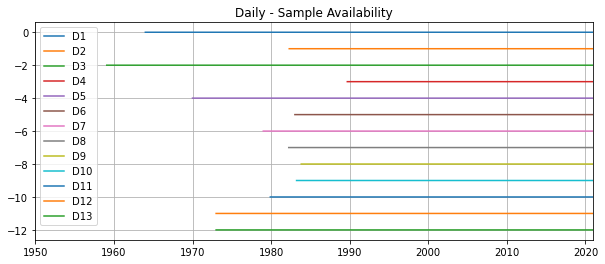

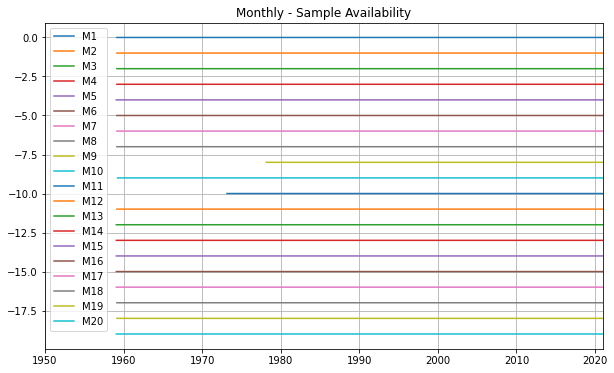

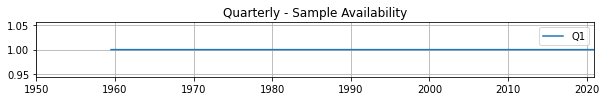

In [8]:
# Check data availability
preproc_data_filled = pd.read_csv(
    os.path.join(data_path, 'fullsample_output_filled_data.csv'),
    parse_dates = ["Date"]
).set_index("Date")

preproc_data_filled[~pd.isna(preproc_data_filled)] = 1

# Daily
plt.figure(figsize=(10,4))
for j, c in enumerate(list(map(lambda j : f"D{j}", range(1, 14)))):
    plt.plot(preproc_data_filled[[c]] * -j, label=c)
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Daily - Sample Availability")
plt.legend()
plt.show()

# Monthly
plt.figure(figsize=(10,6))
for j, c in enumerate(list(map(lambda j : f"M{j}", range(1, 21)))):
    plt.plot(preproc_data_filled[[c]] * -j, label=c)
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Monthly - Sample Availability")
plt.legend()
plt.show()

# Quartely
plt.figure(figsize=(10,1))
plt.plot(preproc_data_filled["Q1"], label="Q1")
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Quarterly - Sample Availability")
plt.legend()
plt.show()

In [9]:
preproc_data = pd.read_csv(
    os.path.join(data_path, 'fullsample_output_data.csv'), 
    parse_dates = ["Date"]
).set_index("Date")
data = preproc_data.loc[startSampleDate:endSampleDate]

In [10]:
# Non-filled data
d_data = data[['D3']].dropna()
m_data = data[['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']].dropna()
GDP_data = data[['Q1']].dropna()

# Interpolate non-filled daily data
d_data_interp = daily_begginingInterp(d_data, length=24, endOfMonth=False)
d_data_interp.columns = d_data.columns

In [11]:
# Filled data
m_data_prefill = preproc_data[['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']].loc[
    (startSampleDate - pd.offsets.MonthBegin()):endSampleDate
].dropna()
GDP_data_prefill = preproc_data[['Q1']].loc[
    (startSampleDate - pd.offsets.QuarterBegin()):endSampleDate
].dropna()

# Interpolate non-filled daily data to month end
d_data_fill_interp = daily_begginingInterp(d_data, length=24, endOfMonth=True)
d_data_fill_interp.columns = d_data.columns

# Aggregate interpolated daily to mean over 6 days windows
d_data_fill_interp_agg = daily_aggregateByIndex(d_data_fill_interp, window_size=6, endOfWindow=True)

# Shift monthly, quarterly data to solar end-of-month date
m_data_prefill.index = m_data_prefill.index + pd.offsets.MonthEnd(0)
GDP_data_prefill.index = GDP_data_prefill.index + pd.offsets.QuarterEnd(0)

# Re-align filled data to daily indexes, join dataframe
pre_index = pd.date_range(
    start=startSampleDate - pd.offsets.YearBegin(), end=endSampleDate, freq='D'
)
pre_data_interp = pd.DataFrame(
    data=np.full((len(pre_index), 1), np.nan), index=pre_index
)

m_data_interp = pre_data_interp.join(m_data_prefill).ffill()
#GDP_data_interp = pre_data_interp.join(GDP_data_prefill).ffill()

# Make a new dataframe for filled explanatory variables
md_fill_data = d_data_fill_interp.join(m_data_interp.iloc[:,1:])#.join(GDP_data_interp.iloc[:,1:])

md_fill_agg_data = d_data_fill_interp_agg.join(m_data_interp.iloc[:,1:])

# Shift target data
GDP_fill_data  = GDP_data
GDP_fill_data.index = GDP_fill_data.index + pd.offsets.QuarterEnd(0)

Function to build datasets:

In [12]:
def getMidasDatasets(trainTestSplitDate, startDate=None, endDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_data_train = GDP_data.loc[startDate:trainTestSplitDate]
    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    m_data_train = m_data.loc[startDate:trainTestSplitDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endDate]

    d_data_train = d_data_interp.loc[startDate:trainTestSplitDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    return GDP_data_midas, md_data_midas, (GDP_mu_train, GDP_sig_train)

In [13]:
def getEsnSingleDatasets(trainTestSplitDate, startDate=None, endDate=None, aggregate=False):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_fill_data_train = GDP_fill_data.loc[startDate:trainTestSplitDate]
    GDP_fill_data_test = GDP_fill_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)

    if aggregate:
        md_fill_agg_data_train = md_fill_agg_data.loc[startDate:trainTestSplitDate]
        md_fill_agg_data_test = md_fill_agg_data.loc[(trainTestSplitDate):endDate]

        md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

        return GDP_fill_data_train, GDP_fill_data_test, md_fill_agg_data_train, md_fill_agg_data_test
    else:
        md_fill_data_train = md_fill_data.loc[startDate:trainTestSplitDate]
        md_fill_data_test = md_fill_data.loc[(trainTestSplitDate):endDate]

        md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

        return GDP_fill_data_train, GDP_fill_data_test, md_fill_data_train, md_fill_data_test

In [14]:
def getEsnMultiDatasets(trainTestSplitDate, startDate=None, endDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_data_train = GDP_data.loc[startDate:trainTestSplitDate]
    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    m_data_train = m_data.loc[startDate:trainTestSplitDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endDate]

    d_data_train = d_data_interp.loc[startDate:trainTestSplitDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    return GDP_data_train, GDP_data_test, m_data_train, m_data_test, d_data_train, d_data_test

In [15]:
def getSmallDatasets(trainTestSplitDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)

    # Split training and testing sample
    GDP_data_train = GDP_data.loc[startSampleDate:trainTestSplitDate]
    m_data_train = m_data.loc[startSampleDate:trainTestSplitDate]
    d_data_train = d_data_interp.loc[startSampleDate:trainTestSplitDate]
    GDP_fill_data_train  = GDP_fill_data.loc[startSampleDate:trainTestSplitDate]
    md_fill_data_train = md_fill_data.loc[startSampleDate:trainTestSplitDate]
    md_fill_agg_data_train = md_fill_agg_data.loc[startSampleDate:trainTestSplitDate]

    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endSampleDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endSampleDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endSampleDate]
    GDP_fill_data_test  = GDP_fill_data.loc[(trainTestSplitDate + pd.offsets.Day()):endSampleDate]
    md_fill_data_test = md_fill_data.loc[(trainTestSplitDate):endSampleDate]
    md_fill_agg_data_test = md_fill_agg_data.loc[(trainTestSplitDate):endSampleDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    #GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    #m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    #d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    #GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)
    #md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)
    #md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    dataset = {
        'GDP_data_train':           GDP_data_train, 
        'GDP_data_test':            GDP_data_test, 
        'm_data_train':             m_data_train, 
        'm_data_test':              m_data_test, 
        'd_data_train':             d_data_train, 
        'd_data_test':              d_data_test,
        'GDP_fill_data_train':      GDP_fill_data_train, 
        'GDP_fill_data_test':       GDP_fill_data_test, 
        'md_fill_data_train':       md_fill_data_train, 
        'md_fill_data_test':        md_fill_data_test,
        'md_fill_agg_data_train':   md_fill_agg_data_train, 
        'md_fill_agg_data_test':    md_fill_agg_data_test,
        'GDP_data_midas':           GDP_data_midas, 
        'md_data_midas':            md_data_midas,
    }

    return dataset

In [16]:
def getSmallDatasets_extended(startSampleDate, endSampleDate, trainTestSplitDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    startSampleDate = pd.to_datetime(startSampleDate)
    endSampleDate = pd.to_datetime(endSampleDate)
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)

    data_ext = preproc_data.loc[startSampleDate:endSampleDate]
    # NOTE: unlike previous datasets, can not just always drop NAs, but instead 
    #       must slice data correctly according to date frequencies.

    # (i) Non-filled data
    d_data_ext = data_ext[['D3']].replace(np.NaN, 0.)
    m_data_ext = data_ext[
        ['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']
    ].loc[
        pd.date_range(startSampleDate, endSampleDate, freq='BM'),
    ].replace(np.NaN, 0.)
    GDP_data_ext = data_ext[['Q1']].dropna()

    # Interpolate non-filled daily data
    d_data_ext_interp = daily_begginingInterp(d_data_ext, length=24, endOfMonth=False)
    d_data_ext_interp.columns = d_data_ext.columns

    # (ii) Filled data
    m_data_ext_prefill = preproc_data[
        ['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']
    ].loc[
        (startSampleDate - pd.offsets.MonthBegin()):endSampleDate
    ].loc[
        pd.date_range((startSampleDate - pd.offsets.MonthBegin()), endSampleDate, freq='BM'),
    ].replace(np.NaN, 0.)
    GDP_data_ext_prefill = preproc_data[['Q1']].loc[
        (startSampleDate - pd.offsets.QuarterBegin()):endSampleDate
    ].dropna()

    # Interpolate non-filled daily data to month end
    d_data_ext_fill_interp = daily_begginingInterp(d_data_ext, length=24, endOfMonth=True)
    d_data_ext_fill_interp.columns = d_data_ext.columns

    # Aggregate interpolated daily to mean over 6 days windows
    d_data_ext_fill_interp_agg = daily_aggregateByIndex(
        d_data_ext_fill_interp, window_size=6, endOfWindow=True
    )

    # Shift monthly, quarterly data to solar end-of-month date
    m_data_ext_prefill.index = m_data_ext_prefill.index + pd.offsets.MonthEnd(0)
    GDP_data_ext_prefill.index = GDP_data_ext_prefill.index + pd.offsets.QuarterEnd(0)

    # Re-align filled data to daily indexes, join dataframe
    pre_index = pd.date_range(
        start=startSampleDate - pd.offsets.YearBegin(), end=endSampleDate, freq='D'
    )
    pre_data_interp = pd.DataFrame(
        data=np.full((len(pre_index), 1), np.nan), index=pre_index
    )

    # Make a new dataframe for filled explanatory variables
    m_data_ext_interp = pre_data_interp.join(m_data_ext_prefill).ffill()
    md_fill_data_ext = d_data_ext_fill_interp.join(m_data_ext_interp.iloc[:,1:])
    md_fill_agg_data_ext = d_data_ext_fill_interp_agg.join(m_data_ext_interp.iloc[:,1:])

    # Shift target data
    GDP_fill_data_ext = GDP_data_ext.copy()
    GDP_fill_data_ext.index = GDP_fill_data_ext.index + pd.offsets.QuarterEnd(0)
    
    # (iii) Split training and testing sample
    GDP_data_train = GDP_data_ext.loc[:trainTestSplitDate]
    m_data_train = m_data_ext.loc[:trainTestSplitDate]
    d_data_train = d_data_ext_interp.loc[:trainTestSplitDate]
    GDP_fill_data_train  = GDP_fill_data_ext.loc[:trainTestSplitDate]
    md_fill_data_train = md_fill_data_ext.loc[:trainTestSplitDate]
    md_fill_agg_data_train = md_fill_agg_data_ext.loc[:trainTestSplitDate]

    GDP_data_test = GDP_data_ext.loc[(trainTestSplitDate + pd.offsets.Day()):]
    m_data_test = m_data_ext.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):]
    d_data_test = d_data_ext_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):]
    GDP_fill_data_test  = GDP_fill_data_ext.loc[(trainTestSplitDate + pd.offsets.Day()):]
    md_fill_data_test = md_fill_data_ext.loc[(trainTestSplitDate):]
    md_fill_agg_data_test = md_fill_agg_data_ext.loc[(trainTestSplitDate):]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    #GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    #m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    #d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    #GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)
    #md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)
    #md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    dataset = {
        'GDP_data_train':           GDP_data_train, 
        'GDP_data_test':            GDP_data_test, 
        'm_data_train':             m_data_train, 
        'm_data_test':              m_data_test, 
        'd_data_train':             d_data_train, 
        'd_data_test':              d_data_test,
        'GDP_fill_data_train':      GDP_fill_data_train, 
        'GDP_fill_data_test':       GDP_fill_data_test, 
        'md_fill_data_train':       md_fill_data_train, 
        'md_fill_data_test':        md_fill_data_test,
        'md_fill_agg_data_train':   md_fill_agg_data_train, 
        'md_fill_agg_data_test':    md_fill_agg_data_test,
        'GDP_data_midas':           GDP_data_midas, 
        'md_data_midas':            md_data_midas,
    }

    return dataset

In [17]:
#test___dataset2007_ext = getSmallDatasets_extended(
#    '1970-01-01', '2019-12-31', trainTestSplitDate='2007-12-31'
#)
#
#plt.figure(figsize=(14,3))
#plt.plot(test___dataset['m_data_train']['M5'])
#plt.plot(dataset2007['m_data_train']['M5'])
#plt.show()
#
#plt.figure(figsize=(14,3))
#plt.plot(test___dataset['GDP_data_train'])
#plt.plot(dataset2007['GDP_data_train'])
#plt.show()

In [18]:
# Export data to MATLAB
#GDP_fill_data_train.to_csv(os.path.join(path_folder, "data", "GDP_fill_data_train.csv"))
#GDP_fill_data_test.to_csv(os.path.join(path_folder, "data", "GDP_fill_data_test.csv"))
#md_fill_data_train.to_csv(os.path.join(path_folder, "data", "md_fill_data_train.csv"))
#md_fill_data_test.to_csv(os.path.join(path_folder, "data", "md_fill_data_test.csv"))

### Models

_[Note: all DFM model forecasts are external, read from CSV files]_

DFM:

In [19]:
def getDFMOneStepAheadForecast(model_name, date_slice=None):
    DFM_forecast_train = pd.read_csv(
        os.path.join(dfm_path, model_name, 'train_predictions_12.csv'),
    parse_dates = [0, 1]).set_index('Target Date')
    DFM_forecast_test = pd.read_csv(
        os.path.join(dfm_path, model_name, 'test_predictions_12.csv'),
    parse_dates = [0, 1]).set_index('Target Date')
    DFM_forecast = pd.concat([DFM_forecast_train, DFM_forecast_test])
    if not date_slice is None:
        DFM_forecast = DFM_forecast.loc[date_slice,]
    return DFM_forecast[['0']]

In [20]:
def getDFMMultiStepAheadForecast(model_name, steps, date_slice=None):
    DFM_multistep_forecast = pd.DataFrame(
        data=None, columns=range(steps), index=date_slice,
    )
    for h in range(steps):
        # Read from files
        DFM_forecast_train_h = pd.read_csv(
            os.path.join(dfm_path, model_name, 'train_predictions_'+str(12*(h+1))+'.csv'),
        parse_dates = [0, 1]).set_index('Target Date')
        DFM_forecast_test_h = pd.read_csv(
            os.path.join(dfm_path, model_name, 'test_predictions_'+str(12*(h+1))+'.csv'),
        parse_dates = [0, 1]).set_index('Target Date')
        DFM_forecast_h = pd.concat([DFM_forecast_train_h, DFM_forecast_test_h])
        # Insert
        DFM_multistep_forecast.iloc[:,h] = DFM_forecast_h.loc[date_slice,'0'].to_numpy()
    return DFM_multistep_forecast

MIDAS:

In [21]:
Y_lags = 3
X_lags = [9 for _ in range(len(m_data.columns))] + [30]
freqs = tuple(3 for _ in range(len(m_data.columns))) + (24*3, )

MIDAS_model = MIDAS(freq=freqs, ylags=Y_lags, xlags=X_lags)

Single-reservoir ESN:

In [22]:
esn_S_A = ESN(
    N=30,
    A=stateMatrixGenerator(
        (30, 30), 
        dist='sparse_normal', sparsity=10/30, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (30, int(m_data.shape[1] + d_data.shape[1])), 
        dist='sparse_uniform', sparsity=10/30, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=1,
    leak_rate=0.1,
    activation=np.tanh,
)

esnSingle_A = ESNMultiFrequency((esn_S_A,), ar=False) 

In [23]:
esn_S_B = ESN(
    N=120,
    A=stateMatrixGenerator(
        (120, 120), 
        dist='sparse_normal', sparsity=10/120, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (120, int(m_data.shape[1] + d_data.shape[1])), 
        dist='sparse_uniform', sparsity=10/120, normalize='norm2',
        seed=19120623
    ),
    rho=0.5,
    gamma=1,
    leak_rate=0.1,
    activation=np.tanh,
)

esnSingle_B = ESNMultiFrequency((esn_S_B,), ar=False) 

Multi-reservoir ESN:

In [24]:
esn_M_A = ESN(
    N=100,
    A=stateMatrixGenerator(
        (100, 100), 
        dist='sparse_normal', sparsity=10/100, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (100, m_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/100, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=1.5,
    leak_rate=0,
    activation=np.tanh,
)

esn_D_A = ESN(
    N=20,
    A=stateMatrixGenerator(
        (20, 20), 
        dist='sparse_normal', sparsity=10/20, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (20, d_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/20, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=0.5,
    leak_rate=0.1,
    activation=np.tanh,
)

esnMulti_A = ESNMultiFrequency((esn_M_A, esn_D_A), ar=False) 

In [25]:
esn_M_B = ESN(
    N=100,
    A=stateMatrixGenerator(
        (100, 100), 
        dist='sparse_normal', sparsity=10/100, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (100, m_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/100, normalize='norm2',
        seed=19120623
    ),
    rho=0.08,
    gamma=0.25,
    leak_rate=0.3,
    activation=np.tanh,
)

esn_D_B = ESN(
    N=20,
    A=stateMatrixGenerator(
        (20, 20), 
        dist='sparse_normal', sparsity=10/20, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (20, d_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/20, normalize='norm2',
        seed=19120623
    ),
    rho=0.01,
    gamma=0.01,
    leak_rate=0.99,
    activation=np.tanh,
)

esnMulti_B = ESNMultiFrequency((esn_M_B, esn_D_B), ar=False) 

### Pre-Crisis Model Evaluation

##### Data

In [26]:
dataset2007 = getSmallDatasets('2007-12-31')

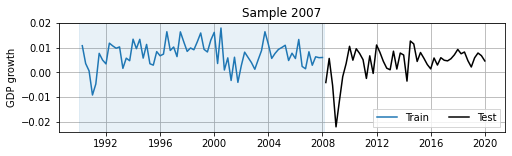

In [27]:
plt.figure(figsize=(8,2))
plt.axvspan(pd.to_datetime("01-01-1990"), pd.to_datetime("01-31-2008"),
                color="C0", alpha=0.1)
plt.plot(dataset2007['GDP_data_train'], label="Train", color="C0")
plt.plot(dataset2007['GDP_data_test'], color="black", label="Test")
plt.ylabel("GDP growth")
plt.grid()
plt.legend(loc="lower right", fancybox=False, shadow=False, ncol=2)
plt.title("Sample 2007")
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_train_sample_2007.pdf'), bbox_inches="tight")
plt.show()

In [28]:
# Export data to MATLAB
#dataset2007['m_data_train'].to_csv(os.path.join(path_folder, "data", "m_data_train.csv"))
#dataset2007['m_data_test'].to_csv(os.path.join(path_folder, "data", "m_data_test.csv"))
#dataset2007['d_data_train'].to_csv(os.path.join(path_folder, "data", "d_data_train.csv"))
#dataset2007['d_data_test'].to_csv(os.path.join(path_folder, "data", "d_data_test.csv"))

[MFESN ONLY] Get 'extended' dataset to have enough CV data:

In [29]:
dataset2007_ext = getSmallDatasets_extended(
    '1975-01-01', '2019-12-31', trainTestSplitDate='2007-12-31'
)

In [30]:
# for c in dataset2007['md_fill_data_train'].columns:
#     plt.figure(figsize=(12,1.5))
#     plt.plot(dataset2007_ext['md_fill_data_train'][c], label=c)
#     plt.plot(dataset2007['md_fill_data_train'][c], label=c)
#     plt.ylabel(c)
#     plt.grid()
#     plt.show()

# plt.figure(figsize=(12,1.5))
# plt.plot(dataset2007_ext['GDP_fill_data_train'])
# plt.plot(dataset2007['GDP_fill_data_train'])
# plt.ylabel("GDP")
# plt.grid()
# plt.show()

#### 1-step Ahead Point Forecast Comparison

##### Fixed Parameters

In [31]:
#DFM_A_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_fixed__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_fix_forecast_2007 = DFM_A_fix_forecast[['0']].loc[DFM_slice_2007,]
#
#DFM_B_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_fixed__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_fix_forecast_2007 = DFM_B_fix_forecast[['0']].loc[DFM_slice_2007,]

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', date_slice=DFM_slice_2007,
)

DFM_B_fix_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2007', date_slice=DFM_slice_2007,
)

In [32]:
def uncondMean_1sa_fixParamsForecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_test_dates = data['GDP_data_test'].index

    return pd.DataFrame(
        data=np.ones((len(GDP_test_dates))) * GDP_data_train.mean().iloc[0],
        index=GDP_test_dates,
    )

In [33]:
UnMean_fix_for_1sa_2007 = uncondMean_1sa_fixParamsForecast(
    data=dataset2007,
)

In [34]:
def lowfreqAR_1sa_fixParamsForecast(data):
    # NOTE: add frequency explicitly, required by statmodels.SARIMAX
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )

    # Select AR oder
    # arOrder = ar_select_order(
    #     GDP_data_train.to_numpy(),
    #     maxlag=4,
    #     ic='bic',
    # )
    # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
    # print(arOrder.ar_lags)

    # Fix AR(1) model
    arOrder = 1

    # Fit AR model
    arModel = AutoReg(
        GDP_data_train,
        lags=arOrder,
        trend='c',
    )
    fit = arModel.fit()
    print(fit.summary())

    plt.figure(figsize=(12,2))
    plt.plot(GDP_data_train, c='k')
    plt.plot(fit.predict())
    plt.grid()
    plt.show()

    # Forecast 
    forecast_fix = np.zeros((len(GDP_data_test), 1))
    for j in range(len(GDP_data_test)):
        forecast_fix[j] = fit.forecast().to_numpy()
        # print(fit.forecast())
        # print(GDP_data_test.iloc[[j],:])
        # Append next datapoint
        fit = fit.append(GDP_data_test.iloc[[j],:])

    AR_fix_forecast = pd.DataFrame(
        data=(forecast_fix * GDP_sig_train.to_numpy() 
                + GDP_mu_train.to_numpy()), 
        index=GDP_test_dates,
    )
        
    return AR_fix_forecast

                            AutoReg Model Results                             
Dep. Variable:                     Q1   No. Observations:                   72
Model:                     AutoReg(1)   Log Likelihood                 -97.433
Method:               Conditional MLE   S.D. of innovations              0.954
Date:                Mon, 05 Jun 2023   AIC                            200.866
Time:                        12:03:07   BIC                            207.654
Sample:                    06-30-1990   HQIC                           203.566
                         - 12-31-2007                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0104      0.113     -0.092      0.926      -0.232       0.212
Q1.L1          0.2876      0.113      2.538      0.011       0.066       0.510
                                    Roots           

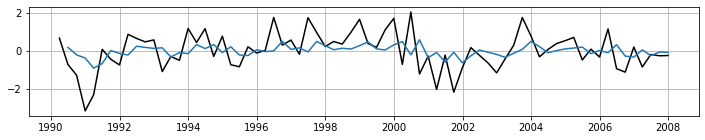

In [35]:
lowfreqAR_fix_for_1sa_2007 = lowfreqAR_1sa_fixParamsForecast(
    data=dataset2007,
)

In [36]:
def MIDAS_fix_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()
        )), )
    )

    # Fit
    MIDAS_fit = midasModel.fixedparamsForecast(
        data=(GDP_data_midas, md_data_midas),
        fit_length=len(GDP_data_train),
        steps=1,
        grad=True,
        method='L-BFGS-B',
        debug=False
    )

    midasModel.plotPhi(MIDAS_fit, figsize=(12, 2))

    # Compute pointwise forecasts
    MIDAS_fix_forecast = pd.DataFrame(
        data=(MIDAS_fit['forecasts'][0]['Forecast'] * 
            GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()), 
        index=GDP_test_dates,
    )

    return MIDAS_fix_forecast

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


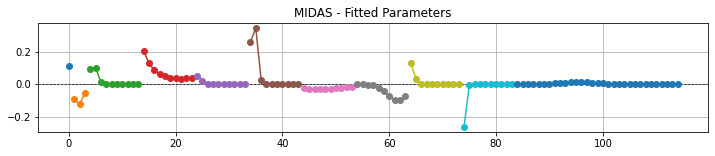

In [37]:
MIDAS_fix_for_1sa_2007 = MIDAS_fix_fit_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

In [38]:
def esnSingle_fix_fit_1sa(esnModel, Lambda, data, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    #GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    plt.figure(figsize=(12,2))
    plt.plot(esnSingle_fit['fit_for'][0]['Y'], c='k')
    plt.plot(esnSingle_fit['fit_for'][0]['Y_fit'])
    plt.grid()
    plt.show()

    esnSingle_for = esnModel.fixedParamsForecast(
        Yf=GDP_fill_data_test, zf=(md_fill_data_test, ), 
        fit=esnSingle_fit
    )

    # Compute pointwise forecasts
    esnSingle_fix_forecast = (esnSingle_for['Forecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())

    return esnSingle_fix_forecast

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


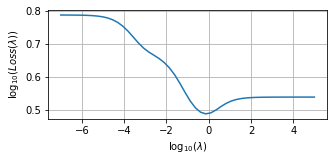

+ s = 0 --------------------
Best solution found:
lambda = [0.76481199]
F      = 3.0834804989816864


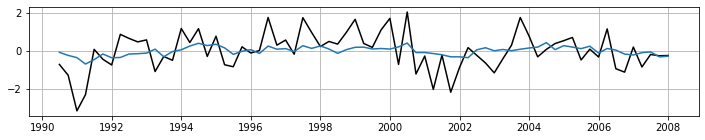

In [39]:
# Aggregated
esnSingle_A_agg_cv10_lambda_2007 = esnSingle_A.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnSingle_A_agg_fix_for_1sa_2007 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    #Lambda=[1e-2,],
    data=dataset2007,
    aggregate=True,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


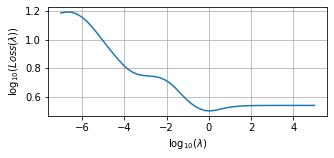

+ s = 0 --------------------
Best solution found:
lambda = [1.03754647]
F      = 3.1728961911990736


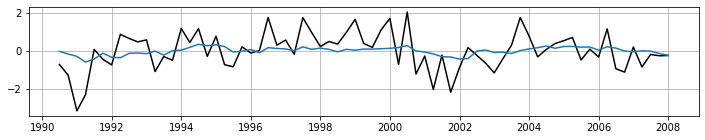

In [40]:
# Aggregated
esnSingle_B_agg_cv10_lambda_2007 = esnSingle_B.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnSingle_B_agg_fix_for_1sa_2007 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    #Lambda=[1e-2,],
    data=dataset2007,
    aggregate=True,
)

In [41]:
def esnMulti_fix_fit_1sa(esnModel, Lambda, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    plt.figure(figsize=(12,2))
    plt.plot(esnMulti_fit['fit_for'][0]['Y'], c='k')
    plt.plot(esnMulti_fit['fit_for'][0]['Y_fit'])
    plt.grid()
    plt.show()

    esnMulti_for = esnModel.fixedParamsForecast(
        Yf=GDP_data_test, zf=(m_data_test, d_data_test), 
        fit=esnMulti_fit
    )

    # Compute pointwise forecasts
    esnMulti_fix_forecast = (esnMulti_for['Forecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())

    return esnMulti_fix_forecast

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


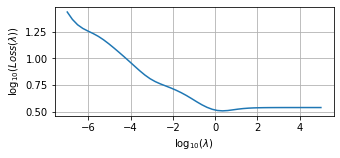

+ s = 0 --------------------
Best solution found:
lambda = [2.19032772]
F      = 3.226790356948246


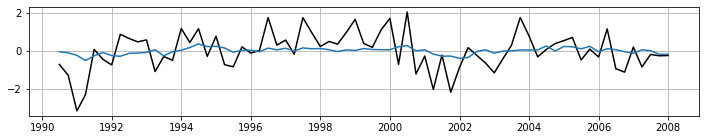

In [42]:
esnMulti_A_cv10_lambda_2007 = esnMulti_A.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_data_train'], 
    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    #cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
    steps=1,
    debug=True,
)

esnMulti_A_fix_for_1sa_2007 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    #Lambda=[1e-2, 1e-2],
    data=dataset2007,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


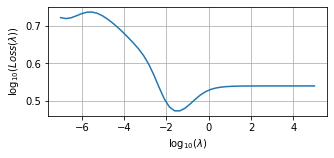

+ s = 0 --------------------
Best solution found:
lambda = [0.0322686]
F      = 2.965175622628758


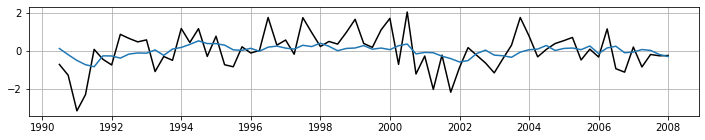

In [43]:
esnMulti_B_cv10_lambda_2007 = esnMulti_B.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_data_train'], 
    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnMulti_B_fix_for_1sa_2007 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
)

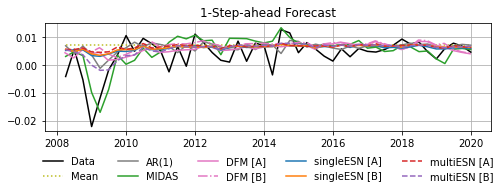

In [44]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_fix_for_1sa_2007, label="Mean", c="C8", ls=':')
#
plt.plot(lowfreqAR_fix_for_1sa_2007, label="AR(1)", c="C7")
plt.plot(MIDAS_fix_for_1sa_2007, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_forecast_2007, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_fix_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_2007.pdf'), bbox_inches="tight")
plt.show()

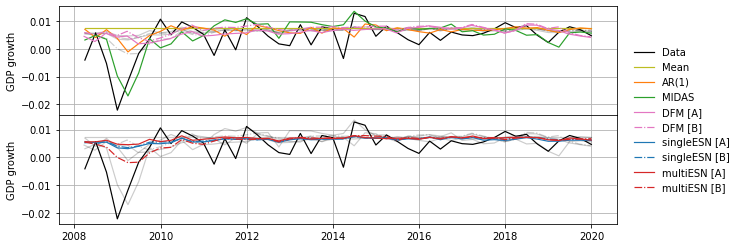

In [45]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2007['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_fix_for_1sa_2007, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_fix_for_1sa_2007, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_fix_for_1sa_2007, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_fix_for_1sa_2007, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_fix_for_1sa_2007, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_fix_for_1sa_2007, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_fix_for_1sa_2007, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_fix_forecast_2007, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_fix_forecast_2007, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2007['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_fix_for_1sa_2007, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_fix_for_1sa_2007, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_fix_for_1sa_2007, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_fix_forecast_2007, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_fix_forecast_2007, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_fix_for_1sa_2007, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_fix_for_1sa_2007, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_fix_for_1sa_2007, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_fix_for_1sa_2007, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Fixed Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_fix_2007.pdf'), bbox_inches="tight")
plt.show()

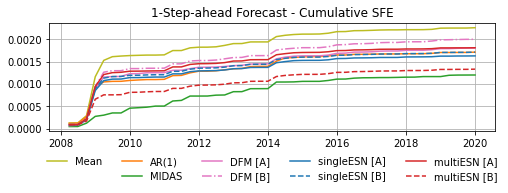

In [46]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
cumulSFE_2007 = lambda forecast : np.cumsum(np.square(dataset2007['GDP_data_test'] - forecast.to_numpy()))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2007(lowfreqAR_fix_for_1sa_2007), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_fix_2007.pdf'), bbox_inches="tight")
plt.show()

In [47]:
def MSFE_2007(forecast, startDate=None):
    if not startDate is None:
        startDate = pd.to_datetime(startDate)
        msfe = np.mean(np.square(
                dataset2007['GDP_data_test'].loc[startDate:,].to_numpy() - 
                    forecast.loc[startDate:,].to_numpy()
            ))
    else:
        msfe = np.mean(np.square(
                dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy()
            ))
    return msfe

UnMean_MSE_fix_2007_td = MSFE_2007(UnMean_fix_for_1sa_2007) * 1e4
lowfreqAR_MSE_fix_2007_td = MSFE_2007(lowfreqAR_fix_for_1sa_2007) * 1e4
MIDAS_MSE_fix_2007_td = MSFE_2007(MIDAS_fix_for_1sa_2007) * 1e4 
DFM_A_MSE_fix_2007_td = MSFE_2007(DFM_A_fix_forecast_2007) * 1e4
DMF_B_MSE_fix_2007_td = MSFE_2007(DFM_B_fix_forecast_2007) * 1e4
esnSingle_A_MSE_fix_2007_td = MSFE_2007(esnSingle_A_agg_fix_for_1sa_2007) * 1e4
esnSingle_B_MSE_fix_2007_td = MSFE_2007(esnSingle_B_agg_fix_for_1sa_2007) * 1e4
esnMulti_A_MSE_fix_2007_td = MSFE_2007(esnMulti_A_fix_for_1sa_2007) * 1e4
esnMulti_B_MSE_fix_2007_td = MSFE_2007(esnMulti_B_fix_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_fix_2007_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_fix_2007_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_fix_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_fix_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_fix_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_fix_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_fix_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_fix_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_fix_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_fix_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.4702 	|	0.6857
AR(1) 		 = 0.3566 	|	0.5971
MIDAS 		 = 0.2504 	|	0.5004
DFM [A]		 = 0.3755 	|	0.6128
DFM [B]		 = 0.4162 	|	0.6451
singleESN [A]	 = 0.3392 	|	0.5824
singleESN [B]	 = 0.3564 	|	0.597
multiESN [A]	 = 0.3771 	|	0.6141
multiESN [B]	 = 0.2776 	|	0.5269


In [48]:
ref_MSE_2007_fix = UnMean_MSE_fix_2007_td
lowfreqAR_MSE_toRef_2007_fix = lowfreqAR_MSE_fix_2007_td / ref_MSE_2007_fix
MIDAS_MSE_toRef_2007_fix = MIDAS_MSE_fix_2007_td / ref_MSE_2007_fix
DFM_A_MSE_toRef_2007_fix = DFM_A_MSE_fix_2007_td / ref_MSE_2007_fix
DMF_B_MSE_toRef_2007_fix = DMF_B_MSE_fix_2007_td / ref_MSE_2007_fix
esnSingle_A_MSE_toRef_2007_fix = esnSingle_A_MSE_fix_2007_td / ref_MSE_2007_fix
esnSingle_B_MSE_toRef_2007_fix = esnSingle_B_MSE_fix_2007_td / ref_MSE_2007_fix
esnMulti_A_MSE_toRef_2007_fix = esnMulti_A_MSE_fix_2007_td / ref_MSE_2007_fix
esnMulti_B_MSE_toRef_2007_fix = esnMulti_B_MSE_fix_2007_td / ref_MSE_2007_fix

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2007_fix.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_fix.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_fix.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_fix.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_fix.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_fix.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_fix.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_fix.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 0.7584
MIDAS 		 = 0.5326
DFM [A]		 = 0.7987
DFM [B]		 = 0.8852
singleESN [A]	 = 0.7215
singleESN [B]	 = 0.758
multiESN [A]	 = 0.802
multiESN [B]	 = 0.5904


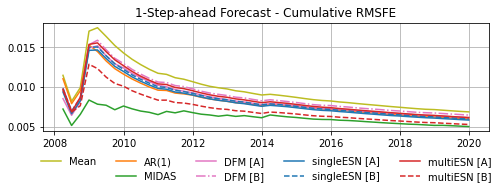

In [49]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
def cumulRMSFE_2007(forecast):
    cumulMFE = np.cumsum(np.square(dataset2007['GDP_data_test'] - forecast.to_numpy()))
    return np.sqrt(cumulMFE / np.reshape(np.arange(1, len(forecast)+1), (-1, 1)))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2007(lowfreqAR_fix_for_1sa_2007), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_fix_2007.pdf'), bbox_inches="tight")
plt.show()

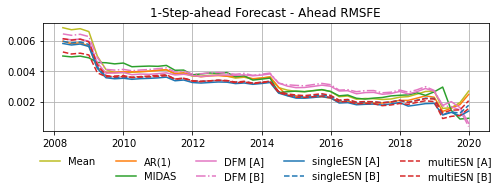

In [50]:
# Plot -- 1-Step-ahead Forecast - Ahead RMSFE
def aheadRMSFE_2007(forecast):
    fSFE = np.flip(np.square(dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy()))
    aheadMSFE = np.sqrt(np.cumsum(fSFE) / np.arange(1, len(forecast)+1))
    return pd.DataFrame(data=np.flip(aheadMSFE), index=dataset2007['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2007(lowfreqAR_fix_for_1sa_2007), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_fix_2007.pdf'), bbox_inches="tight")
plt.show()

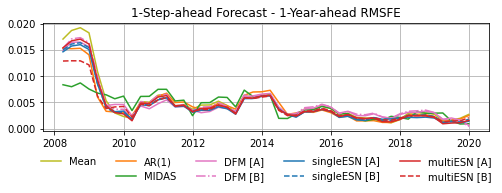

In [51]:
# Plot -- 1-Step-ahead Forecast - 1-Year-ahead RMSFE
def YA_RMSFE_2007(forecast):
    SFE = np.square(dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy())
    T = len(SFE)
    YA_RMSFE = np.array(
        [np.sqrt(np.mean(SFE[j:min(j+4,T)])) for j in range(T)]
    )
    return pd.DataFrame(data=YA_RMSFE, index=dataset2007['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2007(lowfreqAR_fix_for_1sa_2007), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(YA_RMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_fix_2007.pdf'), bbox_inches="tight")
plt.show()

In [52]:
mcs_data_2007_fix = pd.DataFrame(
    np.c_[UnMean_fix_for_1sa_2007,
        lowfreqAR_fix_for_1sa_2007,
        MIDAS_fix_for_1sa_2007, 
        DFM_A_fix_forecast_2007,
        DFM_B_fix_forecast_2007,
        esnSingle_A_agg_fix_for_1sa_2007,
        esnSingle_B_agg_fix_for_1sa_2007,
        esnMulti_A_fix_for_1sa_2007,
        esnMulti_B_fix_for_1sa_2007,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']
)
mcs_data_2007_fix = (mcs_data_2007_fix - dataset2007['GDP_data_test'].to_numpy())

mcs_25_2007_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2007_fix), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2007_fix), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_fix.included}")
print(f"MCS 10 included: {mcs_10_2007_fix.included}")

MCS 25 included: ['singleESN [A]', 'multiESN [B]', 'MIDAS']
MCS 10 included: ['singleESN [A]', 'multiESN [B]', 'MIDAS']


In [53]:
mcs_25_2007_fix.pvalues

DFM [B]          0.0112
Mean             0.0984
DFM [A]          0.0984
AR(1)            0.0984
multiESN [A]     0.0984
singleESN [B]    0.0984
singleESN [A]    0.3862
multiESN [B]     0.7245
MIDAS            1.0000
dtype: float64

In [54]:
if saveR:
    mcs_data_2007_fix.to_csv(
        os.path.join(path_folder, "R", "mcs_small_fix_2007.csv")
    )

In [55]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Expanding Window

In [56]:
DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', date_slice=DFM_slice_2007,
)

DFM_B_ew_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2007', date_slice=DFM_slice_2007,
)

In [57]:
def uncondMean_ew_1sa_Forecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in range(len(GDP_data_test)):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        forecast_ew[j] = GDP_data_train_j.mean().iloc[0]

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

In [58]:
UnMean_ew_1sa_forecast_2007 = uncondMean_ew_1sa_Forecast(
    data=dataset2007,
)

In [59]:
def lowfreqAR_ew_1sa_Forecast(data):
    # NOTE: add frequency explicitly, required by statmodels.SARIMAX
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
        else:
            GDP_data_train_j = GDP_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )

        # Select AR oder
        # arOrder = ar_select_order(
        #     GDP_data_train_j.to_numpy(),
        #     maxlag=4,
        #     ic='bic',
        # )
        # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
        # print(arOrder.ar_lags)

        # Fix AR(1) model
        arOrder = 1

        # Fit AR model
        arModel = AutoReg(
            GDP_data_train_j,
            lags=arOrder,
            trend='c',
        )
        fit = arModel.fit()

        # Forecast 
        forecast_ew[j] = fit.forecast().to_numpy() * sig_j + mu_j
        
    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

In [60]:
lowfreqAR_ew_1sa_forecast_2007 = lowfreqAR_ew_1sa_Forecast(
    data=dataset2007,
)

In [61]:
def MIDAS_ew_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(GDP_data_train_j.shape)
        #print(GDP_data_test_j.shape)
        #print(m_data_train_j.shape)
        #print(m_data_test_j.shape)
        #print(d_data_train_j.shape)
        #print(d_data_test_j.shape)

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        #print(f"j = {j}")
        #print(MIDAS_fit['forecasts'][0]['Forecast'][0])
        #print("-------------------------------")

        forecast_ew[j] = np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

In [62]:
%%capture
MIDAS_ew_1sa_forecast_2007 = MIDAS_ew_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2007,
)

In [63]:
def esnSingle_ew_fit_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_ew = np.zeros((len(GDP_fill_data_test), 1))
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        #print(np.mean(GDP_fill_data_train_j))
        #print(np.mean(GDP_fill_data_train_j))

        #print(f"j = {j}")
        #print(f"{GDP_fill_data_train_j.index[-1]} | {GDP_fill_data_test_j.index[0]}")
        #print(f"{md_fill_data_train_j.index[-1]} | {md_fill_data_test_j.index[0]} -> {md_fill_data_test_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_ew[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

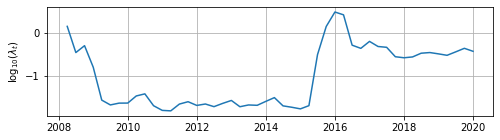

In [64]:
esnSingle_A_agg_ew_for_1sa_2007 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

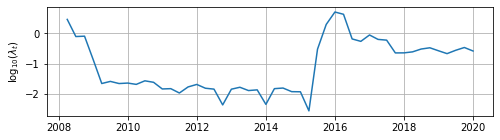

In [65]:
esnSingle_B_agg_ew_for_1sa_2007 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [66]:
def esnMulti_ew_fit_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_data_train_j.index[-1]} | {GDP_data_test_j.index[0]}")
        #print(f"{m_data_train_j.index[-1]} | {m_data_test_j.index[0]} -> {m_data_test_j.index[-1]}")
        #print(f"{d_data_train_j.index[-1]} | {d_data_test_j.index[0]} -> {d_data_test_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_ew[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

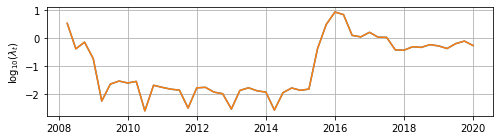

In [67]:
esnMulti_A_ew_for_1sa_2007 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

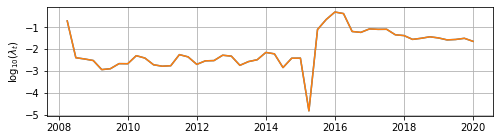

In [68]:
esnMulti_B_ew_for_1sa_2007 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

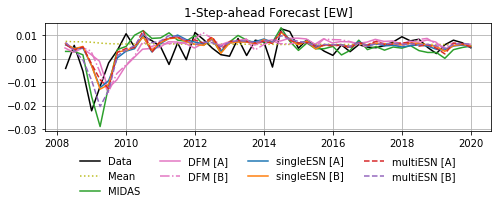

In [69]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_ew_1sa_forecast_2007, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_ew_1sa_forecast_2007, label="MIDAS", c="C2")
#
plt.plot(DFM_A_ew_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_forecast_2007, label="DFM [B]", c="C6", ls='-.')  
#
plt.plot(esnSingle_A_agg_ew_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_ew_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2007.pdf'), bbox_inches="tight")
plt.show()

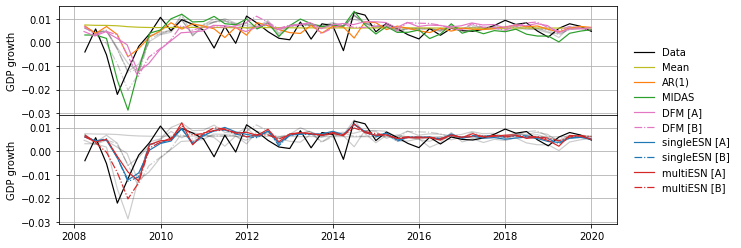

In [70]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2007['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_ew_for_1sa_2007, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_ew_for_1sa_2007, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_ew_for_1sa_2007, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_ew_for_1sa_2007, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_ew_1sa_forecast_2007, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_ew_1sa_forecast_2007, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_ew_1sa_forecast_2007, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_ew_forecast_2007, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_ew_forecast_2007, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2007['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_ew_1sa_forecast_2007, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_ew_1sa_forecast_2007, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_ew_1sa_forecast_2007, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_ew_forecast_2007, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_ew_forecast_2007, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_ew_for_1sa_2007, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_ew_for_1sa_2007, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_ew_for_1sa_2007, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_ew_for_1sa_2007, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Expanding Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2007.pdf'), bbox_inches="tight")
plt.show()

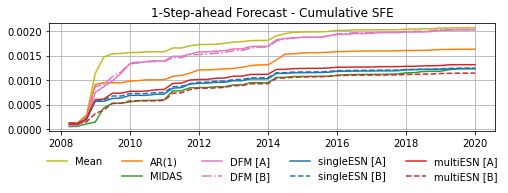

In [71]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2007(lowfreqAR_ew_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [72]:
UnMean_MSE_ew_2007_td = MSFE_2007(UnMean_ew_1sa_forecast_2007) * 1e4
lowfreqAR_MSE_ew_2007_td = MSFE_2007(lowfreqAR_ew_1sa_forecast_2007) * 1e4
MIDAS_MSE_ew_2007_td = MSFE_2007(MIDAS_ew_1sa_forecast_2007) * 1e4
DFM_A_MSE_ew_2007_td = MSFE_2007(DFM_A_ew_forecast_2007) * 1e4
DMF_B_MSE_ew_2007_td = MSFE_2007(DFM_B_ew_forecast_2007) * 1e4
esnSingle_A_MSE_ew_2007_td = MSFE_2007(esnSingle_A_agg_ew_for_1sa_2007) * 1e4
esnSingle_B_MSE_ew_2007_td = MSFE_2007(esnSingle_B_agg_ew_for_1sa_2007) * 1e4
esnMulti_A_MSE_ew_2007_td = MSFE_2007(esnMulti_A_ew_for_1sa_2007) * 1e4
esnMulti_B_MSE_ew_2007_td = MSFE_2007(esnMulti_B_ew_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_ew_2007_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_ew_2007_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_ew_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_ew_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_ew_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_ew_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_ew_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_ew_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_ew_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_ew_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.4325 	|	0.6577
AR(1) 		 = 0.3411 	|	0.5841
MIDAS 		 = 0.258 	|	0.5079
DFM [A]		 = 0.4239 	|	0.6511
DFM [B]		 = 0.4249 	|	0.6518
singleESN [A]	 = 0.2581 	|	0.5081
singleESN [B]	 = 0.2602 	|	0.5101
multiESN [A]	 = 0.2747 	|	0.5241
multiESN [B]	 = 0.2389 	|	0.4888


In [73]:
ref_MSE_2007_ew = UnMean_MSE_ew_2007_td
lowfreqAR_MSE_toRef_2007_ew = lowfreqAR_MSE_ew_2007_td / ref_MSE_2007_ew
MIDAS_MSE_toRef_2007_ew = MIDAS_MSE_ew_2007_td / ref_MSE_2007_ew
DFM_A_MSE_toRef_2007_ew = DFM_A_MSE_ew_2007_td / ref_MSE_2007_ew
DMF_B_MSE_toRef_2007_ew = DMF_B_MSE_ew_2007_td / ref_MSE_2007_ew
esnSingle_A_MSE_toRef_2007_ew = esnSingle_A_MSE_ew_2007_td / ref_MSE_2007_ew
esnSingle_B_MSE_toRef_2007_ew = esnSingle_B_MSE_ew_2007_td / ref_MSE_2007_ew
esnMulti_A_MSE_toRef_2007_ew = esnMulti_A_MSE_ew_2007_td / ref_MSE_2007_ew
esnMulti_B_MSE_toRef_2007_ew = esnMulti_B_MSE_ew_2007_td / ref_MSE_2007_ew

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2007_ew.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_ew.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_ew.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_ew.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_ew.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_ew.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_ew.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_ew.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 0.7887
MIDAS 		 = 0.5964
DFM [A]		 = 0.9801
DFM [B]		 = 0.9823
singleESN [A]	 = 0.5968
singleESN [B]	 = 0.6017
multiESN [A]	 = 0.6351
multiESN [B]	 = 0.5524


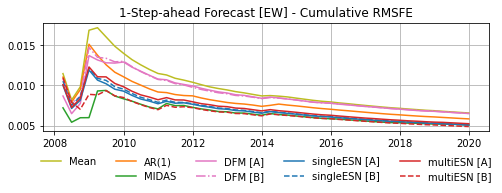

In [74]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2007(lowfreqAR_ew_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

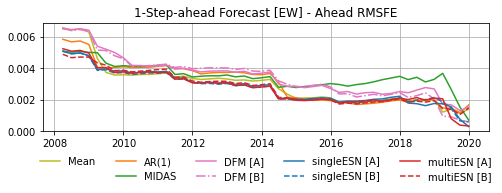

In [75]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2007(lowfreqAR_ew_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(aheadRMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

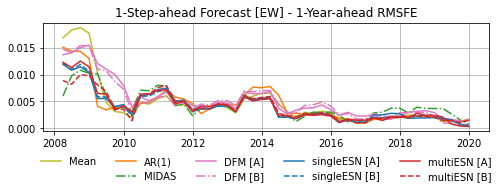

In [76]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2007(lowfreqAR_ew_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [77]:
mcs_data_2007_ew = pd.DataFrame(
    np.c_[UnMean_ew_1sa_forecast_2007,
        lowfreqAR_ew_1sa_forecast_2007,
        MIDAS_ew_1sa_forecast_2007, 
        DFM_A_ew_forecast_2007,
        DFM_B_ew_forecast_2007,
        esnSingle_A_agg_ew_for_1sa_2007,
        esnSingle_B_agg_ew_for_1sa_2007,
        esnMulti_A_ew_for_1sa_2007,
        esnMulti_B_ew_for_1sa_2007,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS [EW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [EW]', 'singleESN [B] [EW]', 'multiESN [A] [EW]', 'multiESN [B] [EW]']
)
mcs_data_2007_ew = (mcs_data_2007_ew - dataset2007['GDP_data_test'].to_numpy())
#mcs_data_2007_ew = mcs_data_2007_ew.iloc[6:,:]

mcs_25_2007_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2007_ew), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2007_ew), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_ew.included}")
print(f"MCS 10 included: {mcs_10_2007_ew.included}")

MCS 25 included: ['Mean', 'AR(1)', 'multiESN [A] [EW]', 'singleESN [B] [EW]', 'MIDAS [EW]', 'singleESN [A] [EW]', 'multiESN [B] [EW]']
MCS 10 included: ['DFM [B]', 'DFM [A]', 'Mean', 'AR(1)', 'multiESN [A] [EW]', 'singleESN [B] [EW]', 'MIDAS [EW]', 'singleESN [A] [EW]', 'multiESN [B] [EW]']


In [78]:
mcs_25_2007_ew.pvalues

DFM [B]               0.2376
DFM [A]               0.2422
Mean                  0.6892
AR(1)                 0.6892
multiESN [A] [EW]     0.6892
singleESN [B] [EW]    0.9439
MIDAS [EW]            0.9439
singleESN [A] [EW]    0.9439
multiESN [B] [EW]     1.0000
dtype: float64

In [79]:
if saveR:
    mcs_data_2007_ew.to_csv(
        os.path.join(path_folder, "R", "mcs_small_ew_2007.csv")
    )

In [80]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Rolling Window

In [81]:
DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2007', date_slice=DFM_slice_2007,
)

DFM_B_rw_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2007', date_slice=DFM_slice_2007,
)

In [82]:
def uncondMean_rw_1sa_Forecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in range(len(GDP_data_test)):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train.iloc[j:,],
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        forecast_rw[j] = GDP_data_train_j.mean().iloc[0]

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

In [83]:
UnMean_rw_1sa_forecast_2007 = uncondMean_rw_1sa_Forecast(
    data=dataset2007,
)

In [84]:
def lowfreqAR_rw_1sa_Forecast(data):
    # NOTE: add frequency explicitly, required by statmodels.SARIMAX
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
        else:
            GDP_data_train_j = GDP_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )

        # Select AR oder
        # arOrder = ar_select_order(
        #     GDP_data_train_j.to_numpy(),
        #     maxlag=4,
        #     ic='bic',
        # )
        # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
        # print(arOrder.ar_lags)

        # Fix AR(1) model
        arOrder = 1

        # Fit AR model
        arModel = AutoReg(
            GDP_data_train_j,
            lags=arOrder,
            trend='c',
        )
        fit = arModel.fit()

        # Forecast 
        forecast_rw[j] = fit.forecast().to_numpy() * sig_j + mu_j
        
    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

In [85]:
lowfreqAR_rw_1sa_forecast_2007 = lowfreqAR_rw_1sa_Forecast(
    data=dataset2007,
)

In [86]:
def MIDAS_rw_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(GDP_data_train_j.shape)
        #print(GDP_data_test_j.shape)
        #print(m_data_train_j.shape)
        #print(m_data_test_j.shape)
        #print(d_data_train_j.shape)
        #print(d_data_test_j.shape)

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        #print(f"j = {j}")
        #print(MIDAS_fit['forecasts'][0]['Forecast'][0])
        #print("-------------------------------")

        forecast_rw[j] = np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

In [87]:
%%capture
MIDAS_rw_1sa_forecast_2007 = MIDAS_rw_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2007,
)

In [88]:
def esnSingle_rw_fit_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_rw = np.zeros((len(GDP_fill_data_test), 1))
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_fill_data_train_j.index[-1]} | {GDP_fill_data_test_j.index[0]}")
        #print(f"{md_fill_data_train_j.index[-1]} | {md_fill_data_test_j.index[0]} -> {md_fill_data_test_j.index[-1]}")
        #print(f"{GDP_fill_data_train_j.index[0]} -> {GDP_fill_data_train_j.index[-1]}")
        #print(f"{md_fill_data_train_j.index[0]} -> {md_fill_data_train_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_rw[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

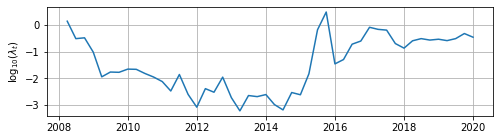

In [89]:
esnSingle_A_agg_rw_for_1sa_2007 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

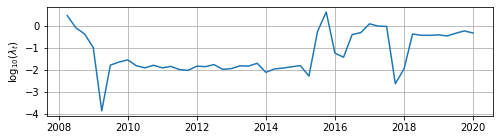

In [90]:
esnSingle_B_agg_rw_for_1sa_2007 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007,
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [91]:
def esnMulti_rw_fit_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_data_train_j.index[-1]} | {GDP_data_test_j.index[0]}")
        #print(f"{m_data_train_j.index[-1]} | {m_data_test_j.index[0]} -> {m_data_test_j.index[-1]}")
        #print(f"{d_data_train_j.index[-1]} | {d_data_test_j.index[0]} -> {d_data_test_j.index[-1]}")
        #print(f"{GDP_data_train_j.index[0]} -> {GDP_data_train_j.index[-1]}")
        #print(f"{m_data_train_j.index[0]} -> {m_data_train_j.index[-1]}")
        #print(f"{d_data_train_j.index[0]} -> {d_data_train_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_rw[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

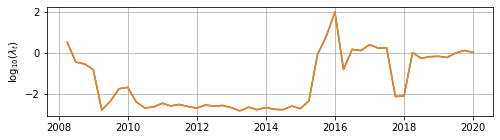

In [92]:
esnMulti_A_rw_for_1sa_2007 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

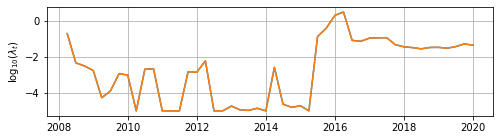

In [93]:
esnMulti_B_rw_for_1sa_2007 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

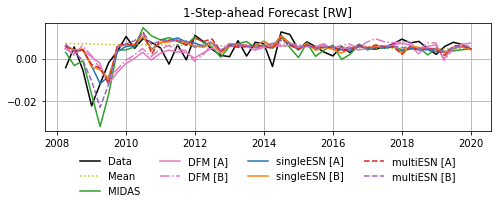

In [94]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_rw_1sa_forecast_2007, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_rw_1sa_forecast_2007, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_forecast_2007, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_rw_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2007.pdf'), bbox_inches="tight")
plt.show()

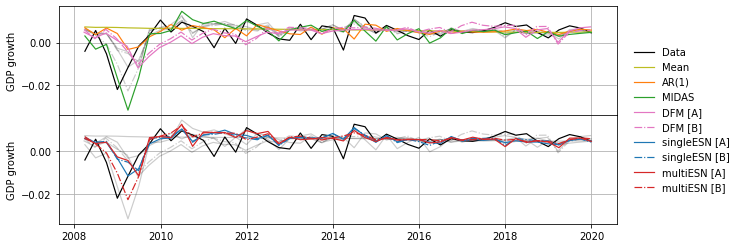

In [95]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2007['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_rw_for_1sa_2007, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_rw_for_1sa_2007, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_rw_for_1sa_2007, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_rw_for_1sa_2007, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_rw_1sa_forecast_2007, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_rw_1sa_forecast_2007, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_rw_1sa_forecast_2007, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_rw_forecast_2007, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_rw_forecast_2007, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2007['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_rw_1sa_forecast_2007, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_rw_1sa_forecast_2007, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_rw_1sa_forecast_2007, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_rw_forecast_2007, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_rw_forecast_2007, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_rw_for_1sa_2007, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_rw_for_1sa_2007, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_rw_for_1sa_2007, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_rw_for_1sa_2007, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Rolling Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2007.pdf'), bbox_inches="tight")
plt.show()

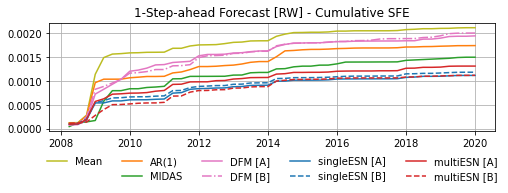

In [96]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2007(lowfreqAR_rw_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast [RW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [97]:
UnMean_MSE_rw_2007_td = MSFE_2007(UnMean_rw_1sa_forecast_2007) * 1e4
lowfreqAR_MSE_rw_2007_td = MSFE_2007(lowfreqAR_rw_1sa_forecast_2007) * 1e4
MIDAS_MSE_rw_2007_td = MSFE_2007(MIDAS_rw_1sa_forecast_2007) * 1e4
DFM_A_MSE_rw_2007_td = MSFE_2007(DFM_A_rw_forecast_2007) * 1e4
DMF_B_MSE_rw_2007_td = MSFE_2007(DFM_B_rw_forecast_2007) * 1e4
esnSingle_A_MSE_rw_2007_td = MSFE_2007(esnSingle_A_agg_rw_for_1sa_2007) * 1e4
esnSingle_B_MSE_rw_2007_td = MSFE_2007(esnSingle_B_agg_rw_for_1sa_2007) * 1e4
esnMulti_A_MSE_rw_2007_td = MSFE_2007(esnMulti_A_rw_for_1sa_2007) * 1e4
esnMulti_B_MSE_rw_2007_td = MSFE_2007(esnMulti_B_rw_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_rw_2007_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_ew_2007_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_rw_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_rw_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_rw_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_rw_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_rw_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_rw_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_rw_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_rw_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.4404 	|	0.6637
AR(1) 		 = 0.3411 	|	0.5841
MIDAS 		 = 0.3122 	|	0.5588
DFM [A]		 = 0.405 	|	0.6364
DFM [B]		 = 0.4173 	|	0.646
singleESN [A]	 = 0.2331 	|	0.4828
singleESN [B]	 = 0.247 	|	0.497
multiESN [A]	 = 0.2737 	|	0.5231
multiESN [B]	 = 0.2336 	|	0.4833


In [98]:
ref_MSE_2007_rw = UnMean_MSE_rw_2007_td
lowfreqAR_MSE_toRef_2007_rw = lowfreqAR_MSE_ew_2007_td / ref_MSE_2007_rw
MIDAS_MSE_toRef_2007_rw = MIDAS_MSE_rw_2007_td / ref_MSE_2007_rw
DFM_A_MSE_toRef_2007_rw = DFM_A_MSE_rw_2007_td / ref_MSE_2007_rw
DMF_B_MSE_toRef_2007_rw = DMF_B_MSE_rw_2007_td / ref_MSE_2007_rw
esnSingle_A_MSE_toRef_2007_rw = esnSingle_A_MSE_rw_2007_td / ref_MSE_2007_rw
esnSingle_B_MSE_toRef_2007_rw = esnSingle_B_MSE_rw_2007_td / ref_MSE_2007_rw
esnMulti_A_MSE_toRef_2007_rw = esnMulti_A_MSE_rw_2007_td / ref_MSE_2007_rw
esnMulti_B_MSE_toRef_2007_rw = esnMulti_B_MSE_rw_2007_td / ref_MSE_2007_rw

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2007_rw.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_rw.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_rw.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_rw.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_rw.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_rw.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_rw.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_rw.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 0.7746
MIDAS 		 = 0.7089
DFM [A]		 = 0.9194
DFM [B]		 = 0.9475
singleESN [A]	 = 0.5292
singleESN [B]	 = 0.5607
multiESN [A]	 = 0.6213
multiESN [B]	 = 0.5303


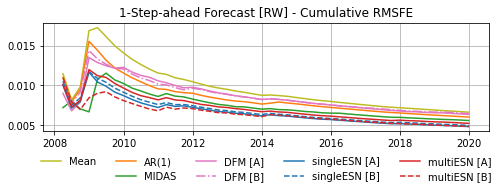

In [99]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2007(lowfreqAR_rw_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

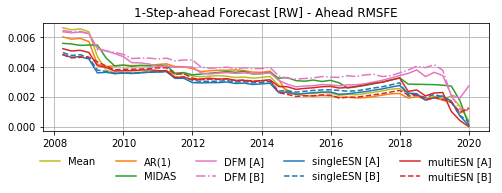

In [100]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2007(lowfreqAR_rw_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(aheadRMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

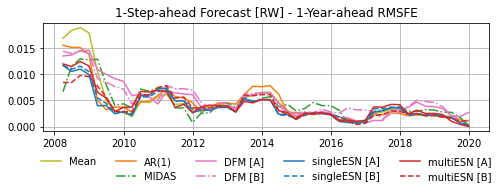

In [101]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2007(lowfreqAR_rw_1sa_forecast_2007), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [102]:
mcs_data_2007_rw = pd.DataFrame(
    np.c_[UnMean_rw_1sa_forecast_2007,
        lowfreqAR_rw_1sa_forecast_2007,
        MIDAS_rw_1sa_forecast_2007,
        DFM_A_rw_forecast_2007,
        DFM_B_rw_forecast_2007,
        esnSingle_A_agg_rw_for_1sa_2007,
        esnSingle_B_agg_rw_for_1sa_2007,
        esnMulti_A_rw_for_1sa_2007,
        esnMulti_B_rw_for_1sa_2007,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS [RW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [A] [RW]', 'multiESN [B] [RW]']
)
mcs_data_2007_rw = (mcs_data_2007_rw - dataset2007['GDP_data_test'].to_numpy())

mcs_25_2007_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2007_rw), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2007_rw), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_rw.included}")
print(f"MCS 10 included: {mcs_10_2007_rw.included}")

MCS 25 included: ['Mean', 'AR(1)', 'MIDAS [RW]', 'multiESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]']
MCS 10 included: ['DFM [A]', 'Mean', 'AR(1)', 'MIDAS [RW]', 'multiESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]']


In [103]:
mcs_25_2007_rw.pvalues

DFM [B]               0.0804
DFM [A]               0.1925
Mean                  0.2932
AR(1)                 0.2932
MIDAS [RW]            0.2932
multiESN [A] [RW]     0.2932
singleESN [B] [RW]    0.3982
multiESN [B] [RW]     0.9927
singleESN [A] [RW]    1.0000
dtype: float64

In [104]:
if saveR:
    mcs_data_2007_rw.to_csv(
        os.path.join(path_folder, "R", "mcs_small_rw_2007.csv")
    )

In [105]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


#### 1-step Ahead High-Frequency Forecast Comparison

##### Fixed Parameters

In [ ]:
DFM_A_fix_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', 
)
DFM_A_fix_highfreq_forecast_2007 = DFM_A_fix_highfreq_forecast_2007.loc[
    (DFM_A_fix_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_fix_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_fix_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2007',
)
DFM_B_fix_highfreq_forecast_2007 = DFM_B_fix_highfreq_forecast_2007.loc[
    (DFM_B_fix_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_fix_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_fix_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_fix_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_fix_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_fix_highfreq_forecast_2007 = DFM_A_fix_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_fix_highfreq_forecast_2007 = DFM_B_fix_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [ ]:
def MIDAS_fix_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()
        )), )
    )

    # Fit
    MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
        data=(GDP_data_midas, md_data_midas),
        fit_length=len(GDP_data_train),
        steps=1,
        grad=True,
        method='L-BFGS-B',
        debug=False
    )

    #midasModel.plotPhi(MIDAS_fit, figsize=(12, 2))

    # NOTE: build high-freq forecast index *manually*
    #       (here easier than programmatically)
    index_for = GDP_test_dates[[0]]
    for m in pd.date_range(GDP_test_dates[0]+pd.offsets.Day(1), GDP_test_dates[-1], freq="M"):
        index_for = index_for.union(pd.date_range(
            m - pd.offsets.Day(23), m,
        ))

    # Compute pointwise forecasts
    MIDAS_fix_forecast = pd.DataFrame(
        data=(MIDAS_fit['forecasts'][0]['Forecast'] * 
            GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()), 
        #index=GDP_test_dates[[0]].union(
        #    d_test_dates[d_test_dates > GDP_test_dates[0]]
        #),
        index=index_for,
    )

    return MIDAS_fix_forecast

In [ ]:
MIDAS_fix_for_highfreq_1sa_2007 = MIDAS_fix_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [ ]:
def esnSingle_fix_fit_highfreq_1sa(esnModel, Lambda, data, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    #GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_fill_data_test, zf=(md_fill_data_test,), 
        fit=esnSingle_fit
    )

    # Compute pointwise forecasts
    esnSingle_fix_hf_forecast = (esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    target_hf = (esnSingle_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return {"hf_forecast": esnSingle_fix_hf_forecast, "hf_target": target_hf}

In [ ]:
esnSingle_A_agg_fix_highfreq_for_1sa_2007 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    aggregate=True,
)

esnSingle_B_agg_fix_highfreq_for_1sa_2007 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    aggregate=True,
)

In [ ]:
def esnMulti_fix_fit_highfreq_1sa(esnModel, Lambda, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_data_test, zf=(m_data_test, d_data_test), 
        fit=esnMulti_fit
    )

    # Compute pointwise forecasts
    esnMulti_fix_hf_forecast = (esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    target_hf = (esnMulti_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return {"hf_forecast": esnMulti_fix_hf_forecast, "hf_target": target_hf}

In [ ]:
esnMulti_A_fix_highfreq_for_1sa_2007 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
)

esnMulti_B_fix_highfreq_for_1sa_2007 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
)

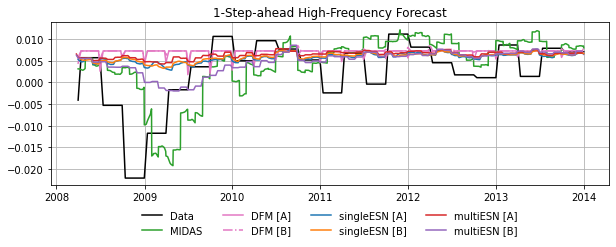

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_fix_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_fix_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

##### Expanding Window

In [ ]:
DFM_A_ew_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', 
)
DFM_A_ew_highfreq_forecast_2007 = DFM_A_ew_highfreq_forecast_2007.loc[
    (DFM_A_ew_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_ew_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_ew_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2007',
)
DFM_B_ew_highfreq_forecast_2007 = DFM_B_ew_highfreq_forecast_2007.loc[
    (DFM_B_ew_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_ew_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_ew_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_ew_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_ew_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_ew_highfreq_forecast_2007 = DFM_A_ew_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_ew_highfreq_forecast_2007 = DFM_B_ew_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [ ]:
def MIDAS_ew_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_hf_ew = []
    #target_hf_ew = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j == 0:
            GDP_data_test_j = GDP_data_test.iloc[[0,1],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
        elif j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        print(f"j = {j}")

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        # NOTE: build high-freq forecast index *manually*
        #       (here easier than programmatically)
        index_for_j = GDP_data_test_j.index[[0]]
        for m in pd.date_range(GDP_data_test_j.index[0]+pd.offsets.Day(1), GDP_data_test_j.index[-1], freq="M"):
            index_for_j = index_for_j.union(pd.date_range(
                m - pd.offsets.Day(23), m,
            ))
        index_for_j = index_for_j[:-1]

        #print(index_for_j)

        # Compute pointwise forecasts
        MIDAS_fix_forecast = pd.DataFrame(
            data=(MIDAS_fit['forecasts'][0]['Forecast'][:-1] * sig_j.to_numpy() + mu_j.to_numpy()), 
            index=index_for_j,
        )
        forecast_hf_ew.append(MIDAS_fix_forecast)

    forecast_hf_ew = pd.concat(forecast_hf_ew)

    return forecast_hf_ew

In [ ]:
MIDAS_ew_for_highfreq_1sa_2007 = MIDAS_ew_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))



j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\n

j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:693: RuntimeWarning: invalid value encountered in matmul
  G1 = (Zt[for_zslices[i],0:p]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:694: RuntimeWarning: invalid value encountered in matmul
  D  = (Zt[for_zslices[i],p:]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value en

j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 32
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 33
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 34
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 35
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 36
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 37
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 38
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 39
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 40
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 41
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 42
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 43
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 44
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 45
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 46
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 47
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


In [ ]:
def esnSingle_ew_fit_highfreq_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_hf_ew = []
    target_hf_ew = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train

        if j < (len(GDP_fill_data_test) - 1):
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j,j+1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[-1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_ew = pd.concat(forecast_hf_ew)
    target_hf_ew = pd.concat(target_hf_ew)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_ew_forecast": forecast_hf_ew, "hf_target": target_hf_ew}

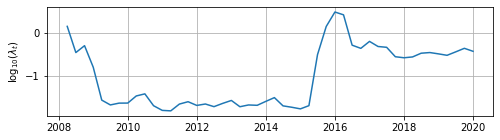

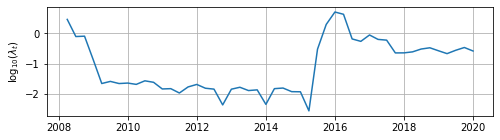

In [ ]:
esnSingle_A_agg_ew_highfreq_for_1sa_2007 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_highfreq_for_1sa_2007 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [ ]:
def esnMulti_ew_fit_highfreq_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_hf_ew = []
    target_hf_ew = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[j+1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[-1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_hf_ew.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_ew.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_ew = pd.concat(forecast_hf_ew)
    target_hf_ew = pd.concat(target_hf_ew)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_ew_forecast": forecast_hf_ew, "hf_target": target_hf_ew}

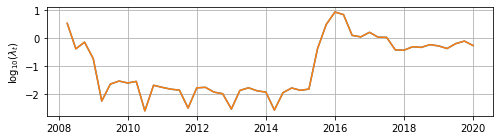

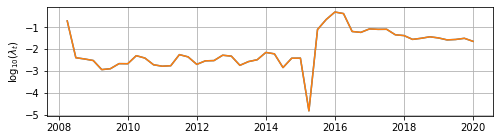

In [ ]:
esnMulti_A_ew_highfreq_for_1sa_2007 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_ew_highfreq_for_1sa_2007 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

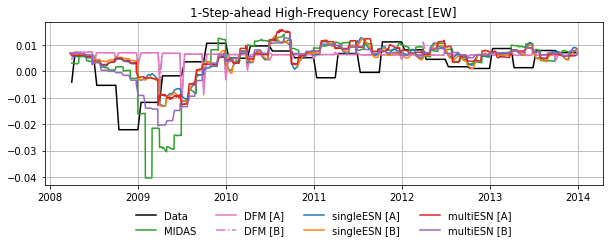

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_ew_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_ew_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

##### Rolling Window

In [ ]:
DFM_A_rw_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2007', 
)
DFM_A_rw_highfreq_forecast_2007 = DFM_A_rw_highfreq_forecast_2007.loc[
    (DFM_A_rw_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_rw_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_rw_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2007',
)
DFM_B_rw_highfreq_forecast_2007 = DFM_B_rw_highfreq_forecast_2007.loc[
    (DFM_B_rw_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_rw_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_rw_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_rw_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_rw_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_rw_highfreq_forecast_2007 = DFM_A_rw_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_rw_highfreq_forecast_2007 = DFM_B_rw_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [ ]:
def MIDAS_rw_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecast_hf_rw = []
    #target_hf_rw = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j == 0:
            GDP_data_test_j = GDP_data_test.iloc[[0,1],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
        elif j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        print(f"j = {j}")

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        # NOTE: build high-freq forecast index *manually*
        #       (here easier than programmatically)
        index_for_j = GDP_data_test_j.index[[0]]
        for m in pd.date_range(GDP_data_test_j.index[0]+pd.offsets.Day(1), GDP_data_test_j.index[-1], freq="M"):
            index_for_j = index_for_j.union(pd.date_range(
                m - pd.offsets.Day(23), m,
            ))
        index_for_j = index_for_j[:-1]

        #print(index_for_j)

        # Compute pointwise forecasts
        MIDAS_fix_forecast = pd.DataFrame(
            data=(MIDAS_fit['forecasts'][0]['Forecast'][:-1] * sig_j.to_numpy() + mu_j.to_numpy()), 
            index=index_for_j,
        )
        forecast_hf_rw.append(MIDAS_fix_forecast)

    forecast_hf_rw = pd.concat(forecast_hf_rw)

    return forecast_hf_rw

In [ ]:
MIDAS_rw_for_highfreq_1sa_2007 = MIDAS_rw_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Ma

j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 32
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 33
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 34
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 35
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 36
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 37
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 38
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 39
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: invalid value encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 40
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 41
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 42
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 43
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 44
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 45
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 46
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 47
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [ ]:
def esnSingle_rw_fit_highfreq_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_hf_rw = []
    target_hf_rw = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train

        if j < (len(GDP_fill_data_test) - 1):
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j,j+1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[-1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[-1]]


        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_hf_rw.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_rw.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_rw = pd.concat(forecast_hf_rw)
    target_hf_rw = pd.concat(target_hf_rw)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_rw_forecast": forecast_hf_rw, "hf_target": target_hf_rw}

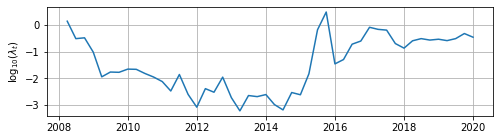

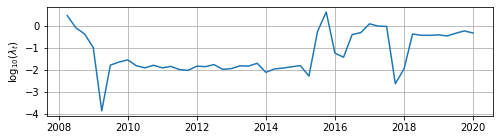

In [ ]:
esnSingle_A_agg_rw_highfreq_for_1sa_2007 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_highfreq_for_1sa_2007 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [ ]:
def esnMulti_rw_fit_highfreq_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_hf_rw = []
    target_hf_rw = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[j+1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[-1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_hf_rw.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_rw.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_rw = pd.concat(forecast_hf_rw)
    target_hf_rw = pd.concat(target_hf_rw)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_rw_forecast": forecast_hf_rw, "hf_target": target_hf_rw}

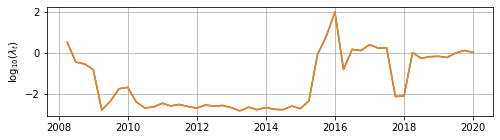

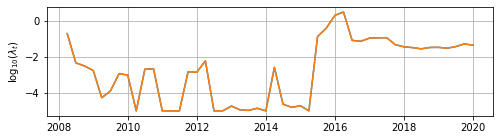

In [ ]:
esnMulti_A_rw_highfreq_for_1sa_2007 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_rw_highfreq_for_1sa_2007 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

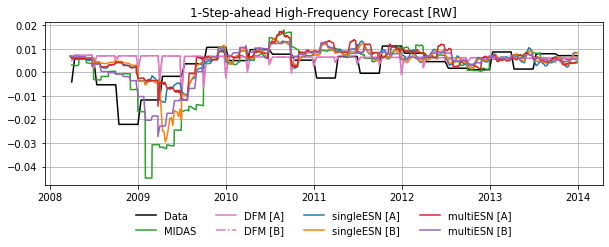

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_rw_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

#### Multi-step Point Forecast

##### Fixed Parameters

In [106]:
DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_fix_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_fixed__2007', steps=8, date_slice=DFM_slice_2007,
)

In [107]:
def UnMean_fix_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        forecast_fix_multistep[:,s] = np.ones(len(GDP_test_dates)) * GDP_data_train.mean().to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [108]:
UnMean_fix_multistep_for_2007 = UnMean_fix_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [109]:
def lowfreqAR_fix_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )

    # Select AR oder
    # arOrder = ar_select_order(
    #     GDP_data_train.to_numpy(),
    #     maxlag=4,
    #     ic='bic',
    # )
    # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
    # print(arOrder.ar_lags)

    # Fix AR(1) model
    arOrder = 1

    # Fit AR model
    arModel = AutoReg(
        GDP_data_train,
        lags=arOrder,
        trend='c',
    )
    fit = arModel.fit()
    # print(fit.summary())

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in range(len(GDP_data_test)):
        forecast_fix_multistep[j,:] = fit.forecast(steps=steps).to_numpy()
        # print(fit.forecast())
        # print(GDP_data_test.iloc[[j],:])
        # Append next datapoint
        fit = fit.append(GDP_data_test.iloc[[j],:])

    forecast_fix_multistep = forecast_fix_multistep * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [110]:
lowfreqAR_fix_multistep_for_2007 = lowfreqAR_fix_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [111]:
# NOTE: this optimization is currently too expensive (high-frequency 
#       model estimation). Do it on cluster, load results.
#
#MIDAS_fit_multisa_2007 = MIDAS_model.fixedparamsForecast(
#    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
#    fit_length=len(dataset2007['GDP_data_train']),
#    steps=1,
#    grad=False,
#    #method='L-BFGS-B',
#    debug=True
#)

import pickle

MIDAS_fix_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_2ff621952c__MIDAS_fix_multistep_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_fix_multistep_for_2007 = pickle.load(file)

In [112]:
def esnSingle_fix_fit_multistep(esnModel, Lambda, steps, data, direct=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=True,
        debug=False,
        steps=(steps if direct else 1)
    )

    if direct:
        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),
            fit=esnSingle_fit,
        )
    else:
        esnSingle_for = esnModel.multistepForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),
            fit=esnSingle_fit,
            steps=steps
        )

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        if direct:
            forecast_fix_multistep[:,s] = np.squeeze(esnSingle_for['Forecast'][s]['Y_for'].to_numpy())
        else:
            forecast_fix_multistep[:,s] = np.squeeze(esnSingle_for['multistepForecast'][s]['Y_for'].to_numpy())

    forecast_fix_multistep = forecast_fix_multistep * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [113]:
esnSingle_A_agg_fix_multistep_for_2007 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    aggregate=True,
)

In [114]:
esnSingle_B_agg_fix_multistep_for_2007 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    aggregate=True,
)

In [115]:
def esnMulti_fix_fit_multistep(esnModel, Lambda, steps, data, direct=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train),
        method='ridge',
        Lambda=Lambda,
        full=True,
        debug=False,
        steps=(steps if direct else 1)
    )

    if direct:
        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),
            fit=esnMulti_fit,
        )
    else:
        esnMulti_for = esnModel.multistepForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),
            fit=esnMulti_fit,
            steps=steps
        )

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        if direct:
            forecast_fix_multistep[:,s] = np.squeeze(esnMulti_for['Forecast'][s]['Y_for'].to_numpy())
        else:
            forecast_fix_multistep[:,s] = np.squeeze(esnMulti_for['multistepForecast'][s]['Y_for'].to_numpy())

    forecast_fix_multistep = forecast_fix_multistep * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [116]:
esnMulti_A_fix_multistep_for_2007 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
)

In [117]:
esnMulti_B_fix_multistep_for_2007 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
)

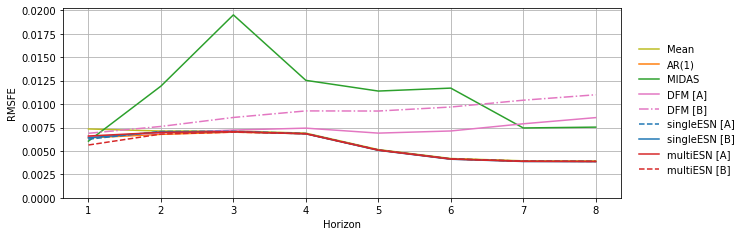

In [118]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_fix_multistep_for_2007), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2007(lowfreqAR_fix_multistep_for_2007), label="AR(1)", c="C1") 
plt.plot(hStepRMSFE_2007(MIDAS_fix_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_fix_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_fix_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_fix_multistep_for_2007), label="singleESN [A]", c="C0", ls='--') 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_fix_multistep_for_2007), label="singleESN [B]", c="C0") 
#
plt.plot(hStepRMSFE_2007(esnMulti_A_fix_multistep_for_2007), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2007(esnMulti_B_fix_multistep_for_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast RMSFE  ─  Fixed Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_fix_2007.pdf'), bbox_inches="tight")
plt.show()

In [119]:
table_RMSFE_multistep_fix_2007 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_fix_2007.index.name = "FIX_2007"
table_RMSFE_multistep_fix_2007["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_fix = hStepRMSFE_2007(UnMean_fix_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_fix_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(lowfreqAR_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(MIDAS_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(DFM_A_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(DFM_B_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnSingle_A_agg_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnSingle_B_agg_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnMulti_A_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnMulti_B_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
    ]

table_RMSFE_multistep_fix_2007.round(3)

,Model,1,2,3,4,5,6,7,8
FIX_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,AR(1),0.870,0.950,0.982,0.991,0.992,0.991,0.992,0.992
3,MIDAS,0.823,1.672,2.737,1.816,2.213,2.791,1.888,1.921
4,DFM [A],0.890,0.969,1.014,1.077,1.341,1.701,2.001,2.180
5,DFM [B],0.937,1.069,1.202,1.344,1.799,2.310,2.638,2.801
6,singleESN [A],0.852,0.994,0.995,0.995,0.993,0.991,0.991,0.991
7,singleESN [B],0.871,0.986,0.989,0.989,0.985,0.981,0.981,0.981
8,multiESN [A],0.898,0.980,0.990,0.991,0.988,0.985,0.985,0.985
9,multiESN [B],0.767,0.954,0.983,0.991,0.991,0.990,0.991,0.991


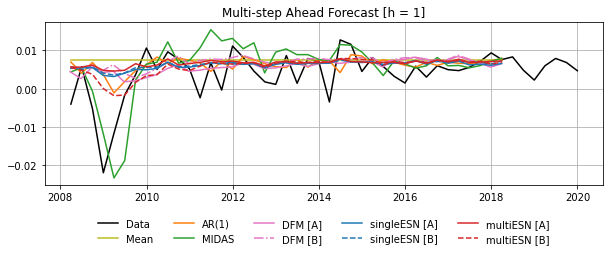

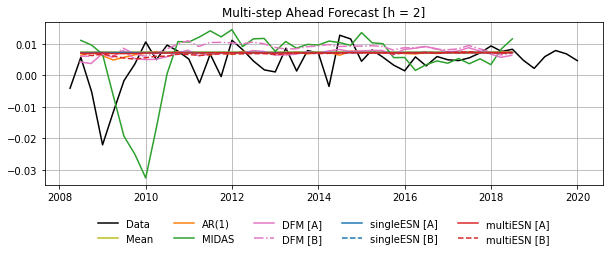

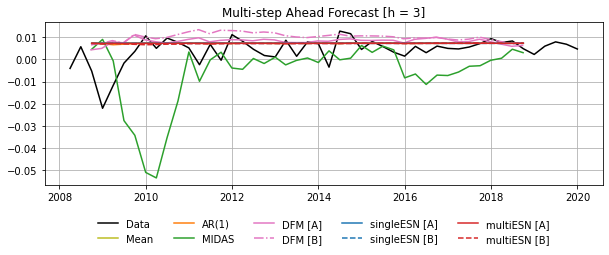

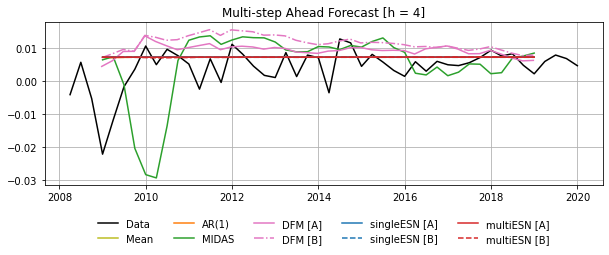

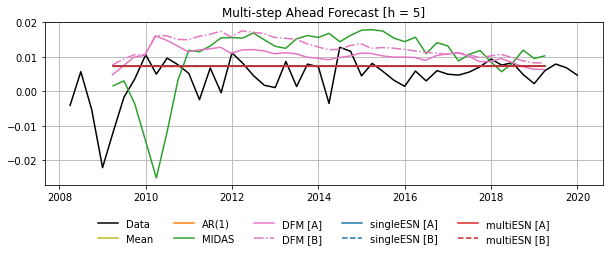

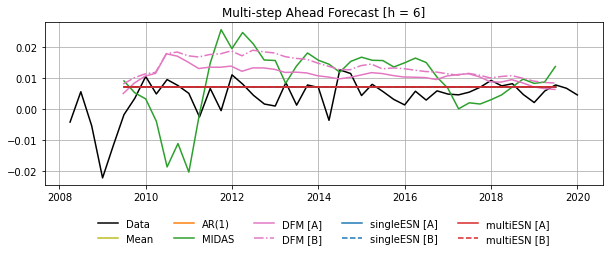

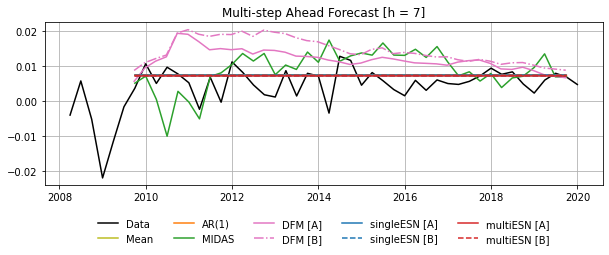

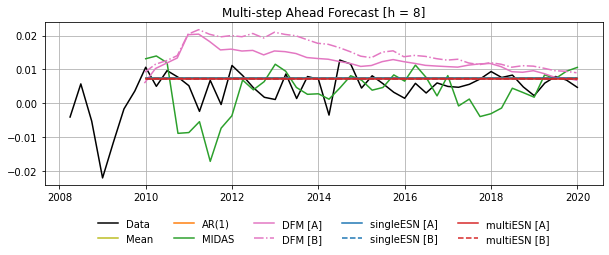

In [120]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8") 
    #
    plt.plot(lowfreqAR_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1") 
    plt.plot(MIDAS_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [121]:
mhmcs_steps = 8
mhmcs_multistep_fix_2007 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_fix_2007[h, :, :] = (
        np.c_[
            UnMean_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [122]:
if saveR:
    mhmcs_multistep_fix_2007_df = mhmcs_multistep_fix_2007.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_fix_2007_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_fix_2007.csv")
    )

Horizon-specific MCS:

In [123]:
# for h in range(8):
#     mcs_multistep_2007_h = pd.DataFrame(
#         np.c_[UnMean_fix_multistep_for_2007[h],
#             lowfreqAR_fix_multistep_for_2007[h],
#             MIDAS_fix_multistep_for_2007[h],
#             DFM_A_fix_multistep_for_2007[h],
#             DFM_B_fix_multistep_for_2007[h],
#             esnSingle_A_agg_fix_multistep_for_2007[h],
#             esnSingle_B_agg_fix_multistep_for_2007[h],
#             esnMulti_A_fix_multistep_for_2007[h],
#             esnMulti_B_fix_multistep_for_2007[h],
#         ],
#         columns=['Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
#                     'singleESN [A]', 'singleESN [B]', 
#                     'multiESN [A]', 'multiESN [B]']
#     )
#     mcs_multistep_2007_h = np.square((mcs_multistep_2007_h - dataset2007['GDP_data_test'].to_numpy()))

#     mcs_25_multistep_2007_h = (
#         ModelConfidenceSet(data=mcs_multistep_2007_h, alpha=0.25, B=10000, w=2, algorithm='R').run()
#     )
#     mcs_10_multistep_2007_h = (
#         ModelConfidenceSet(data=mcs_multistep_2007_h, alpha=0.10, B=10000, w=2, algorithm='R').run()
#     )

#     print(f"h = {h+1} -------------------------------------------")
#     print(f"MCS 25 included: {mcs_25_multistep_2007_h.included}")
#     print(f"MCS 10 included: {mcs_10_multistep_2007_h.included}")
#     print(" ")

In [124]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Expanding Window

In [125]:
DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_ew_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_expanding__2007', steps=8, date_slice=DFM_slice_2007,
)

In [126]:
def UnMean_ew_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        for_j = np.zeros(steps)
        T_train = len(GDP_data_train_j)
        for s in range(steps):
            for_j[s] = GDP_data_train_j.iloc[:(T_train-s),:].mean().iloc[0]

        forecast_ew_multistep[j,:] = for_j

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

In [127]:
UnMean_ew_multistep_for_2007 = UnMean_ew_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [128]:
def lowfreqAR_ew_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    forecast_ew_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
        else:
            GDP_data_train_j = GDP_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )

        # Select AR oder
        # arOrder = ar_select_order(
        #     GDP_data_train_j.to_numpy(),
        #     maxlag=4,
        #     ic='bic',
        # )
        # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
        # print(arOrder.ar_lags)

        # Fix AR(1) model
        arOrder = 1

        # Fit AR model
        arModel = AutoReg(
            GDP_data_train_j,
            lags=arOrder,
            trend='c',
        )
        fit = arModel.fit()

        for_j = fit.forecast(steps=steps).to_numpy()

        forecast_ew_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

In [129]:
lowfreqAR_ew_multistep_for_2007 = lowfreqAR_ew_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [130]:
import pickle

MIDAS_ew_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_5c70cf6033__MIDAS_ew_multistep_for_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_ew_multistep_for_2007 = pickle.load(file)

In [131]:
def esnSingle_ew_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_ew_multistep = np.zeros((len(GDP_test_dates), steps))
    W_list = []
    L_list = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnSingle_fit['fit_for'][0]['W'])
        L_list.append(np.max(np.abs(np.linalg.eig(
            esnModel.models_[0].A_ + esnModel.models_[0].C_ @ 
                esnSingle_fit['fit_comp_ar'][0][1:,:].T
        )[0])))

        if direct:
            esnSingle_for = esnModel.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
            )
        else:
            esnSingle_for = esnModel.multistepForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnSingle_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnSingle_for['multistepForecast'][s]['Y_for'][0]

        forecast_ew_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    _, axs = plt.subplots(1, 2, figsize=(8,2))
    axs[0].plot(np.array([np.linalg.norm(w) for w in W_list]), c="C0")
    axs[0].grid()
    axs[0].set_title("||W||")
    axs[1].plot(np.array(L_list), c="C1")
    axs[1].grid()
    axs[1].set_title("\lambda_1(A + CW')")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

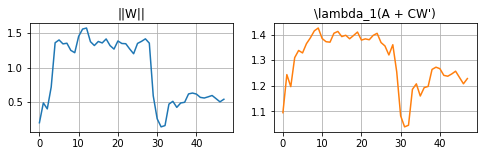

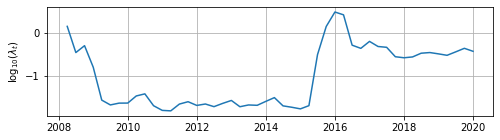

In [132]:
# Aggregated
esnSingle_A_agg_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

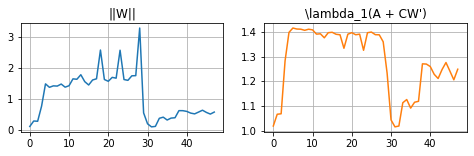

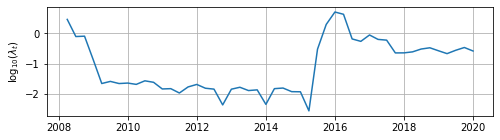

In [133]:
esnSingle_B_agg_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

In [134]:
def esnMulti_ew_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_ew_multistep = np.zeros((len(GDP_data_test), steps))
    W_list = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j),
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnMulti_fit['fit_for'][0]['W'])

        if direct:
            esnMulti_for = esnModel.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
            )
        else:
            esnMulti_for = esnModel.multistepForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnMulti_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnMulti_for['multistepForecast'][s]['Y_for'][0]

        forecast_ew_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    plt.figure(figsize=(8,2))
    plt.plot(np.array([np.linalg.norm(w) for w in W_list]))
    plt.grid()
    plt.title("||W||")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

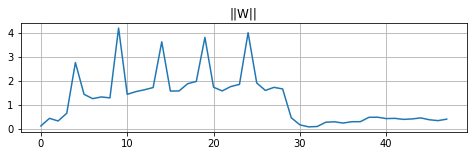

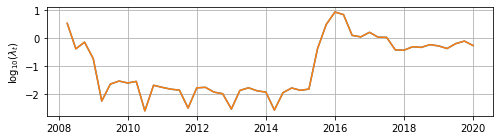

In [135]:
esnMulti_A_ew_multistep_for_2007 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

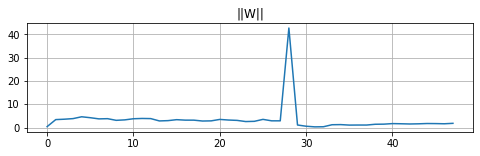

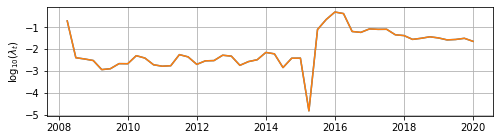

In [136]:
esnMulti_B_ew_multistep_for_2007 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

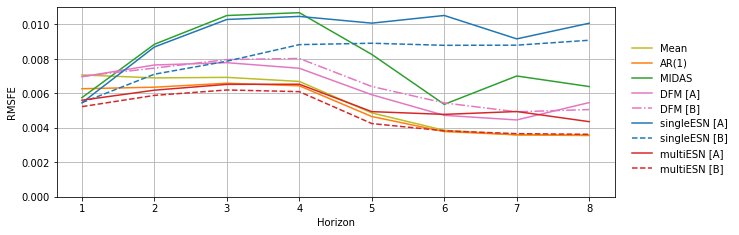

In [137]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_ew_multistep_for_2007), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2007(lowfreqAR_ew_multistep_for_2007), label="AR(1)", c="C1") 
plt.plot(hStepRMSFE_2007(MIDAS_ew_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_ew_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_ew_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_ew_multistep_for_2007), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_ew_multistep_for_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(hStepRMSFE_2007(esnMulti_A_ew_multistep_for_2007), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2007(esnMulti_B_ew_multistep_for_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast  ─  Expanding Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [138]:
table_RMSFE_multistep_ew_2007 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_ew_2007.index.name = "EW_2007"
table_RMSFE_multistep_ew_2007["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_ew = hStepRMSFE_2007(UnMean_ew_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_ew_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(lowfreqAR_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(MIDAS_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(DFM_A_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(DFM_B_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnSingle_A_agg_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnSingle_B_agg_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnMulti_A_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnMulti_B_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
    ]

table_RMSFE_multistep_ew_2007.round(3)

,Model,1,2,3,4,5,6,7,8
EW_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,AR(1),0.887,0.922,0.951,0.962,0.957,0.981,1.001,1.008
3,MIDAS,0.814,1.283,1.518,1.596,1.697,1.391,1.951,1.800
4,DFM [A],0.985,1.109,1.123,1.114,1.217,1.226,1.241,1.539
5,DFM [B],0.989,1.082,1.149,1.199,1.315,1.412,1.373,1.425
6,singleESN [A],0.771,1.260,1.485,1.564,2.070,2.728,2.550,2.834
7,singleESN [B],0.772,1.031,1.135,1.319,1.831,2.279,2.449,2.556
8,multiESN [A],0.792,0.897,0.941,0.976,1.015,1.240,1.377,1.227
9,multiESN [B],0.740,0.853,0.894,0.911,0.873,0.993,1.020,1.020


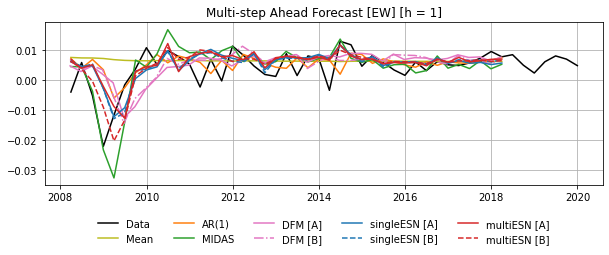

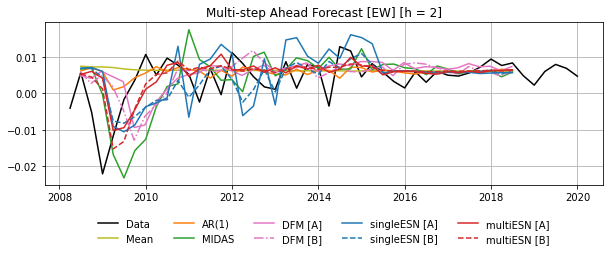

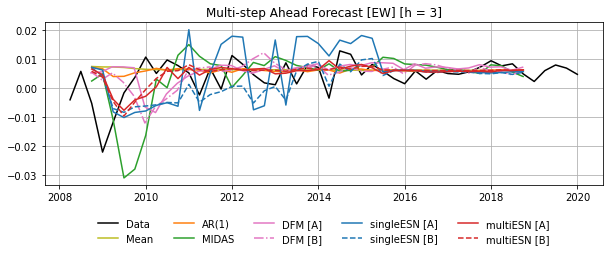

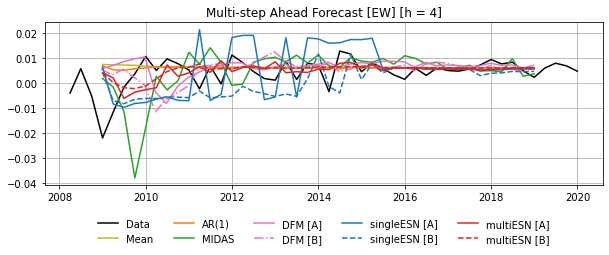

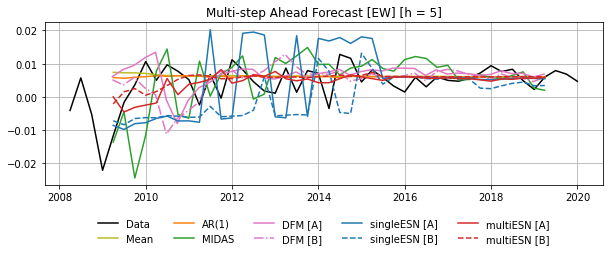

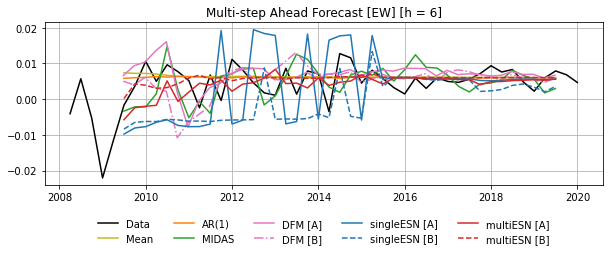

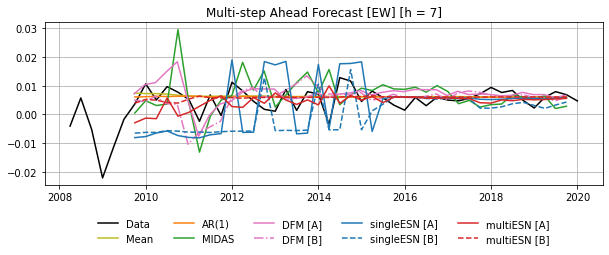

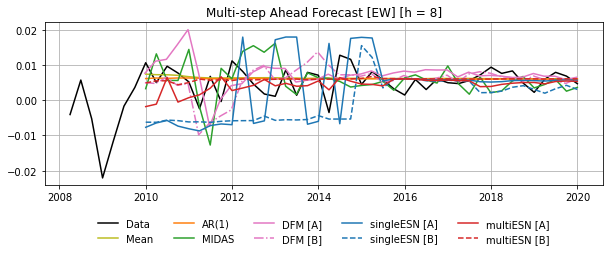

In [139]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8") 
    plt.plot(lowfreqAR_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1")
    #
    plt.plot(MIDAS_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [EW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [140]:
mhmcs_steps = 8
mhmcs_multistep_ew_2007 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_ew_2007[h, :, :] = (
        np.c_[
            UnMean_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [141]:
if saveR:
    mhmcs_multistep_ew_2007_df = mhmcs_multistep_ew_2007.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_ew_2007_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_ew_2007.csv")
    )

In [142]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Rolling Window

In [143]:
DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_window__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_rw_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_window__2007', steps=8, date_slice=DFM_slice_2007,
)

In [144]:
def UnMean_rw_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_rw_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
        else:
            GDP_data_train_j = GDP_data_train

        for_j = np.zeros(steps)
        T_train = len(GDP_data_train_j)
        for s in range(steps):
            js_idx = np.max((0,(j-s))) if j > 0 else 0
            for_j[s] = GDP_data_train_j.iloc[js_idx:(T_train-s),:].mean().iloc[0]

        forecast_rw_multistep[j,:] = for_j

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

In [145]:
UnMean_rw_multistep_for_2007 = UnMean_rw_fit_multistep(
    data=dataset2007,
    steps=8
)

In [146]:
def lowfreqAR_rw_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train'].asfreq('Q-DEC')
    GDP_data_test = data['GDP_data_test'].asfreq('Q-DEC')

    GDP_test_dates = GDP_data_test.index

    forecast_rw_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
        else:
            GDP_data_train_j = GDP_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )

        # Select AR oder
        # arOrder = ar_select_order(
        #     GDP_data_train_j.to_numpy(),
        #     maxlag=4,
        #     ic='bic',
        # )
        # arOrder = 1 if arOrder.ar_lags is None else max(arOrder.ar_lags)
        # print(arOrder.ar_lags)

        # Fix AR(1) model
        arOrder = 1

        # Fit AR model
        arModel = AutoReg(
            GDP_data_train_j,
            lags=arOrder,
            trend='c',
        )
        fit = arModel.fit()

        for_j = fit.forecast(steps=steps).to_numpy()

        forecast_rw_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

In [147]:
lowfreqAR_rw_multistep_for_2007 = lowfreqAR_rw_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [148]:
import pickle

MIDAS_rw_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_381d93060c__MIDAS_rw_multistep_for_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_rw_multistep_for_2007 = pickle.load(file)

In [149]:
def esnSingle_rw_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_rw_multistep = np.zeros((len(GDP_test_dates), steps))
    W_list = []
    L_list = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnSingle_fit['fit_for'][0]['W'])
        L_list.append(np.max(np.abs(np.linalg.eig(
            esnModel.models_[0].A_ + esnModel.models_[0].C_ @ 
                esnSingle_fit['fit_comp_ar'][0][1:,:].T
        )[0])))

        if direct:
            esnSingle_for = esnModel.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
            )
        else:
            esnSingle_for = esnModel.multistepForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnSingle_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnSingle_for['multistepForecast'][s]['Y_for'][0]

        forecast_rw_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    _, axs = plt.subplots(1, 2, figsize=(8,2))
    axs[0].plot(np.array([np.linalg.norm(w) for w in W_list]), c="C0")
    axs[0].grid()
    axs[0].set_title("||W||")
    axs[1].plot(np.array(L_list), c="C1")
    axs[1].grid()
    axs[1].set_title("\lambda_1(A + CW')")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

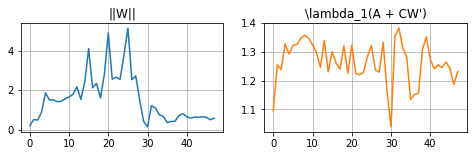

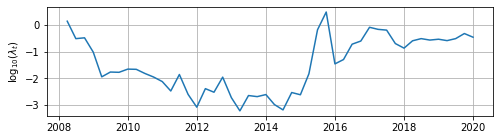

In [150]:
esnSingle_A_agg_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

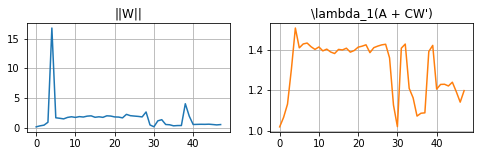

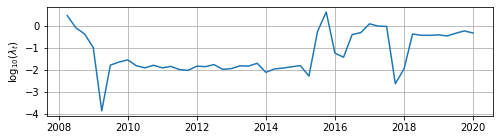

In [151]:
esnSingle_B_agg_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

In [152]:
def esnMulti_rw_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_rw_multistep = np.zeros((len(GDP_data_test), steps))
    W_list = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j),
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnMulti_fit['fit_for'][0]['W'])

        if direct:
            esnMulti_for = esnModel.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
            )
        else:
            esnMulti_for = esnModel.multistepForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnMulti_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnMulti_for['multistepForecast'][s]['Y_for'][0]

        forecast_rw_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    plt.figure(figsize=(8,2))
    plt.plot(np.array([np.linalg.norm(w) for w in W_list]))
    plt.grid()
    plt.title("||W||")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

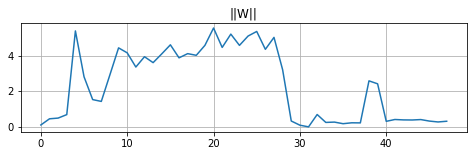

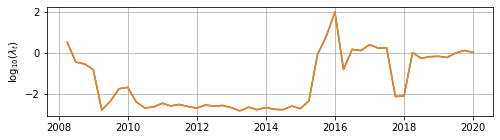

In [153]:
esnMulti_A_rw_multistep_for_2007 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

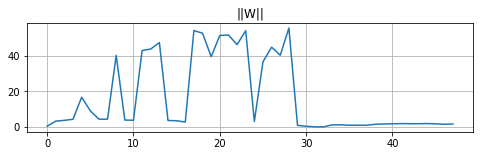

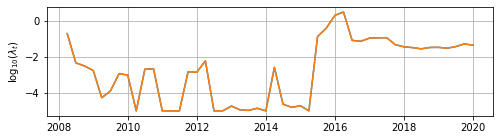

In [154]:
esnMulti_B_rw_multistep_for_2007 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

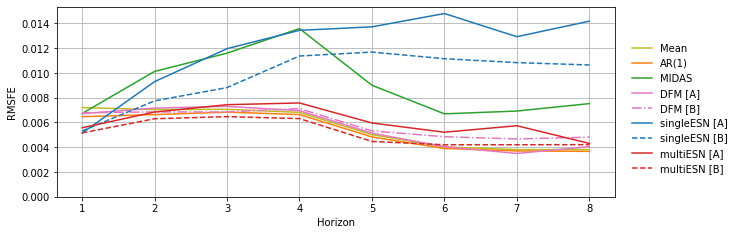

In [155]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_rw_multistep_for_2007), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2007(lowfreqAR_rw_multistep_for_2007), label="AR(1)", c="C1") 
plt.plot(hStepRMSFE_2007(MIDAS_rw_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_rw_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_rw_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_rw_multistep_for_2007), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_rw_multistep_for_2007), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(hStepRMSFE_2007(esnMulti_A_rw_multistep_for_2007), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2007(esnMulti_B_rw_multistep_for_2007), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast  ─  Rolling Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [156]:
table_RMSFE_multistep_rw_2007 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_rw_2007.index.name = "RW_2007"
table_RMSFE_multistep_rw_2007["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_rw = hStepRMSFE_2007(UnMean_rw_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_rw_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(lowfreqAR_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(MIDAS_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(DFM_A_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(DFM_B_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnSingle_A_agg_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnSingle_B_agg_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnMulti_A_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnMulti_B_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
    ]

table_RMSFE_multistep_rw_2007.round(3)

,Model,1,2,3,4,5,6,7,8
RW_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,AR(1),0.898,0.943,0.968,0.974,0.963,0.968,0.970,0.962
3,MIDAS,0.933,1.438,1.642,1.993,1.794,1.661,1.816,1.973
4,DFM [A],0.931,1.017,1.033,1.020,1.024,1.003,0.918,1.062
5,DFM [B],0.942,0.973,0.970,1.045,1.059,1.203,1.225,1.263
6,singleESN [A],0.714,1.320,1.693,1.972,2.733,3.669,3.391,3.719
7,singleESN [B],0.737,1.100,1.248,1.667,2.327,2.765,2.842,2.792
8,multiESN [A],0.773,0.972,1.053,1.111,1.187,1.293,1.505,1.131
9,multiESN [B],0.716,0.895,0.916,0.926,0.890,1.041,1.102,1.105


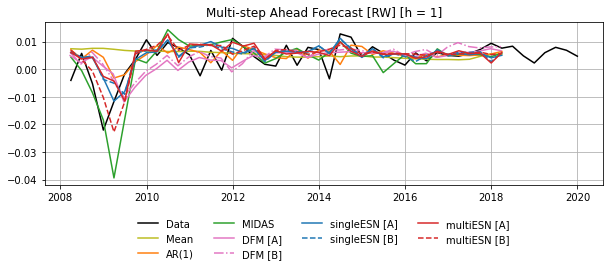

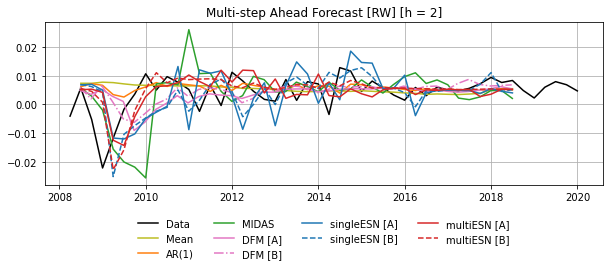

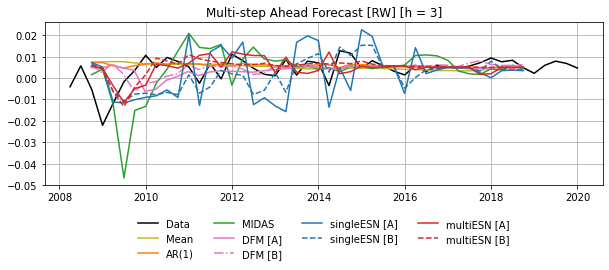

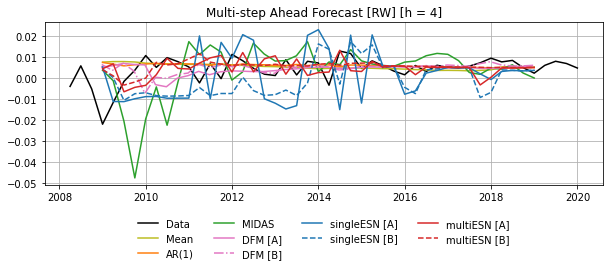

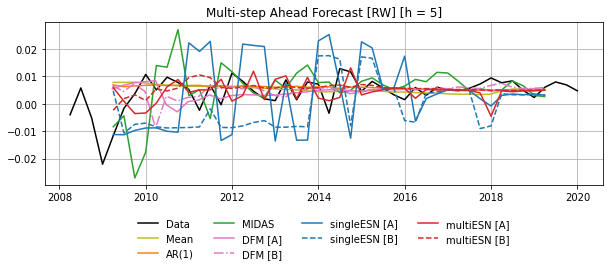

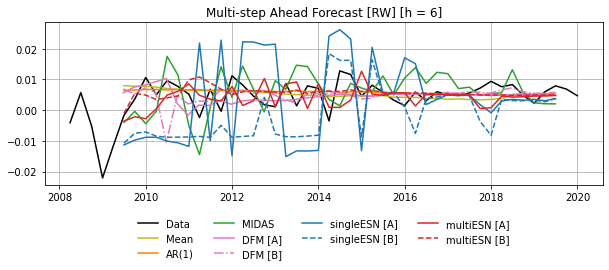

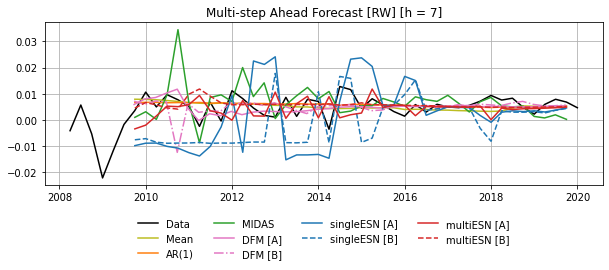

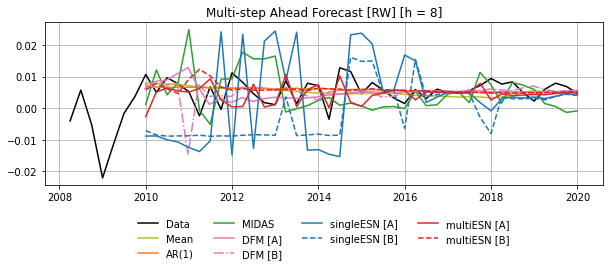

In [157]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8") 
    #
    plt.plot(lowfreqAR_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1")
    plt.plot(MIDAS_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [RW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=4)
    plt.show()

Export multi-horizon losses:

In [158]:
mhmcs_steps = 8
mhmcs_multistep_rw_2007 = xr.DataArray(
     data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_rw_2007[h, :, :] = (
        np.c_[
            UnMean_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [159]:
if saveR:
    mhmcs_multistep_rw_2007_df = mhmcs_multistep_rw_2007.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_rw_2007_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_rw_2007.csv")
    )

In [160]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


### Post-Crisis Model Evaluation

##### Data

In [161]:
dataset2011 = getSmallDatasets('2011-12-31')

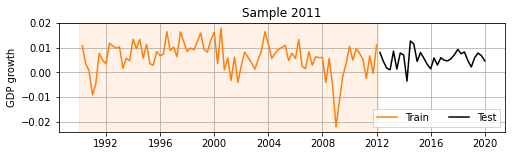

In [162]:
plt.figure(figsize=(8,2))
plt.axvspan(pd.to_datetime("01-01-1990"), pd.to_datetime("01-31-2012"),
                color="C1", alpha=0.1)
plt.plot(dataset2011['GDP_data_train'], label="Train", color="C1")
plt.plot(dataset2011['GDP_data_test'], color="black", label="Test")
plt.ylabel("GDP growth")
plt.grid()
plt.legend(loc="lower right", fancybox=False, shadow=False, ncol=2)
plt.title("Sample 2011")
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_train_sample_2011.pdf'), bbox_inches="tight")
plt.show()

[MFESN ONLY] Get 'extended' dataset to have enough CV data:

In [163]:
dataset2011_ext = getSmallDatasets_extended(
    '1975-01-01', '2019-12-31', trainTestSplitDate='2011-12-31'
)

#### 1-step Ahead Point Forecast Comparison

##### Fixed Parameters

In [164]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', date_slice=DFM_slice_2011,
)

DFM_B_fix_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2011', date_slice=DFM_slice_2011,
)

In [165]:
UnMean_fix_for_1sa_2011 = uncondMean_1sa_fixParamsForecast(
    data=dataset2011,
)

                            AutoReg Model Results                             
Dep. Variable:                     Q1   No. Observations:                   88
Model:                     AutoReg(1)   Log Likelihood                -113.575
Method:               Conditional MLE   S.D. of innovations              0.893
Date:                Mon, 05 Jun 2023   AIC                            233.150
Time:                        13:58:50   BIC                            240.547
Sample:                    06-30-1990   HQIC                           236.128
                         - 12-31-2011                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0043      0.096     -0.045      0.964      -0.192       0.183
Q1.L1          0.4454      0.096      4.638      0.000       0.257       0.634
                                    Roots           

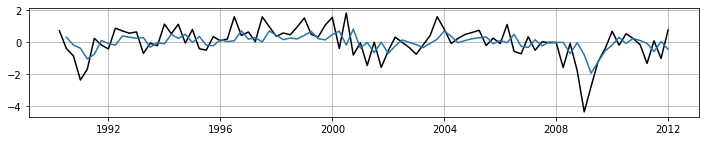

In [166]:
lowfreqAR_fix_for_1sa_2011 = lowfreqAR_1sa_fixParamsForecast(
    data=dataset2011,
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

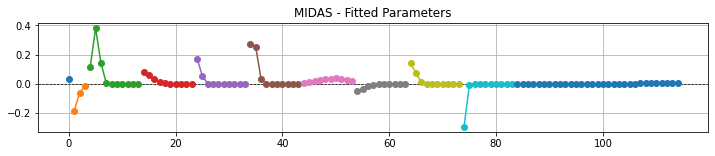

In [167]:
MIDAS_fix_for_1sa_2011 = MIDAS_fix_fit_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


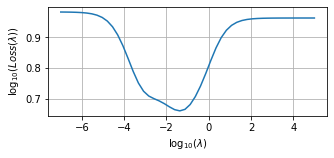

+ s = 0 --------------------
Best solution found:
lambda = [0.04286684]
F      = 4.589083633826376


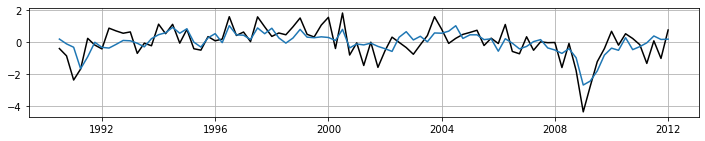

In [168]:
# Aggregated
esnSingle_A_agg_cv10_lambda_2011 = esnSingle_A.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnSingle_A_agg_fix_for_1sa_2011 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    #Lambda=[1e-2,],
    data=dataset2011,
    aggregate=True,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


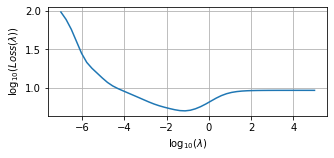

+ s = 0 --------------------
Best solution found:
lambda = [0.06804393]
F      = 4.940154024836524


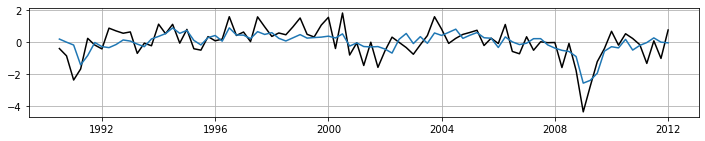

In [169]:
esnSingle_B_agg_cv10_lambda_2011 = esnSingle_B.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnSingle_B_agg_fix_for_1sa_2011 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    #Lambda=[1e-2,],
    data=dataset2011,
    aggregate=True,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


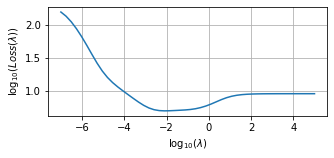

+ s = 0 --------------------
Best solution found:
lambda = [0.00839454]
F      = 5.06864339637799


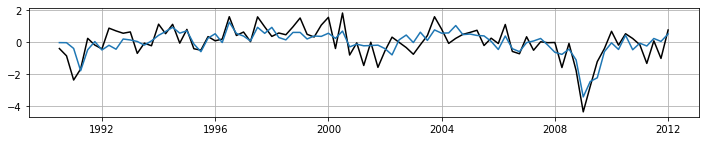

In [170]:
esnMulti_A_cv10_lambda_2011 = esnMulti_A.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_data_train'], 
    z=(dataset2011_ext['m_data_train'], dataset2011_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

esnMulti_A_fix_for_1sa_2011 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    #Lambda=[1e-2, 1e-2],
    data=dataset2011,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


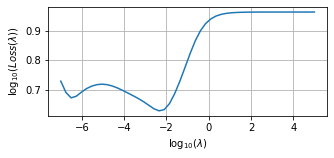

+ s = 0 --------------------
Best solution found:
lambda = [0.00503101]
F      = 4.257986356045738


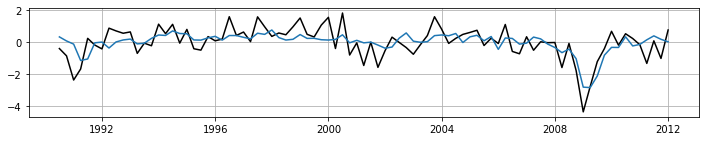

In [171]:
esnMulti_B_cv10_lambda_2011 = esnMulti_B.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_data_train'], 
    z=(dataset2011_ext['m_data_train'], dataset2011_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    #cv_options="-cv_min_split_size:70-cv_max_split_size:70-test_size:1",
    steps=1,
    Lambda0=1e-2,
    debug=True,
)

esnMulti_B_fix_for_1sa_2011 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
)

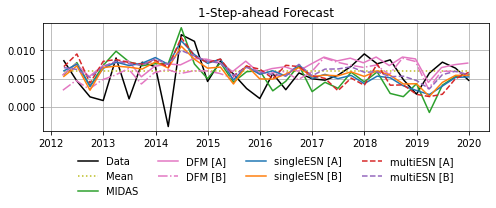

In [172]:
# Plot
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_fix_for_1sa_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_fix_for_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_fix_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_2011.pdf'), bbox_inches="tight")
plt.show()

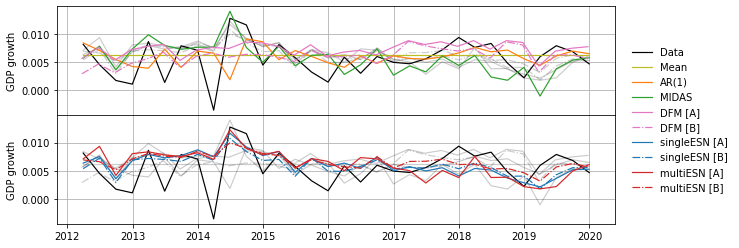

In [173]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2011['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_fix_for_1sa_2011, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_fix_for_1sa_2011, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_fix_for_1sa_2011, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_fix_for_1sa_2011, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_fix_for_1sa_2011, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_fix_for_1sa_2011, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_fix_for_1sa_2011, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_fix_forecast_2011, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_fix_forecast_2011, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2011['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_fix_for_1sa_2011, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_fix_for_1sa_2011, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_fix_for_1sa_2011, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_fix_forecast_2011, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_fix_forecast_2011, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_fix_for_1sa_2011, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_fix_for_1sa_2011, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_fix_for_1sa_2011, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_fix_for_1sa_2011, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Fixed Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_fix_2011.pdf'), bbox_inches="tight")
plt.show()

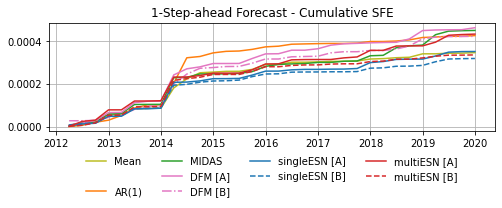

In [174]:
cumulSFE_2011 = lambda forecast : np.cumsum(np.square(dataset2011['GDP_data_test'] - forecast.to_numpy()))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_fix_for_1sa_2011), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2011(lowfreqAR_fix_for_1sa_2011), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_fix_2011.pdf'), bbox_inches="tight")
plt.show()

In [175]:
def MSFE_2011(forecast, startDate=None):
    if not startDate is None:
        startDate = pd.to_datetime(startDate)
        msfe = np.mean(np.square(
                dataset2011['GDP_data_test'].loc[startDate:,].to_numpy() - 
                    forecast.loc[startDate:,].to_numpy()
            ))
    else:
        msfe = np.mean(np.square(
                dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy()
            ))
    return msfe

UnMean_MSE_fix_2011_td = MSFE_2011(UnMean_fix_for_1sa_2011) * 1e4
lowfreqAR_MSE_fix_2011_td = MSFE_2011(lowfreqAR_fix_for_1sa_2011) * 1e4
MIDAS_MSE_fix_2011_td = MSFE_2011(MIDAS_fix_for_1sa_2011) * 1e4
DFM_A_MSE_fix_2011_td = MSFE_2011(DFM_A_fix_forecast_2011) * 1e4
DMF_B_MSE_fix_2011_td = MSFE_2011(DFM_B_fix_forecast_2011) * 1e4
esnSingle_A_MSE_fix_2011_td = MSFE_2011(esnSingle_A_agg_fix_for_1sa_2011) * 1e4
esnSingle_B_MSE_fix_2011_td = MSFE_2011(esnSingle_B_agg_fix_for_1sa_2011) * 1e4
esnMulti_A_MSE_fix_2011_td = MSFE_2011(esnMulti_A_fix_for_1sa_2011) * 1e4
esnMulti_B_MSE_fix_2011_td = MSFE_2011(esnMulti_B_fix_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_fix_2011_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_fix_2011_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_fix_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_fix_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_fix_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_fix_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_fix_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_fix_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_fix_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_fix_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.1082 	|	0.3289
AR(1) 		 = 0.1331 	|	0.3648
MIDAS 		 = 0.1406 	|	0.375
DFM [A]		 = 0.1446 	|	0.3803
DFM [B]		 = 0.1321 	|	0.3634
singleESN [A]	 = 0.1098 	|	0.3314
singleESN [B]	 = 0.0996 	|	0.3156
multiESN [A]	 = 0.1353 	|	0.3678
multiESN [B]	 = 0.1048 	|	0.3238


In [176]:
ref_MSE_2011_fix = UnMean_MSE_fix_2011_td
lowfreqAR_MSE_toRef_2011_fix = lowfreqAR_MSE_fix_2011_td / ref_MSE_2011_fix
MIDAS_MSE_toRef_2011_fix = MIDAS_MSE_fix_2011_td / ref_MSE_2011_fix
DFM_A_MSE_toRef_2011_fix = DFM_A_MSE_fix_2011_td / ref_MSE_2011_fix
DMF_B_MSE_toRef_2011_fix = DMF_B_MSE_fix_2011_td / ref_MSE_2011_fix
esnSingle_A_MSE_toRef_2011_fix = esnSingle_A_MSE_fix_2011_td / ref_MSE_2011_fix
esnSingle_B_MSE_toRef_2011_fix = esnSingle_B_MSE_fix_2011_td / ref_MSE_2011_fix
esnMulti_A_MSE_toRef_2011_fix = esnMulti_A_MSE_fix_2011_td / ref_MSE_2011_fix
esnMulti_B_MSE_toRef_2011_fix = esnMulti_B_MSE_fix_2011_td / ref_MSE_2011_fix

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2011_fix.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_fix.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_fix.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_fix.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_fix.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_fix.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_fix.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_fix.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 1.2303
MIDAS 		 = 1.3
DFM [A]		 = 1.3369
DFM [B]		 = 1.2207
singleESN [A]	 = 1.0151
singleESN [B]	 = 0.9206
multiESN [A]	 = 1.2504
multiESN [B]	 = 0.969


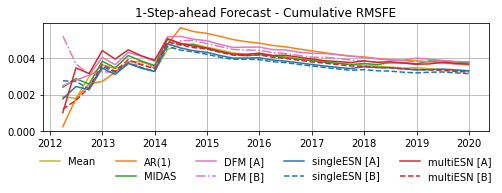

In [177]:
def cumulRMSFE_2011(forecast):
    cumulSFE = np.cumsum(np.square(dataset2011['GDP_data_test'] - forecast.to_numpy()))
    return np.sqrt(cumulSFE / np.reshape(np.arange(1, len(forecast)+1), (-1, 1)))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_fix_for_1sa_2011), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2011(lowfreqAR_fix_for_1sa_2011), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_fix_2011.pdf'), bbox_inches="tight")
plt.show()

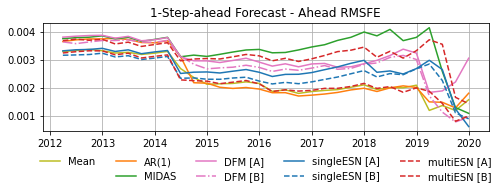

In [178]:
def aheadRMSFE_2011(forecast):
    fSFE = np.flip(np.square(dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy()))
    aheadSFE = np.sqrt(np.cumsum(fSFE) / np.arange(1, len(forecast)+1))
    return pd.DataFrame(data=np.flip(aheadSFE), index=dataset2011['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_fix_for_1sa_2011), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2011(lowfreqAR_fix_for_1sa_2011), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_fix_2011.pdf'), bbox_inches="tight")
plt.show()

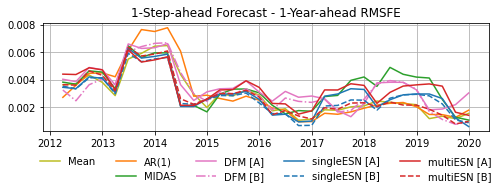

In [179]:
def YA_RMSFE_2011(forecast):
    SFE = np.square(dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy())
    T = len(SFE)
    YA_RMSFE = np.array(
        [np.sqrt(np.mean(SFE[j:min(j+4,T)])) for j in range(T)]
    )
    return pd.DataFrame(data=YA_RMSFE, index=dataset2011['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_fix_for_1sa_2011), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2011(lowfreqAR_fix_for_1sa_2011), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(YA_RMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_fix_2011.pdf'), bbox_inches="tight")
plt.show()

In [180]:
mcs_data_2011_fix = pd.DataFrame(
    np.c_[UnMean_fix_for_1sa_2011,
        lowfreqAR_fix_for_1sa_2011,
        MIDAS_fix_for_1sa_2011, 
        DFM_A_fix_forecast_2011,
        DFM_B_fix_forecast_2011,
        esnSingle_A_agg_fix_for_1sa_2011,
        esnSingle_B_agg_fix_for_1sa_2011,
        esnMulti_A_fix_for_1sa_2011,
        esnMulti_B_fix_for_1sa_2011,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']
)
mcs_data_2011_fix = (mcs_data_2011_fix - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2011_fix), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2011_fix), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_fix.included}")
print(f"MCS 10 included: {mcs_10_2011_fix.included}")

MCS 25 included: ['DFM [B]', 'AR(1)', 'singleESN [A]', 'Mean', 'multiESN [B]', 'singleESN [B]']
MCS 10 included: ['DFM [B]', 'AR(1)', 'singleESN [A]', 'Mean', 'multiESN [B]', 'singleESN [B]']


In [181]:
mcs_25_2011_fix.pvalues

DFM [A]          0.0192
MIDAS            0.0192
multiESN [A]     0.0192
DFM [B]          0.4076
AR(1)            0.4076
singleESN [A]    0.4076
Mean             0.8168
multiESN [B]     0.8168
singleESN [B]    1.0000
dtype: float64

In [182]:
if saveR:
    mcs_data_2011_fix.to_csv(
        os.path.join(path_folder, "R", "mcs_small_fix_2011.csv")
    )

In [183]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Expanding Window

In [184]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', date_slice=DFM_slice_2011,
)

DFM_B_ew_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2011', date_slice=DFM_slice_2011,
)

In [185]:
UnMean_ew_1sa_forecast_2011 = uncondMean_ew_1sa_Forecast(
    data=dataset2011,
)

In [186]:
lowfreqAR_ew_1sa_forecast_2011 = lowfreqAR_ew_1sa_Forecast(
    data=dataset2011,
)

In [187]:
%%capture
MIDAS_ew_1sa_forecast_2011 = MIDAS_ew_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2011,
)

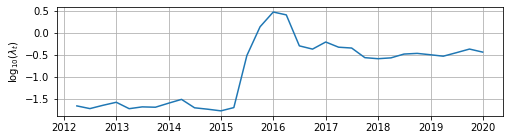

In [188]:
esnSingle_A_agg_ew_for_1sa_2011 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

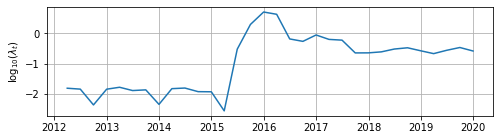

In [189]:
esnSingle_B_agg_ew_for_1sa_2011 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

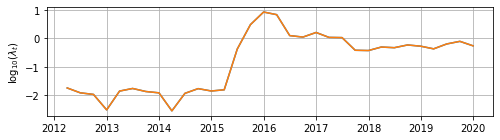

In [190]:
esnMulti_A_ew_for_1sa_2011 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

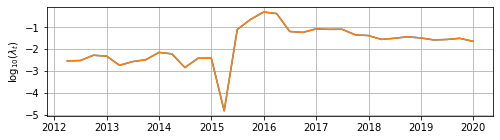

In [191]:
esnMulti_B_ew_for_1sa_2011 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

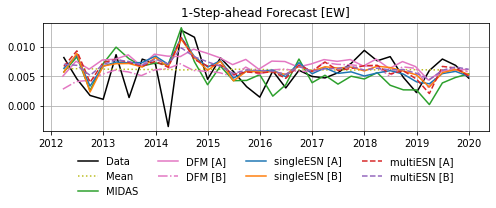

In [192]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_ew_1sa_forecast_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_ew_1sa_forecast_2011, label="MIDAS", c="C2", ls='-') 
#
plt.plot(DFM_A_ew_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_forecast_2011, label="DFM [B]", c="C6", ls='-.')  
#
plt.plot(esnSingle_A_agg_ew_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_ew_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2011.pdf'), bbox_inches="tight")
plt.show()

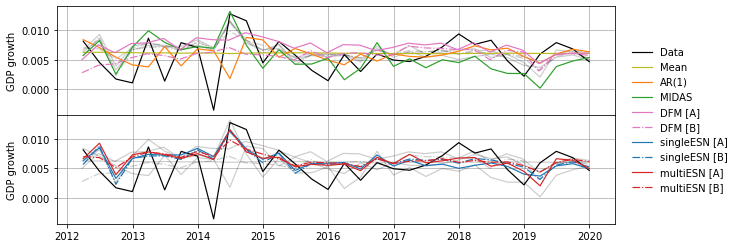

In [193]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2011['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_ew_for_1sa_2011, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_ew_for_1sa_2011, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_ew_for_1sa_2011, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_ew_for_1sa_2011, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_ew_1sa_forecast_2011, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_ew_1sa_forecast_2011, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_ew_1sa_forecast_2011, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_ew_forecast_2011, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_ew_forecast_2011, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2011['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_ew_1sa_forecast_2011, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_ew_1sa_forecast_2011, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_ew_1sa_forecast_2011, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_ew_forecast_2011, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_ew_forecast_2011, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_ew_for_1sa_2011, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_ew_for_1sa_2011, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_ew_for_1sa_2011, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_ew_for_1sa_2011, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Expanding Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2011.pdf'), bbox_inches="tight")
plt.show()

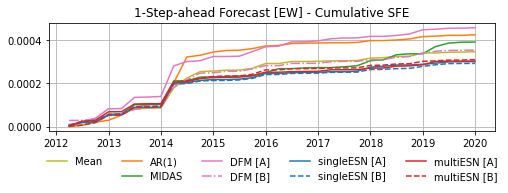

In [194]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8") 
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2011(lowfreqAR_ew_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [195]:
UnMean_MSE_ew_2011_td = MSFE_2011(UnMean_ew_1sa_forecast_2011) * 1e4
lowfreqAR_MSE_ew_2011_td = MSFE_2011(lowfreqAR_ew_1sa_forecast_2011) * 1e4
MIDAS_MSE_ew_2011_td = MSFE_2011(MIDAS_ew_1sa_forecast_2011) * 1e4
DFM_A_MSE_ew_2011_td = MSFE_2011(DFM_A_ew_forecast_2011) * 1e4
DMF_B_MSE_ew_2011_td = MSFE_2011(DFM_B_ew_forecast_2011) * 1e4
esnSingle_A_MSE_ew_2011_td = MSFE_2011(esnSingle_A_agg_ew_for_1sa_2011) * 1e4
esnSingle_B_MSE_ew_2011_td = MSFE_2011(esnSingle_B_agg_ew_for_1sa_2011) * 1e4
esnMulti_A_MSE_ew_2011_td = MSFE_2011(esnMulti_A_ew_for_1sa_2011) * 1e4
esnMulti_B_MSE_ew_2011_td = MSFE_2011(esnMulti_B_ew_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_ew_2011_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_ew_2011_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_ew_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_ew_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_ew_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_ew_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_ew_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_ew_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_ew_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_ew_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.1082 	|	0.3289
AR(1) 		 = 0.1327 	|	0.3643
MIDAS 		 = 0.1221 	|	0.3494
DFM [A]		 = 0.1429 	|	0.378
DFM [B]		 = 0.1106 	|	0.3325
singleESN [A]	 = 0.0939 	|	0.3064
singleESN [B]	 = 0.0913 	|	0.3021
multiESN [A]	 = 0.0946 	|	0.3076
multiESN [B]	 = 0.0968 	|	0.3111


In [196]:
ref_MSE_2011_ew = UnMean_MSE_ew_2011_td
lowfreqAR_MSE_toRef_2011_ew = lowfreqAR_MSE_ew_2011_td / ref_MSE_2011_ew
MIDAS_MSE_toRef_2011_ew = MIDAS_MSE_ew_2011_td / ref_MSE_2011_ew
DFM_A_MSE_toRef_2011_ew = DFM_A_MSE_ew_2011_td / ref_MSE_2011_ew
DMF_B_MSE_toRef_2011_ew = DMF_B_MSE_ew_2011_td / ref_MSE_2011_ew
esnSingle_A_MSE_toRef_2011_ew = esnSingle_A_MSE_ew_2011_td / ref_MSE_2011_ew
esnSingle_B_MSE_toRef_2011_ew = esnSingle_B_MSE_ew_2011_td / ref_MSE_2011_ew
esnMulti_A_MSE_toRef_2011_ew = esnMulti_A_MSE_ew_2011_td / ref_MSE_2011_ew
esnMulti_B_MSE_toRef_2011_ew = esnMulti_B_MSE_ew_2011_td / ref_MSE_2011_ew

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2011_ew.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_ew.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_ew.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_ew.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_ew.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_ew.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_ew.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_ew.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 1.2265
MIDAS 		 = 1.1286
DFM [A]		 = 1.3205
DFM [B]		 = 1.0221
singleESN [A]	 = 0.8675
singleESN [B]	 = 0.8437
multiESN [A]	 = 0.8745
multiESN [B]	 = 0.8948


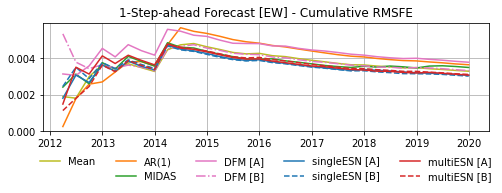

In [197]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2011(lowfreqAR_ew_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C3", ls='--')  
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

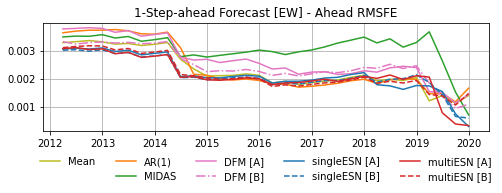

In [198]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2011(lowfreqAR_ew_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(aheadRMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

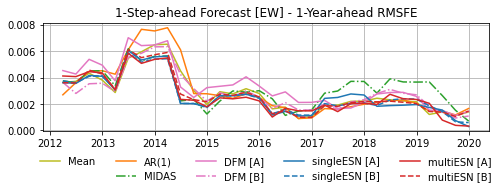

In [199]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2011(lowfreqAR_ew_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [200]:
mcs_data_2011_ew = pd.DataFrame(
    np.c_[UnMean_ew_1sa_forecast_2011,
        lowfreqAR_ew_1sa_forecast_2011,
        MIDAS_ew_1sa_forecast_2011, 
        DFM_A_ew_forecast_2011,
        DFM_B_ew_forecast_2011,
        esnSingle_A_agg_ew_for_1sa_2011,
        esnSingle_B_agg_ew_for_1sa_2011,
        esnMulti_A_ew_for_1sa_2011,
        esnMulti_B_ew_for_1sa_2011,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS [EW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [EW]', 'singleESN [B] [EW]', 'multiESN [A] [EW]', 'multiESN [B] [EW]']
)
mcs_data_2011_ew = (mcs_data_2011_ew - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2011_ew), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2011_ew), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_ew.included}")
print(f"MCS 10 included: {mcs_10_2011_ew.included}")

MCS 25 included: ['AR(1)', 'DFM [B]', 'Mean', 'multiESN [B] [EW]', 'multiESN [A] [EW]', 'singleESN [A] [EW]', 'singleESN [B] [EW]']
MCS 10 included: ['MIDAS [EW]', 'AR(1)', 'DFM [B]', 'Mean', 'multiESN [B] [EW]', 'multiESN [A] [EW]', 'singleESN [A] [EW]', 'singleESN [B] [EW]']


In [201]:
mcs_25_2011_ew.pvalues

DFM [A]               0.0048
MIDAS [EW]            0.1402
AR(1)                 0.7709
DFM [B]               0.7709
Mean                  0.7995
multiESN [B] [EW]     0.8511
multiESN [A] [EW]     0.8511
singleESN [A] [EW]    0.8511
singleESN [B] [EW]    1.0000
dtype: float64

In [202]:
if saveR:
    mcs_data_2011_ew.to_csv(
        os.path.join(path_folder, "R", "mcs_small_ew_2011.csv")
    )

In [203]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Rolling Window

In [204]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2011', date_slice=DFM_slice_2011,
)

DFM_B_rw_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2011', date_slice=DFM_slice_2011,
)

In [205]:
UnMean_rw_1sa_forecast_2011 = uncondMean_rw_1sa_Forecast(
    data=dataset2011,
)

In [206]:
lowfreqAR_rw_1sa_forecast_2011 = lowfreqAR_rw_1sa_Forecast(
    data=dataset2011,
)

In [207]:
%%capture
MIDAS_rw_1sa_forecast_2011 = MIDAS_rw_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2011,
)

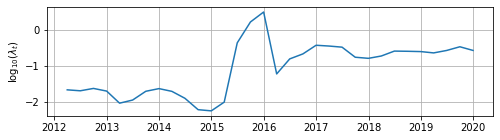

In [208]:
esnSingle_A_agg_rw_for_1sa_2011 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

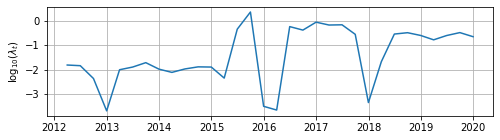

In [209]:
esnSingle_B_agg_rw_for_1sa_2011 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011,
    data=dataset2011,
    retune=True,
    aggregate=True,
)

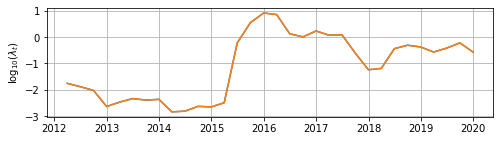

In [210]:
esnMulti_A_rw_for_1sa_2011 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

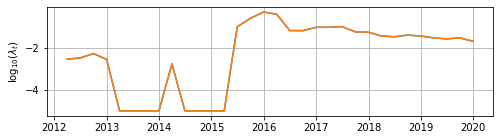

In [211]:
esnMulti_B_rw_for_1sa_2011 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

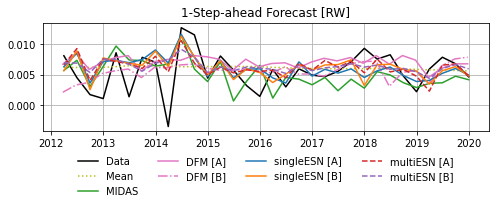

In [212]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_rw_1sa_forecast_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_rw_1sa_forecast_2011, label="MIDAS", c="C2", ls='-') 
#
plt.plot(DFM_A_rw_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_rw_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
# if savePlots: 
#     plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2011.pdf'), bbox_inches="tight")
plt.show()

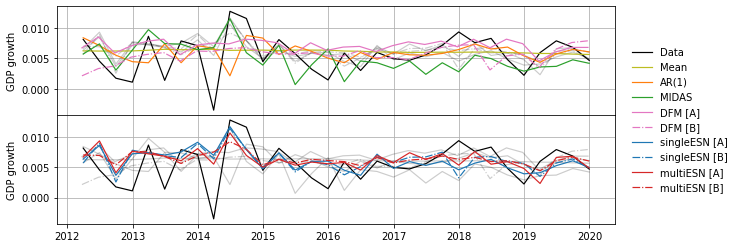

In [213]:
# Plot -- 1-Step-ahead Forecast
fig, (ax_1, ax_2) = plt.subplots(2, 1, figsize=(10, 4), sharex=True)
# Remove vertical space between axes
fig.subplots_adjust(hspace=0)
# First plot
p_data = ax_1.plot(dataset2011['GDP_data_test'], c='k', lw=1.2, label="Data")
# Background series
ax_1.plot(esnSingle_A_agg_rw_for_1sa_2011, label="singleESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnSingle_B_agg_rw_for_1sa_2011, label="singleESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
ax_1.plot(esnMulti_A_rw_for_1sa_2011, label="multiESN [A]", c="k", lw=1.2, alpha=0.2) 
ax_1.plot(esnMulti_B_rw_for_1sa_2011, label="multiESN [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
# Foreground series
p_mean = ax_1.plot(UnMean_rw_1sa_forecast_2011, label="Mean", c="C8", lw=1.2)
#
p_ar1 = ax_1.plot(lowfreqAR_rw_1sa_forecast_2011, label="AR(1)", c="C1", lw=1.2)
p_midas = ax_1.plot(MIDAS_rw_1sa_forecast_2011, label="MIDAS", c="C2", lw=1.2) 
#
p_dfma = ax_1.plot(DFM_A_rw_forecast_2011, label="DFM [A]", c="C6", lw=1.2) 
p_dfmb = ax_1.plot(DFM_B_rw_forecast_2011, label="DFM [B]", c="C6", lw=1.2, ls='-.') 
#
ax_1.grid()
# Second plot
ax_2.plot(dataset2011['GDP_data_test'], c='k', label="Data", lw=1.2)
#
ax_2.plot(UnMean_rw_1sa_forecast_2011, label="Mean", c="k", lw=1.2, alpha=0.2)
#
ax_2.plot(lowfreqAR_rw_1sa_forecast_2011, label="AR(1)", c="k", lw=1.2, alpha=0.2)
ax_2.plot(MIDAS_rw_1sa_forecast_2011, label="MIDAS", c="k", lw=1.2, alpha=0.2) 
#
ax_2.plot(DFM_A_rw_forecast_2011, label="DFM [A]", c="k", lw=1.2, alpha=0.2) 
ax_2.plot(DFM_B_rw_forecast_2011, label="DFM [B]", c="k", lw=1.2, alpha=0.2, ls='-.') 
#
p_smfesna = ax_2.plot(esnSingle_A_agg_rw_for_1sa_2011, label="singleESN [A]", c="C0", lw=1.2) 
p_smfesnb = ax_2.plot(esnSingle_B_agg_rw_for_1sa_2011, label="singleESN [B]", c="C0", lw=1.2, ls="-.") 
#
p_mmfesna = ax_2.plot(esnMulti_A_rw_for_1sa_2011, label="multiESN [A]", c="C3", lw=1.2) 
p_mmfesnb = ax_2.plot(esnMulti_B_rw_for_1sa_2011, label="multiESN [B]", c="C3", lw=1.2, ls='-.') 
#
ax_2.grid()
# Annotations
# ax_1.set_title("1-Step-ahead Forecast  ─  Rolling Window")
ax_1.set_ylabel('GDP growth')
ax_2.set_ylabel('GDP growth')
# ax_2.set_xlabel('Date')
_, labels = ax_2.get_legend_handles_labels()
fig.legend(
    [p_data[0], p_mean[0], p_ar1[0], p_midas[0], p_dfma[0], p_dfmb[0],
        p_smfesna[0], p_smfesnb[0], p_mmfesna[0], p_mmfesnb[0]],
    labels, 
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2011.pdf'), bbox_inches="tight")
plt.show()

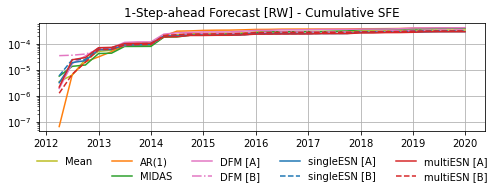

In [214]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulSFE_2011(lowfreqAR_rw_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(cumulSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.yscale('log')
plt.title("1-Step-ahead Forecast [RW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [215]:
UnMean_MSE_rw_2011_td = MSFE_2011(UnMean_rw_1sa_forecast_2011) * 1e4
lowfreqAR_MSE_rw_2011_td = MSFE_2011(lowfreqAR_rw_1sa_forecast_2011) * 1e4
MIDAS_MSE_rw_2011_td = MSFE_2011(MIDAS_rw_1sa_forecast_2011) * 1e4
DFM_A_MSE_rw_2011_td = MSFE_2011(DFM_A_rw_forecast_2011) * 1e4
DMF_B_MSE_rw_2011_td = MSFE_2011(DFM_B_rw_forecast_2011) * 1e4
esnSingle_A_MSE_rw_2011_td = MSFE_2011(esnSingle_A_agg_rw_for_1sa_2011) * 1e4
esnSingle_B_MSE_rw_2011_td = MSFE_2011(esnSingle_B_agg_rw_for_1sa_2011) * 1e4
esnMulti_A_MSE_rw_2011_td = MSFE_2011(esnMulti_A_rw_for_1sa_2011) * 1e4
esnMulti_B_MSE_rw_2011_td = MSFE_2011(esnMulti_B_rw_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"Mean \t\t = {UnMean_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_rw_2011_td).round(4)}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(lowfreqAR_MSE_ew_2011_td).round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_rw_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_rw_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_rw_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_rw_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_rw_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_rw_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_rw_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_rw_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
Mean 		 = 0.1098 	|	0.3313
AR(1) 		 = 0.1327 	|	0.3643
MIDAS 		 = 0.1284 	|	0.3584
DFM [A]		 = 0.1346 	|	0.3668
DFM [B]		 = 0.1128 	|	0.3359
singleESN [A]	 = 0.0947 	|	0.3078
singleESN [B]	 = 0.1021 	|	0.3196
multiESN [A]	 = 0.0943 	|	0.307
multiESN [B]	 = 0.1012 	|	0.318


In [216]:
ref_MSE_2011_rw = UnMean_MSE_rw_2011_td
lowfreqAR_MSE_toRef_2011_rw = lowfreqAR_MSE_ew_2011_td / ref_MSE_2011_rw
MIDAS_MSE_toRef_2011_rw = MIDAS_MSE_rw_2011_td / ref_MSE_2011_rw
DFM_A_MSE_toRef_2011_rw = DFM_A_MSE_rw_2011_td / ref_MSE_2011_rw
DMF_B_MSE_toRef_2011_rw = DMF_B_MSE_rw_2011_td / ref_MSE_2011_rw
esnSingle_A_MSE_toRef_2011_rw = esnSingle_A_MSE_rw_2011_td / ref_MSE_2011_rw
esnSingle_B_MSE_toRef_2011_rw = esnSingle_B_MSE_rw_2011_td / ref_MSE_2011_rw
esnMulti_A_MSE_toRef_2011_rw = esnMulti_A_MSE_rw_2011_td / ref_MSE_2011_rw
esnMulti_B_MSE_toRef_2011_rw = esnMulti_B_MSE_rw_2011_td / ref_MSE_2011_rw

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"AR(1) \t\t = {lowfreqAR_MSE_toRef_2011_rw.round(4)}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_rw.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_rw.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_rw.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_rw.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_rw.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_rw.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_rw.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
AR(1) 		 = 1.2088
MIDAS 		 = 1.1701
DFM [A]		 = 1.2259
DFM [B]		 = 1.0275
singleESN [A]	 = 0.8629
singleESN [B]	 = 0.9304
multiESN [A]	 = 0.8586
multiESN [B]	 = 0.9214


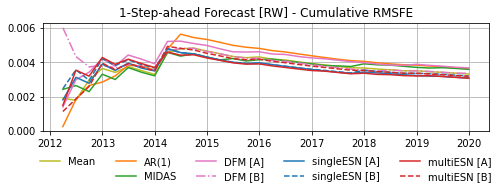

In [217]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(cumulRMSFE_2011(lowfreqAR_rw_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(cumulRMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(cumulRMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

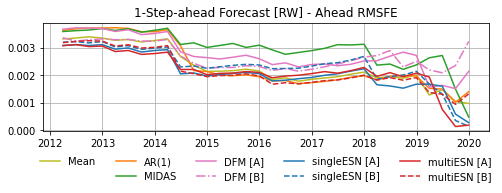

In [218]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(aheadRMSFE_2011(lowfreqAR_rw_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(aheadRMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(aheadRMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

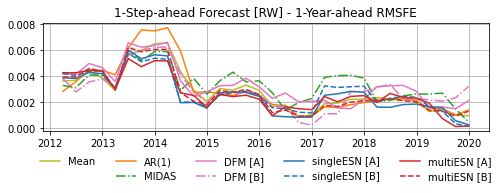

In [219]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8")
plt.plot(np.NaN, np.NaN, '-', color='none', label=' ') # empty entry
#
plt.plot(YA_RMSFE_2011(lowfreqAR_rw_1sa_forecast_2011), label="AR(1)", c="C1") 
plt.plot(YA_RMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3") 
plt.plot(YA_RMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=5)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [220]:
mcs_data_2011_rw = pd.DataFrame(
    np.c_[UnMean_rw_1sa_forecast_2011,
        lowfreqAR_rw_1sa_forecast_2011,
        MIDAS_rw_1sa_forecast_2011,
        DFM_A_rw_forecast_2011,
        DFM_B_rw_forecast_2011,
        esnSingle_A_agg_rw_for_1sa_2011,
        esnSingle_B_agg_rw_for_1sa_2011,
        esnMulti_A_rw_for_1sa_2011,
        esnMulti_B_rw_for_1sa_2011,
    ],
    columns=['Mean', 'AR(1)', 'MIDAS [RW]', 'DFM [A]', 'DFM [B]',
                'singleESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [A] [RW]', 'multiESN [B] [RW]']
)
mcs_data_2011_rw = (mcs_data_2011_rw - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2011_rw), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2011_rw), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_rw.included}")
print(f"MCS 10 included: {mcs_10_2011_rw.included}")

MCS 25 included: ['AR(1)', 'DFM [B]', 'Mean', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]', 'multiESN [A] [RW]']
MCS 10 included: ['MIDAS [RW]', 'AR(1)', 'DFM [B]', 'Mean', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]', 'multiESN [A] [RW]']


In [221]:
mcs_25_2011_rw.pvalues

DFM [A]               0.0071
MIDAS [RW]            0.1607
AR(1)                 0.8710
DFM [B]               0.8710
Mean                  0.8710
singleESN [B] [RW]    0.8710
multiESN [B] [RW]     0.8710
singleESN [A] [RW]    0.9661
multiESN [A] [RW]     1.0000
dtype: float64

In [222]:
if saveR:
    mcs_data_2011_rw.to_csv(
        os.path.join(path_folder, "R", "mcs_small_rw_2011.csv")
    )

In [223]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


#### 1-step Ahead High-Frequency Forecast Comparison


##### Fixed Parameters

In [ ]:
DFM_A_fix_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', 
)
DFM_A_fix_highfreq_forecast_2011 = DFM_A_fix_highfreq_forecast_2011.loc[
    (DFM_A_fix_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_fix_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_fix_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2011',
)
DFM_B_fix_highfreq_forecast_2011 = DFM_B_fix_highfreq_forecast_2011.loc[
    (DFM_B_fix_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_fix_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_fix_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_fix_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_fix_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_fix_highfreq_forecast_2011 = DFM_A_fix_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_fix_highfreq_forecast_2011 = DFM_B_fix_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [ ]:
%%capture
MIDAS_fix_for_highfreq_1sa_2011 = MIDAS_fix_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

In [ ]:
esnSingle_A_agg_fix_highfreq_for_1sa_2011 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    aggregate=True,
)

esnSingle_B_agg_fix_highfreq_for_1sa_2011 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    aggregate=True,
)

In [ ]:
esnMulti_A_fix_highfreq_for_1sa_2011 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
)

esnMulti_B_fix_highfreq_for_1sa_2011 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
)

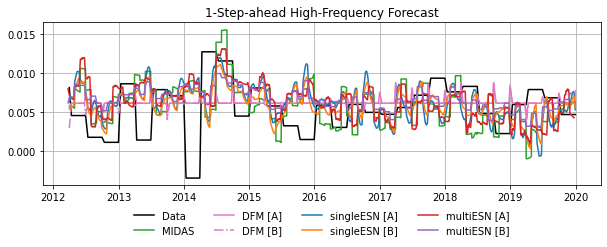

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_fix_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2011["hf_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_highfreq_for_1sa_2011["hf_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_highfreq_for_1sa_2011["hf_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_fix_highfreq_for_1sa_2011["hf_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_fix_2011.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

##### Expanding Window

In [ ]:
DFM_A_ew_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', 
)
DFM_A_ew_highfreq_forecast_2011 = DFM_A_ew_highfreq_forecast_2011.loc[
    (DFM_A_ew_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_ew_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_ew_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2011',
)
DFM_B_ew_highfreq_forecast_2011 = DFM_B_ew_highfreq_forecast_2011.loc[
    (DFM_B_ew_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_ew_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_ew_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_ew_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_ew_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_ew_highfreq_forecast_2011 = DFM_A_ew_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_ew_highfreq_forecast_2011 = DFM_B_ew_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [ ]:
%%capture
MIDAS_ew_for_highfreq_1sa_2011 = MIDAS_ew_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

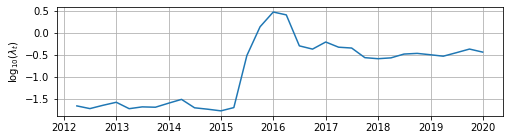

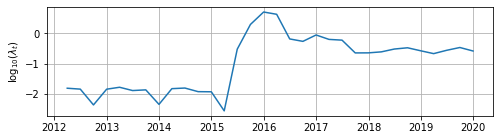

In [ ]:
esnSingle_A_agg_ew_highfreq_for_1sa_2011 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_highfreq_for_1sa_2011 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

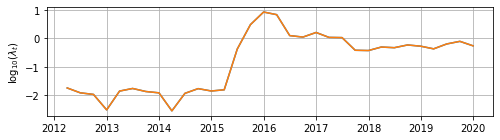

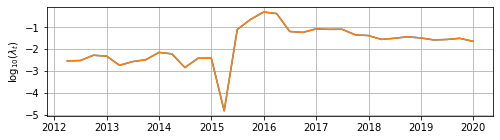

In [ ]:
esnMulti_A_ew_highfreq_for_1sa_2011 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_ew_highfreq_for_1sa_2011 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

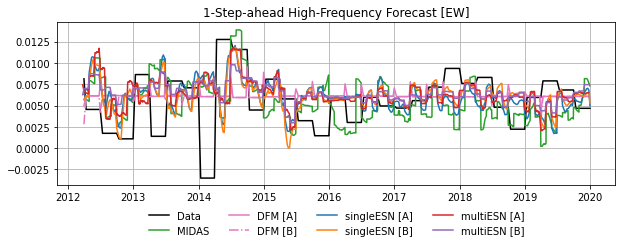

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_ew_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_ew_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

##### Rolling Window

In [ ]:
DFM_A_rw_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2011', 
)
DFM_A_rw_highfreq_forecast_2011 = DFM_A_rw_highfreq_forecast_2011.loc[
    (DFM_A_rw_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_rw_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_rw_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2011',
)
DFM_B_rw_highfreq_forecast_2011 = DFM_B_rw_highfreq_forecast_2011.loc[
    (DFM_B_rw_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_rw_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_rw_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_rw_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_rw_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_rw_highfreq_forecast_2011 = DFM_A_rw_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_rw_highfreq_forecast_2011 = DFM_B_rw_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [ ]:
%%capture
MIDAS_rw_for_highfreq_1sa_2011 = MIDAS_rw_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

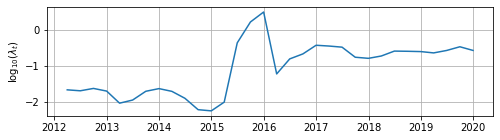

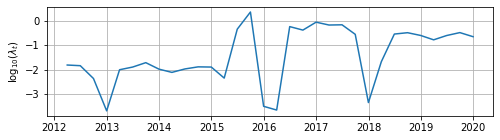

In [ ]:
esnSingle_A_agg_rw_highfreq_for_1sa_2011 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_highfreq_for_1sa_2011 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

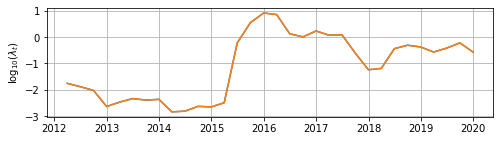

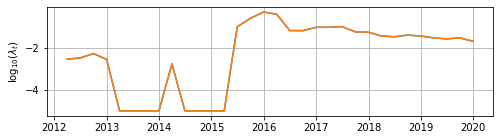

In [ ]:
esnMulti_A_rw_highfreq_for_1sa_2011 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_rw_highfreq_for_1sa_2011 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

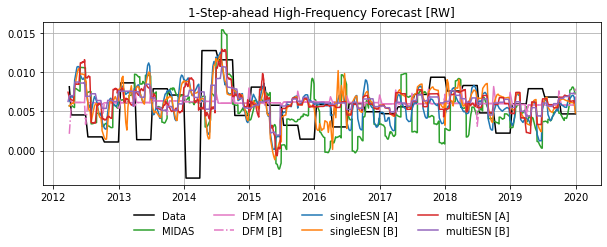

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_rw_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
raise SystemExit("Section ended!")

#### Multi-step Point Forecast

##### Fixed Parameters

In [224]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_fix_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_fixed__2011', steps=8, date_slice=DFM_slice_2011,
)

In [225]:
UnMean_fix_multistep_for_2011 = UnMean_fix_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [226]:
lowfreqAR_fix_multistep_for_2011 = lowfreqAR_fix_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [227]:
import pickle

MIDAS_fix_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_eadc2894b6__MIDAS_fix_multistep_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_fix_multistep_for_2011 = pickle.load(file)

In [228]:
# Aggregated
esnSingle_A_agg_fix_multistep_for_2011 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    aggregate=True,
)

In [229]:
esnSingle_B_agg_fix_multistep_for_2011 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    aggregate=True,
)

In [230]:
esnMulti_A_fix_multistep_for_2011 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
)

In [231]:
esnMulti_B_fix_multistep_for_2011 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
)

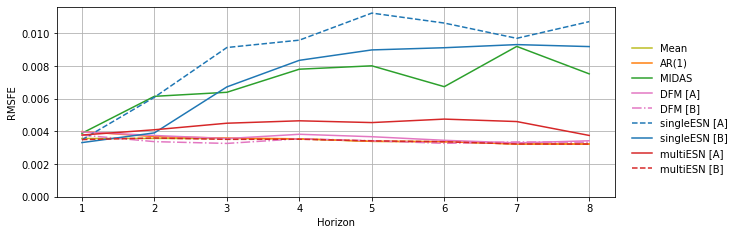

In [232]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_fix_multistep_for_2011), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2011(lowfreqAR_fix_multistep_for_2011), label="AR(1)", c="C1") 
plt.plot(hStepRMSFE_2011(MIDAS_fix_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_fix_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_fix_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_fix_multistep_for_2011), label="singleESN [A]", c="C0", ls='--') 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_fix_multistep_for_2011), label="singleESN [B]", c="C0") 
#
plt.plot(hStepRMSFE_2011(esnMulti_A_fix_multistep_for_2011), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2011(esnMulti_B_fix_multistep_for_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast RMSFE  ─  Fixed Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_fix_2011.pdf'), bbox_inches="tight")
plt.show()

In [233]:
table_RMSFE_multistep_fix_2011 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_fix_2011.index.name = "FIX_2011"
table_RMSFE_multistep_fix_2011["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_fix = hStepRMSFE_2011(UnMean_fix_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_fix_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(lowfreqAR_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(MIDAS_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(DFM_A_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(DFM_B_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnSingle_A_agg_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnSingle_B_agg_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnMulti_A_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnMulti_B_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
    ]

table_RMSFE_multistep_fix_2011.round(3)

,Model,1,2,3,4,5,6,7,8
FIX_2011,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,AR(1),1.119,1.031,1.008,1.001,1.001,0.999,0.999,0.998
3,MIDAS,1.090,1.721,1.793,2.203,2.363,1.997,2.846,2.328
4,DFM [A],1.112,1.051,0.999,1.079,1.084,1.025,1.020,1.061
5,DFM [B],1.058,0.945,0.916,1.003,1.012,0.970,1.038,1.033
6,singleESN [A],0.978,1.705,2.561,2.704,3.314,3.151,2.999,3.316
7,singleESN [B],0.930,1.095,1.885,2.356,2.650,2.704,2.880,2.844
8,multiESN [A],1.059,1.148,1.262,1.312,1.339,1.409,1.424,1.162
9,multiESN [B],0.981,1.007,0.985,0.994,1.008,0.999,0.999,0.998


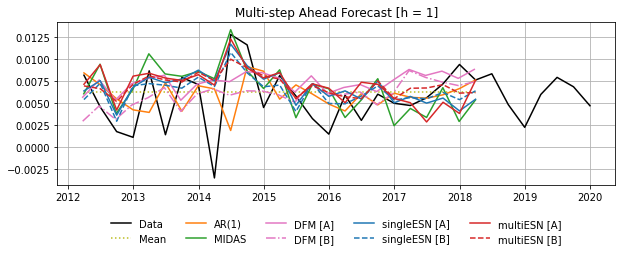

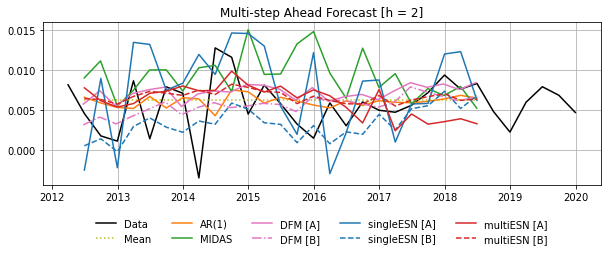

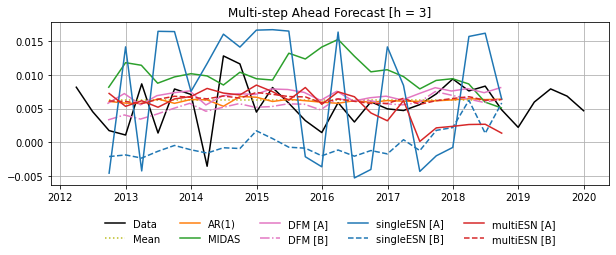

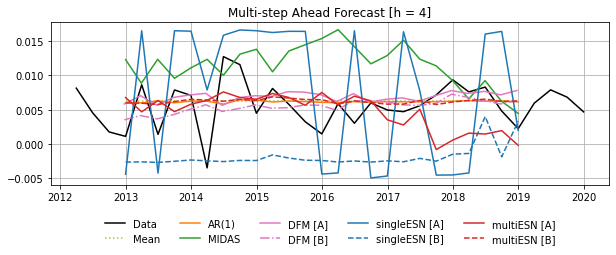

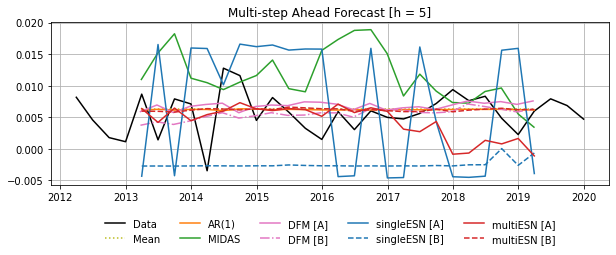

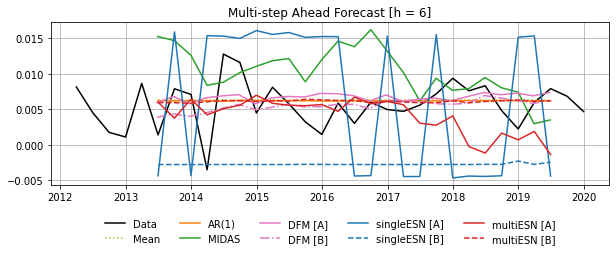

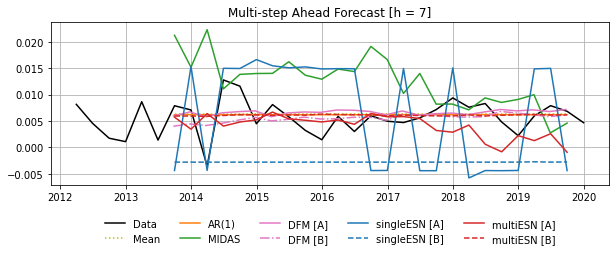

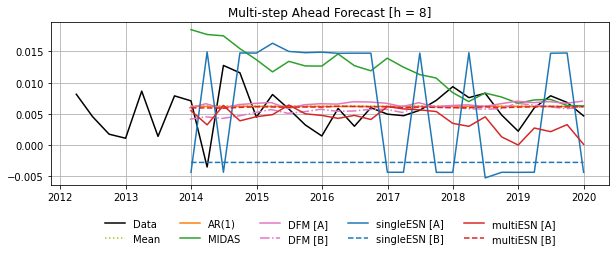

In [234]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(lowfreqAR_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1") 
    plt.plot(MIDAS_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [235]:
mhmcs_steps = 8
mhmcs_multistep_fix_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_fix_2011[h, :, :] = (
        np.c_[
            UnMean_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [236]:
if saveR:
    mhmcs_multistep_fix_2011_df = mhmcs_multistep_fix_2011.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_fix_2011_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_fix_2011.csv")
    )

In [237]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Expanding Window

In [238]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_ew_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_expanding__2011', steps=8, date_slice=DFM_slice_2011,
)

In [239]:
UnMean_ew_multistep_for_2011 = UnMean_ew_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [240]:
lowfreqAR_ew_multistep_for_2011 = lowfreqAR_ew_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [241]:
import pickle

MIDAS_ew_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_2c162a989b__MIDAS_ew_multistep_for_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_ew_multistep_for_2011 = pickle.load(file)

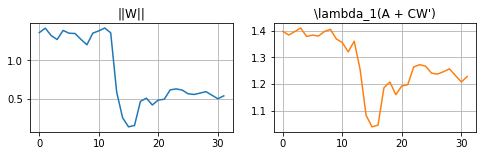

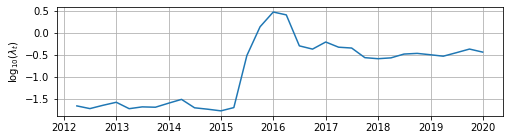

In [242]:
# Aggregated
esnSingle_A_agg_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

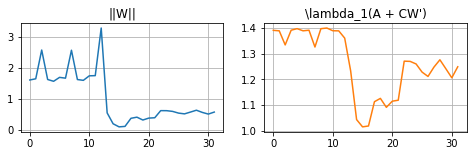

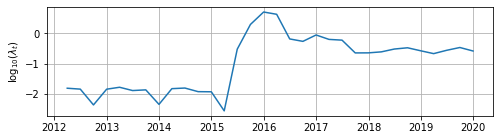

In [243]:
esnSingle_B_agg_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

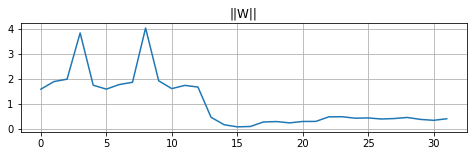

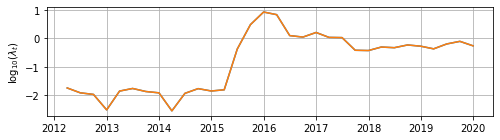

In [244]:
esnMulti_A_ew_multistep_for_2011 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]],  
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

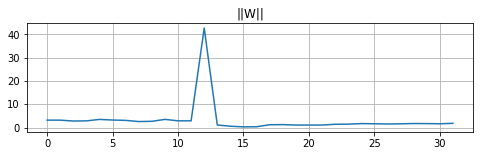

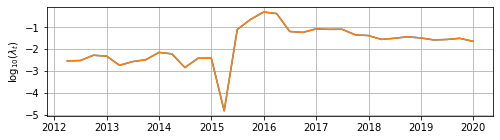

In [245]:
esnMulti_B_ew_multistep_for_2011 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

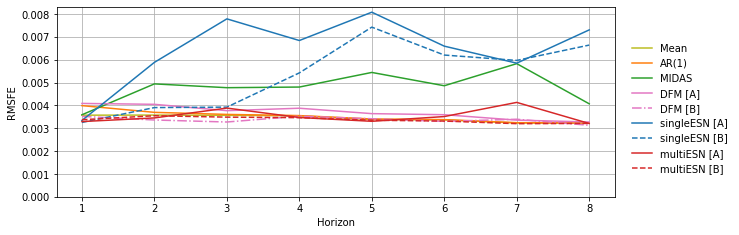

In [246]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_ew_multistep_for_2011), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2011(lowfreqAR_ew_multistep_for_2011), label="AR(1)", c="C1") 
plt.plot(hStepRMSFE_2011(MIDAS_ew_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_ew_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_ew_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_ew_multistep_for_2011), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_ew_multistep_for_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(hStepRMSFE_2011(esnMulti_A_ew_multistep_for_2011), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2011(esnMulti_B_ew_multistep_for_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast  ─  Expanding Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [247]:
table_RMSFE_multistep_ew_2011 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_ew_2011.index.name = "EW_2011"
table_RMSFE_multistep_ew_2011["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_ew = hStepRMSFE_2011(UnMean_ew_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_ew_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(lowfreqAR_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(MIDAS_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(DFM_A_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(DFM_B_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnSingle_A_agg_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnSingle_B_agg_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnMulti_A_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnMulti_B_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
    ]

table_RMSFE_multistep_ew_2011.round(4)

,Model,1,2,3,4,5,6,7,8
EW_2011,,,,,,,,,
1,Mean,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,AR(1),1.1170,1.0334,1.0112,1.0021,1.0066,1.0033,1.0038,1.0027
3,MIDAS,1.0050,1.3816,1.3392,1.3544,1.6088,1.4440,1.8033,1.2628
4,DFM [A],1.1441,1.1316,1.0572,1.0930,1.0758,1.0674,1.0384,1.0157
5,DFM [B],0.9854,0.9398,0.9179,0.9951,1.0097,0.9804,1.0505,0.9708
6,singleESN [A],0.9355,1.6451,2.1837,1.9286,2.3881,1.9589,1.8097,2.2664
7,singleESN [B],0.9112,1.0918,1.1005,1.5290,2.1948,1.8431,1.8469,2.0602
8,multiESN [A],0.9217,0.9651,1.0888,0.9785,0.9767,1.0434,1.2785,0.9954
9,multiESN [B],0.9443,0.9919,0.9777,0.9766,0.9907,0.9848,0.9904,0.9962


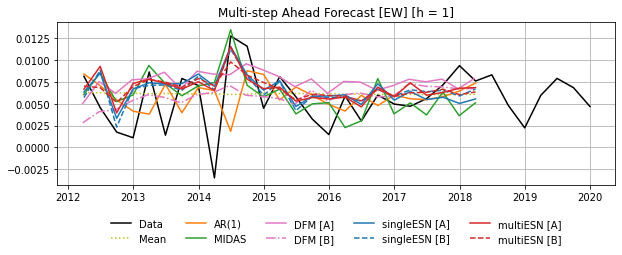

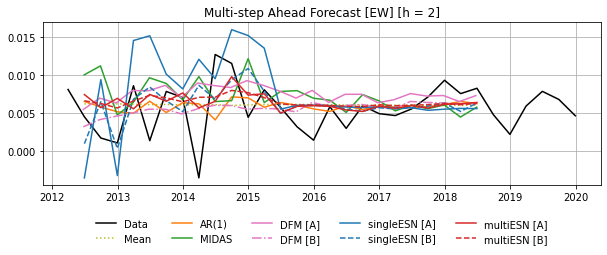

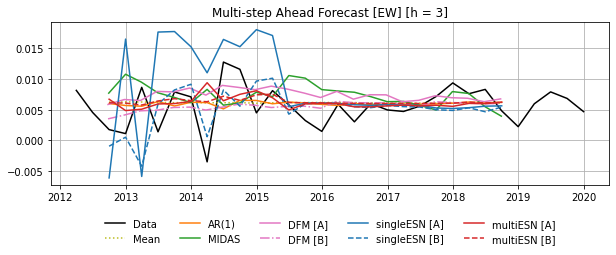

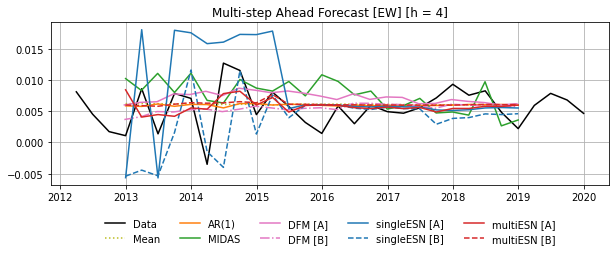

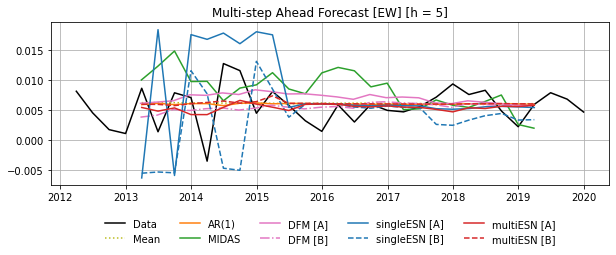

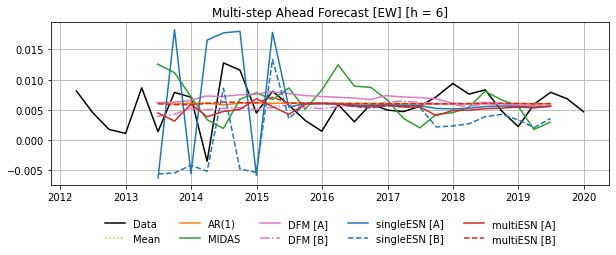

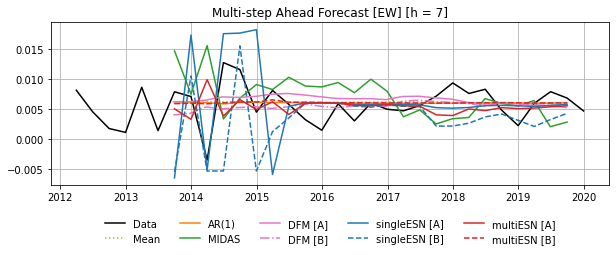

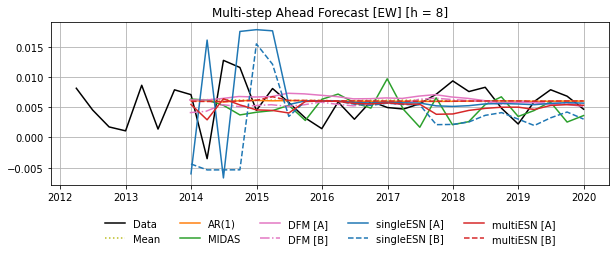

In [248]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    plt.plot(lowfreqAR_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1")
    #
    plt.plot(MIDAS_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [EW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [249]:
mhmcs_steps = 8
mhmcs_multistep_ew_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_ew_2011[h, :, :] = (
        np.c_[
            UnMean_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [250]:
if saveR:
    mhmcs_multistep_ew_2011_df = mhmcs_multistep_ew_2011.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_ew_2011_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_ew_2011.csv")
    )

In [251]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


##### Rolling Window

In [252]:
DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_window__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_rw_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_window__2011', steps=8, date_slice=DFM_slice_2011,
)

In [253]:
UnMean_rw_multistep_for_2011 = UnMean_rw_fit_multistep(
    data=dataset2011,
    steps=8
)

In [254]:
lowfreqAR_rw_multistep_for_2011 = lowfreqAR_rw_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [255]:
import pickle

MIDAS_rw_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_eaf1d1fe9c__MIDAS_rw_multistep_for_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_rw_multistep_for_2011 = pickle.load(file)

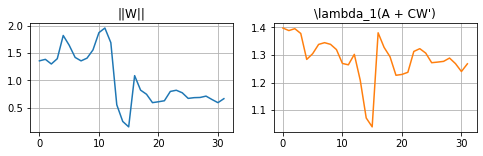

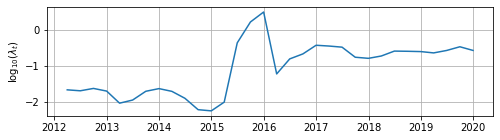

In [256]:
# Aggregated
esnSingle_A_agg_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011,  
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

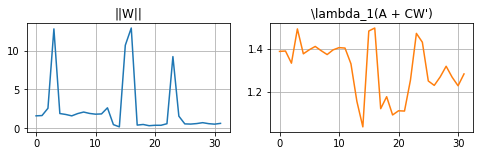

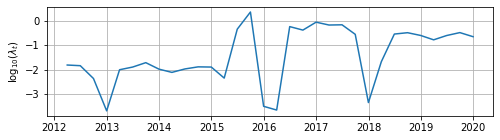

In [257]:
esnSingle_B_agg_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011, 
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

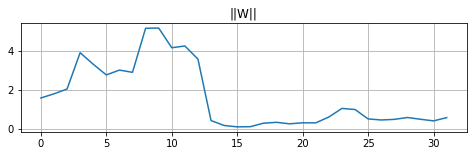

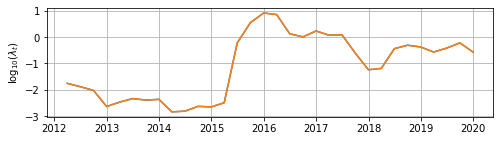

In [258]:
esnMulti_A_rw_multistep_for_2011 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

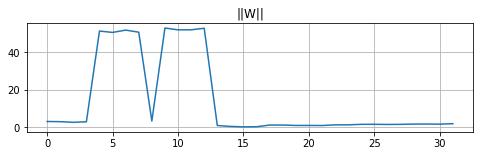

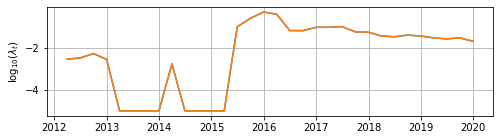

In [259]:
esnMulti_B_rw_multistep_for_2011 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

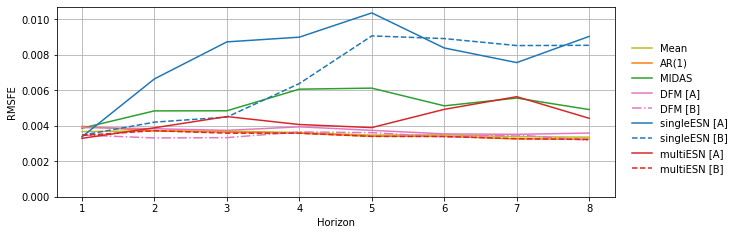

In [260]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

fig, ax = plt.subplots(figsize=(10, 3.5))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_rw_multistep_for_2011), label="Mean", c="C8") 
#
plt.plot(hStepRMSFE_2011(lowfreqAR_rw_multistep_for_2011), label="AR(1)", c="C1")
plt.plot(hStepRMSFE_2011(MIDAS_rw_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_rw_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_rw_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_rw_multistep_for_2011), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_rw_multistep_for_2011), label="singleESN [B]", c="C0", ls='--') 
#
plt.plot(hStepRMSFE_2011(esnMulti_A_rw_multistep_for_2011), label="multiESN [A]", c="C3") 
plt.plot(hStepRMSFE_2011(esnMulti_B_rw_multistep_for_2011), label="multiESN [B]", c="C3", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
ax.set_ylabel('RMSFE')
ax.set_xlabel('Horizon')
# plt.title("Multi-step Ahead Forecast  ─  Rolling Window")
fig.legend(
    loc='upper right', bbox_to_anchor=(1.07, 0.77), 
    frameon=False, fancybox=False, shadow=False,
)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [261]:
table_RMSFE_multistep_rw_2011 = pd.DataFrame(
    index=range(1,10)
)
table_RMSFE_multistep_rw_2011.index.name = "RW_2011"
table_RMSFE_multistep_rw_2011["Model"] = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

for h in range(8):
    ref_h_hStepRMSFE_rw = hStepRMSFE_2011(UnMean_rw_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_rw_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(lowfreqAR_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(MIDAS_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(DFM_A_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(DFM_B_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnSingle_A_agg_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnSingle_B_agg_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnMulti_A_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnMulti_B_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
    ]

table_RMSFE_multistep_rw_2011.round(4)

,Model,1,2,3,4,5,6,7,8
RW_2011,,,,,,,,,
1,Mean,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,AR(1),1.0802,0.9996,0.9841,0.9888,0.9816,0.9762,0.9630,0.9678
3,MIDAS,1.0515,1.3032,1.3100,1.6742,1.7617,1.4672,1.6434,1.4631
4,DFM [A],1.0615,1.0325,1.0119,1.0884,1.0772,1.0148,1.0396,1.0693
5,DFM [B],0.9467,0.8927,0.9010,1.0089,1.0399,0.9663,1.0295,0.9494
6,singleESN [A],0.9193,1.7880,2.3595,2.4830,2.9813,2.4006,2.2336,2.6905
7,singleESN [B],0.9437,1.1322,1.2139,1.7617,2.6082,2.5519,2.5171,2.5407
8,multiESN [A],0.8964,1.0466,1.2221,1.1242,1.1222,1.4104,1.6662,1.3164
9,multiESN [B],0.9402,1.0026,0.9689,0.9893,0.9789,0.9720,0.9670,0.9609


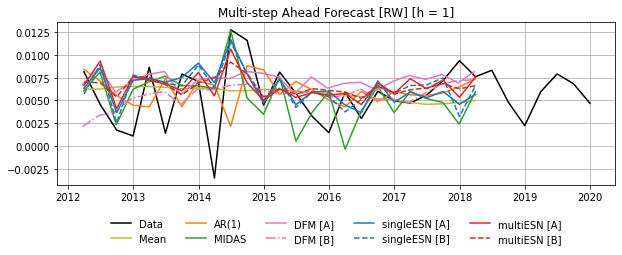

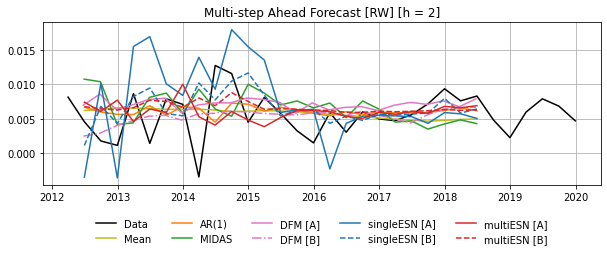

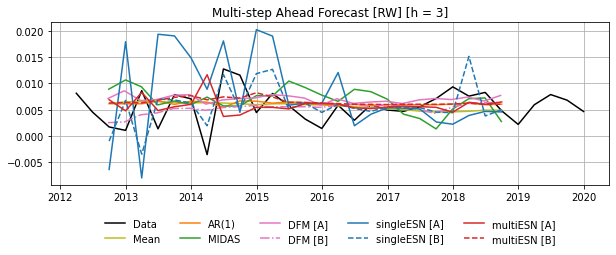

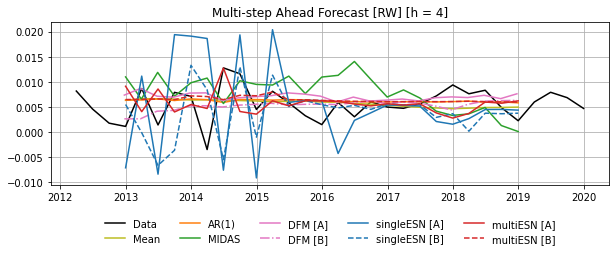

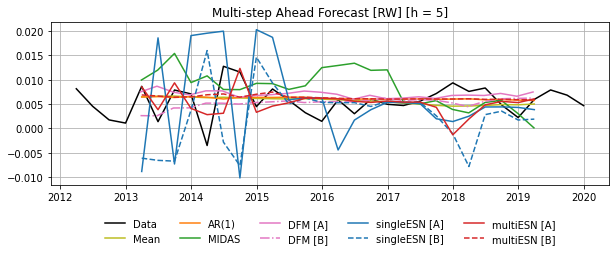

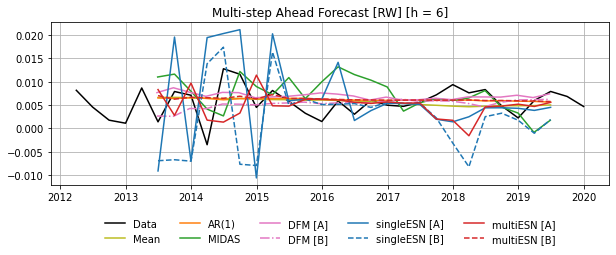

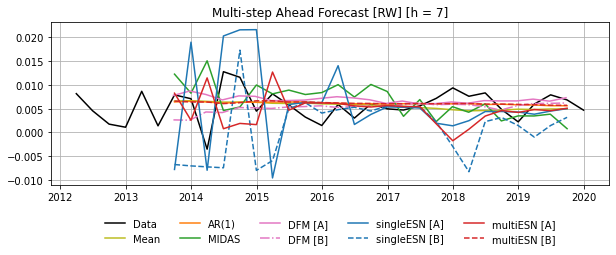

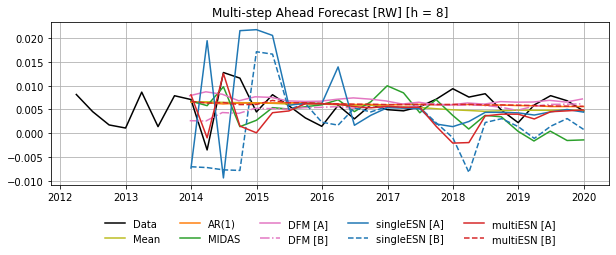

In [262]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8") 
    #
    plt.plot(lowfreqAR_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="AR(1)", c="C1") 
    plt.plot(MIDAS_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C0", ls='--') 
    #
    plt.plot(esnMulti_A_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3") 
    plt.plot(esnMulti_B_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C3", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [RW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [263]:
mhmcs_steps = 8
mhmcs_multistep_rw_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 9)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_rw_2011[h, :, :] = (
        np.c_[
            UnMean_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            lowfreqAR_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [264]:
if saveR:
    mhmcs_multistep_rw_2011_df = mhmcs_multistep_rw_2011.to_dataframe(
        name="Loss", dim_order=['M0', 'H', 'T']
    )
    mhmcs_multistep_rw_2011_df.to_csv(
        os.path.join(path_folder, "R", "mhmcs_small_multistep_rw_2011.csv")
    )

In [265]:
raise SystemExit("Section ended!")

SystemExit: Section ended!

c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3452: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


### Tables

#### 1-Step Ahead

In [266]:
# Export Relative-MFSE to CSV
method_names = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

RelMSFE_results = pd.DataFrame(
    data=np.zeros((len(method_names), 6)), 
    columns=[
       "MCS SMALL FIX 2007", "MCS SMALL FIX 2011", 
       "MCS SMALL EW 2007" , "MCS SMALL EW 2011" , 
       "MCS SMALL RW 2007" , "MCS SMALL RW 2011"
    ]
)
RelMSFE_results.loc[:,"MCS SMALL FIX 2007"] = [
        1, lowfreqAR_MSE_toRef_2007_fix, MIDAS_MSE_toRef_2007_fix,
        DFM_A_MSE_toRef_2007_fix, DMF_B_MSE_toRef_2007_fix, 
        esnSingle_A_MSE_toRef_2007_fix, esnSingle_B_MSE_toRef_2007_fix,
        esnMulti_A_MSE_toRef_2007_fix, esnMulti_B_MSE_toRef_2007_fix,
    ]
RelMSFE_results.loc[:,"MCS SMALL FIX 2011"] = [
        1, lowfreqAR_MSE_toRef_2011_fix, MIDAS_MSE_toRef_2011_fix,
        DFM_A_MSE_toRef_2011_fix, DMF_B_MSE_toRef_2011_fix, 
        esnSingle_A_MSE_toRef_2011_fix, esnSingle_B_MSE_toRef_2011_fix,
        esnMulti_A_MSE_toRef_2011_fix, esnMulti_B_MSE_toRef_2011_fix,
    ]
RelMSFE_results.loc[:,"MCS SMALL EW 2007"] = [
        1, lowfreqAR_MSE_toRef_2007_ew, MIDAS_MSE_toRef_2007_ew,
        DFM_A_MSE_toRef_2007_ew, DMF_B_MSE_toRef_2007_ew, 
        esnSingle_A_MSE_toRef_2007_ew, esnSingle_B_MSE_toRef_2007_ew,
        esnMulti_A_MSE_toRef_2007_ew, esnMulti_B_MSE_toRef_2007_ew,
    ]
RelMSFE_results.loc[:,"MCS SMALL EW 2011"] = [
        1, lowfreqAR_MSE_toRef_2011_ew, MIDAS_MSE_toRef_2011_ew, 
        DFM_A_MSE_toRef_2011_ew, DMF_B_MSE_toRef_2011_ew, 
        esnSingle_A_MSE_toRef_2011_ew, esnSingle_B_MSE_toRef_2011_ew,
        esnMulti_A_MSE_toRef_2011_ew, esnMulti_B_MSE_toRef_2011_ew,
    ]
RelMSFE_results.loc[:,"MCS SMALL RW 2007"] = [
        1, lowfreqAR_MSE_toRef_2007_rw, MIDAS_MSE_toRef_2007_rw,
        DFM_A_MSE_toRef_2007_rw, DMF_B_MSE_toRef_2007_rw, 
        esnSingle_A_MSE_toRef_2007_rw, esnSingle_B_MSE_toRef_2007_rw,
        esnMulti_A_MSE_toRef_2007_rw, esnMulti_B_MSE_toRef_2007_rw,
    ]
RelMSFE_results.loc[:,"MCS SMALL RW 2011"] = [
        1, lowfreqAR_MSE_toRef_2011_rw, MIDAS_MSE_toRef_2011_rw,
        DFM_A_MSE_toRef_2011_rw, DMF_B_MSE_toRef_2011_rw, 
        esnSingle_A_MSE_toRef_2011_rw, esnSingle_B_MSE_toRef_2011_rw,
        esnMulti_A_MSE_toRef_2011_rw, esnMulti_B_MSE_toRef_2011_rw,
    ]

if saveR:
    RelMSFE_results.round(3).to_csv(
        os.path.join(path_folder, "R", "RelMSFE_small.csv")
    )
RelMSFE_results.round(3)

,MCS SMALL FIX 2007,MCS SMALL FIX 2011,MCS SMALL EW 2007,MCS SMALL EW 2011,MCS SMALL RW 2007,MCS SMALL RW 2011
0,1.000,1.000,1.000,1.000,1.000,1.000
1,0.758,1.230,0.789,1.226,0.775,1.209
2,0.533,1.300,0.596,1.129,0.709,1.170
3,0.799,1.337,0.980,1.320,0.919,1.226
4,0.885,1.221,0.982,1.022,0.948,1.028
5,0.721,1.015,0.597,0.867,0.529,0.863
6,0.758,0.921,0.602,0.844,0.561,0.930
7,0.802,1.250,0.635,0.874,0.621,0.859
8,0.590,0.969,0.552,0.895,0.530,0.921


In [267]:
def MCS_include_stars(m, mcs25, mcs10):
    s = ''
    if m in mcs25.included: s+= '*'
    if m in mcs10.included: s+= '*'
    #if not s == '': s = '$' + s + '$'
    return s

def MCS_stars(mcs25, mcs10):
    methods_25 = list(mcs25.names)
    methods_10 = list(mcs10.names)
    assert methods_25 == methods_10, "MCS test objects have different method names!"
    return [MCS_include_stars(m, mcs25, mcs10) for m in methods_25]

In [268]:
method_names = [
    'Mean', 'AR(1)', 'MIDAS', 'DFM [A]', 'DFM [B]', 
    'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
]

table_MSFE_MCS = pd.DataFrame(dict(
    method=method_names,
    MSFE_fix_2007=[
        1, lowfreqAR_MSE_toRef_2007_fix, MIDAS_MSE_toRef_2007_fix,
        DFM_A_MSE_toRef_2007_fix, DMF_B_MSE_toRef_2007_fix, 
        esnSingle_A_MSE_toRef_2007_fix, esnSingle_B_MSE_toRef_2007_fix,
        esnMulti_A_MSE_toRef_2007_fix, esnMulti_B_MSE_toRef_2007_fix,
    ],
    MCS_fix_2007=MCS_stars(mcs_25_2007_fix, mcs_10_2007_fix),
    # [
    #     MCS_include_stars(m, mcs_25_2007_fix, mcs_10_2007_fix) for m in method_names
    # ],
    MSFE_fix_2011=[
        1, lowfreqAR_MSE_toRef_2011_fix, MIDAS_MSE_toRef_2011_fix,
        DFM_A_MSE_toRef_2011_fix, DMF_B_MSE_toRef_2011_fix, 
        esnSingle_A_MSE_toRef_2011_fix, esnSingle_B_MSE_toRef_2011_fix,
        esnMulti_A_MSE_toRef_2011_fix, esnMulti_B_MSE_toRef_2011_fix,
    ],
    MCS_fix_2011=MCS_stars(mcs_25_2011_fix, mcs_10_2011_fix),
    # [
    #     MCS_include_stars(m, mcs_25_2011_fix, mcs_10_2011_fix) for m in method_names
    # ],
    MSFE_ew_2007=[
        1, lowfreqAR_MSE_toRef_2007_ew, MIDAS_MSE_toRef_2007_ew,
        DFM_A_MSE_toRef_2007_ew, DMF_B_MSE_toRef_2007_ew, 
        esnSingle_A_MSE_toRef_2007_ew, esnSingle_B_MSE_toRef_2007_ew,
        esnMulti_A_MSE_toRef_2007_ew, esnMulti_B_MSE_toRef_2007_ew,
    ],
    MCS_ew_2007=MCS_stars(mcs_25_2007_ew, mcs_10_2007_ew),
    # [
    #     MCS_include_stars(m, mcs_25_2007_ew, mcs_10_2007_ew) for m in method_names
    # ],
    MSFE_ew_2011=[
        1, lowfreqAR_MSE_toRef_2011_ew, MIDAS_MSE_toRef_2011_ew, 
        DFM_A_MSE_toRef_2011_ew, DMF_B_MSE_toRef_2011_ew, 
        esnSingle_A_MSE_toRef_2011_ew, esnSingle_B_MSE_toRef_2011_ew,
        esnMulti_A_MSE_toRef_2011_ew, esnMulti_B_MSE_toRef_2011_ew,
    ],
    MCS_ew_2011=MCS_stars(mcs_25_2011_ew, mcs_10_2011_ew),
    # [
    #     MCS_include_stars(m, mcs_25_2011_ew, mcs_10_2011_ew) for m in method_names
    # ],
    MSFE_rw_2007=[
        1, lowfreqAR_MSE_toRef_2007_rw, MIDAS_MSE_toRef_2007_rw,
        DFM_A_MSE_toRef_2007_rw, DMF_B_MSE_toRef_2007_rw, 
        esnSingle_A_MSE_toRef_2007_rw, esnSingle_B_MSE_toRef_2007_rw,
        esnMulti_A_MSE_toRef_2007_rw, esnMulti_B_MSE_toRef_2007_rw,
    ],
    MCS_rw_2007=MCS_stars(mcs_25_2007_rw, mcs_10_2007_rw),
    # [
    #     MCS_include_stars(m, mcs_25_2007_rw, mcs_10_2007_rw) for m in method_names
    # ],
    MSFE_rw_2011=[
        1, lowfreqAR_MSE_toRef_2011_rw, MIDAS_MSE_toRef_2011_rw,
        DFM_A_MSE_toRef_2011_rw, DMF_B_MSE_toRef_2011_rw, 
        esnSingle_A_MSE_toRef_2011_rw, esnSingle_B_MSE_toRef_2011_rw,
        esnMulti_A_MSE_toRef_2011_rw, esnMulti_B_MSE_toRef_2011_rw,
    ],
    MCS_rw_2011=MCS_stars(mcs_25_2011_rw, mcs_10_2011_rw),
    # [
    #     MCS_include_stars(m, mcs_25_2011_rw, mcs_10_2011_rw) for m in method_names
    # ],
))

table_MSFE_MCS.round(3)

,method,MSFE_fix_2007,MCS_fix_2007,MSFE_fix_2011,MCS_fix_2011,MSFE_ew_2007,MCS_ew_2007,MSFE_ew_2011,MCS_ew_2011,MSFE_rw_2007,MCS_rw_2007,MSFE_rw_2011,MCS_rw_2011
0,Mean,1.000,,1.000,**,1.000,**,1.000,**,1.000,**,1.000,**
1,AR(1),0.758,,1.230,**,0.789,**,1.226,**,0.775,**,1.209,**
2,MIDAS,0.533,**,1.300,,0.596,**,1.129,*,0.709,**,1.170,*
3,DFM [A],0.799,,1.337,,0.980,*,1.320,,0.919,*,1.226,
4,DFM [B],0.885,,1.221,**,0.982,*,1.022,**,0.948,,1.028,**
5,singleESN [A],0.721,**,1.015,**,0.597,**,0.867,**,0.529,**,0.863,**
6,singleESN [B],0.758,,0.921,**,0.602,**,0.844,**,0.561,**,0.930,**
7,multiESN [A],0.802,,1.250,,0.635,**,0.874,**,0.621,**,0.859,**
8,multiESN [B],0.590,**,0.969,**,0.552,**,0.895,**,0.530,**,0.921,**


In [269]:
print(table_MSFE_MCS.style.format(precision=3).hide(axis='index').to_latex())

\begin{tabular}{lrlrlrlrlrlrl}
method & MSFE_fix_2007 & MCS_fix_2007 & MSFE_fix_2011 & MCS_fix_2011 & MSFE_ew_2007 & MCS_ew_2007 & MSFE_ew_2011 & MCS_ew_2011 & MSFE_rw_2007 & MCS_rw_2007 & MSFE_rw_2011 & MCS_rw_2011 \\
Mean & 1.000 &  & 1.000 & ** & 1.000 & ** & 1.000 & ** & 1.000 & ** & 1.000 & ** \\
AR(1) & 0.758 &  & 1.230 & ** & 0.789 & ** & 1.226 & ** & 0.775 & ** & 1.209 & ** \\
MIDAS & 0.533 & ** & 1.300 &  & 0.596 & ** & 1.129 & * & 0.709 & ** & 1.170 & * \\
DFM [A] & 0.799 &  & 1.337 &  & 0.980 & * & 1.320 &  & 0.919 & * & 1.226 &  \\
DFM [B] & 0.885 &  & 1.221 & ** & 0.982 & * & 1.022 & ** & 0.948 &  & 1.028 & ** \\
singleESN [A] & 0.721 & ** & 1.015 & ** & 0.597 & ** & 0.867 & ** & 0.529 & ** & 0.863 & ** \\
singleESN [B] & 0.758 &  & 0.921 & ** & 0.602 & ** & 0.844 & ** & 0.561 & ** & 0.930 & ** \\
multiESN [A] & 0.802 &  & 1.250 &  & 0.635 & ** & 0.874 & ** & 0.621 & ** & 0.859 & ** \\
multiESN [B] & 0.590 & ** & 0.969 & ** & 0.552 & ** & 0.895 & ** & 0.530 & ** & 0.921 & 

#### Multistep Ahead

In [270]:
if saveR:
    pd.concat([
        pd.DataFrame(columns=["Model", ] +  [str(i) for i in range(1,9)]),
        table_RMSFE_multistep_fix_2007.rename_axis("FIX_2007").reset_index(),
        table_RMSFE_multistep_ew_2007.rename_axis("EW_2007").reset_index(),
        table_RMSFE_multistep_rw_2007.rename_axis("RW_2007").reset_index(),
        #
        table_RMSFE_multistep_fix_2011.rename_axis("FIX_2011").reset_index(),
        table_RMSFE_multistep_ew_2011.rename_axis("EW_2011").reset_index(),
        table_RMSFE_multistep_rw_2011.rename_axis("RW_2011").reset_index(),
    ]).to_csv(
        os.path.join(path_folder, "R", "RelRMSFE_MH_small.csv")
    )

### Robustness Checks

In [ ]:
[] = 0

TypeError: cannot unpack non-iterable int object

#### ESN Resampling

In [ ]:
dataset2007_short = {}
# Shorten sample to make resampling reasonably quick
for d in ['GDP_data_train', 'GDP_data_test', 'm_data_train', 'm_data_test',
            'd_data_train', 'd_data_test', 'GDP_fill_data_train', 'GDP_fill_data_test', 
            'md_fill_data_train', 'md_fill_data_test', 
            'md_fill_agg_data_train', 'md_fill_agg_data_test']:
    dataset2007_short[d] = dataset2007[d].loc[:'2011-12-31']

In [ ]:
# DEF: SingleESN__resampleFitForecast()
def SingleESN__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    fits      = []
    forecasts = []
    lambdas   = []
    state_eigs = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        if doCV:
            Lambda = esnSingle__current.ridge_lambda_cv(
                Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
                method="ridge-isotropic",
                cv_options="-cv:10-test_size:5",
                steps=1,
                debug=False,
            )
        else:
            assert not Lambda is None

        esnSingle_fit = esnSingle__current.fit(
            Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
            method='ridge',
            Lambda=Lambda,
            full=False,
            debug=False,
        )

        esnSingle_for = esnSingle__current.fixedParamsForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),  
            fit=esnSingle_fit
        )

        fits.append(esnSingle_fit['fit_for'][0]['Y_fit'])
        forecasts.append(
            esnSingle_for['Forecast'][0]['Y_for'] * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
        )

        lambdas.append(Lambda)

        fit_states = esnSingle_fit['fit_for'][0]['X']
        fit_Gamma0 = fit_states.T @ fit_states
        state_eigs.append(np.abs(np.linalg.eigvals(fit_Gamma0)))

    fits_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    fits_se_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    forecasts_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    forecasts_se_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    eigs_np = np.full((n_models, N), np.nan)
    for n in range(n_models):
        fits_np[n,:] = np.squeeze(fits[n])
        fits_se_np[n,:] = np.squeeze((fits[n] - GDP_fill_data_train.to_numpy()[1:,])**2)
        forecasts_np[n,:] = np.squeeze(forecasts[n])
        forecasts_se_np[n,:] = np.squeeze((forecasts[n] - GDP_fill_data_test.to_numpy())**2)
        eigs_np[n,:] = np.squeeze(state_eigs[n])

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np, eigs_np, lambdas, pars)

In [ ]:
(esnSingle_A__fits_qts, 
    esnSingle_A__forecasts_qts,
    esnSingle_A__fits_se_qts,
    esnSingle_A__forecasts_se_qts,
    _, _,
    esnSingle_A__Gamma0_eigs,
    esnSingle_A__lambdas,
    pars_esnSingle_A
) = SingleESN__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=esnSingle_A_agg_cv10_lambda_2007,
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [03:01<00:00,  1.82s/it]


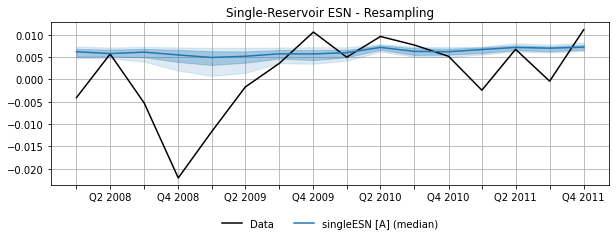

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A__forecasts_qts[1,:], esnSingle_A__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A__forecasts_qts[0,:], esnSingle_A__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnSingle_B__fits_qts, 
    esnSingle_B__forecasts_qts,
    esnSingle_B__fits_se_qts,
    esnSingle_B__forecasts_se_qts,
    _, _,
    esnSingle_B__Gamma0_eigs,
    esnSingle_B__lambdas,
    pars_esnSingle_B
) = SingleESN__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=esnSingle_B_agg_cv10_lambda_2007,
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [03:54<00:00,  2.35s/it]


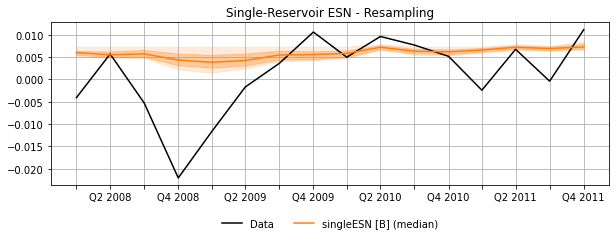

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B__forecasts_qts[1,:], esnSingle_B__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B__forecasts_qts[0,:], esnSingle_B__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: SingleESN_ew__resampleFitForecast()
def SingleESN_ew__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        forecast_ew = np.zeros((len(GDP_fill_data_test), 1))
        for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_fill_data_train_j = pd.concat([
                    GDP_fill_data_train, 
                    GDP_fill_data_test.iloc[0:j,]
                ])
                md_fill_data_train_j = pd.concat([
                    md_fill_data_train, 
                    md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
                md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
            else:
                GDP_fill_data_train_j = GDP_fill_data_train
                md_fill_data_train_j = md_fill_data_train
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
                md_fill_data_test_j = md_fill_data_test.iloc[[0],]

            # Normalize
            GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                    return_mu_sig=True)
            )
            md_fill_data_train_j, md_fill_data_test_j = (
                normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
            )

            if doCV:
                Lambda_j = esnSingle__current.ridge_lambda_cv(
                    Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
            else:
                Lambda_j = Lambda

            esnSingle_fit = esnSingle__current.fit(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnSingle_for = esnSingle__current.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
                fit=esnSingle_fit
            )

            forecast_ew[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_ew)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (forecasts_qts, forecasts_np, pars)

In [ ]:
(esnSingle_A_ew__forecasts_qts,
    _,
    pars_esnSingle_A
) = SingleESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [41:32<00:00, 24.93s/it]


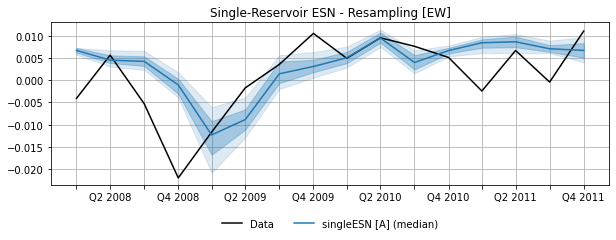

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A_ew__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_ew__forecasts_qts[1,:], esnSingle_A_ew__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_ew__forecasts_qts[0,:], esnSingle_A_ew__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnSingle_B_ew__forecasts_qts,
    _,
    pars_esnSingle_B
) = SingleESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [40:12<00:00, 24.13s/it]


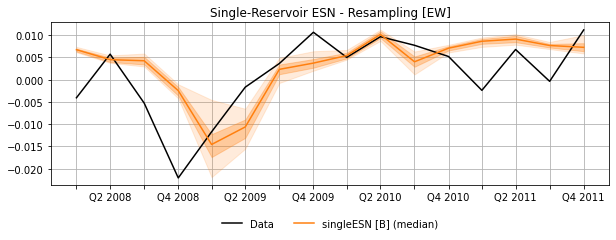

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B_ew__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_ew__forecasts_qts[1,:], esnSingle_B_ew__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_ew__forecasts_qts[0,:], esnSingle_B_ew__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: SingleESN_rw__resampleFitForecast()
def SingleESN_rw__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)
    GDP_test_dates = GDP_fill_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        forecast_rw = np.zeros((len(GDP_fill_data_test), 1))
        for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_fill_data_train_j = pd.concat([
                    GDP_fill_data_train,
                    GDP_fill_data_test.iloc[0:j,]
                ]).iloc[j:,]
                md_fill_data_train_j = pd.concat([
                    md_fill_data_train,
                    md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
                md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
            else:
                GDP_fill_data_train_j = GDP_fill_data_train
                md_fill_data_train_j = md_fill_data_train
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
                md_fill_data_test_j = md_fill_data_test.iloc[[0],]

            # Normalize
            GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                    return_mu_sig=True)
            )
            md_fill_data_train_j, md_fill_data_test_j = (
                normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
            )

            if doCV:
                Lambda_j = esnSingle__current.ridge_lambda_cv(
                    Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
            else:
                Lambda_j = Lambda

            esnSingle_fit = esnSingle__current.fit(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnSingle_for = esnSingle__current.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
                fit=esnSingle_fit
            )

            forecast_rw[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_rw)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (forecasts_qts, forecasts_np, pars)

In [ ]:
(esnSingle_A_rw__forecasts_qts,
    _,
    pars_esnSingle_A
) = SingleESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [36:07<00:00, 21.67s/it]


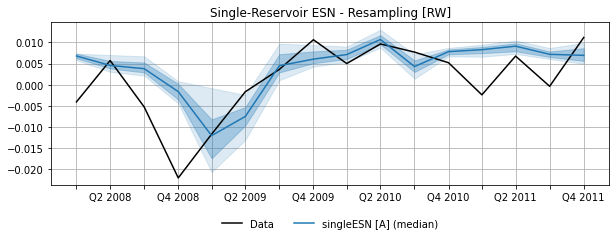

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A_rw__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_rw__forecasts_qts[1,:], esnSingle_A_rw__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_rw__forecasts_qts[0,:], esnSingle_A_rw__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnSingle_B_rw__forecasts_qts,
    _,
    pars_esnSingle_B
) = SingleESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [40:02<00:00, 24.02s/it]


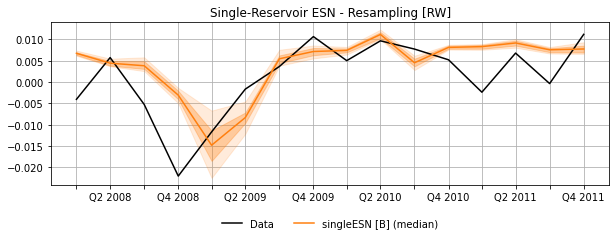

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B_rw__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_rw__forecasts_qts[1,:], esnSingle_B_rw__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_rw__forecasts_qts[0,:], esnSingle_B_rw__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: MultiESN__resampleFitForecast()
def MultiESN__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    fits      = []
    forecasts = []
    lambdas   = []
    state_eigs = []
    for n in tqdm(range(n_models)):

        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)  

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        if doCV:
            Lambda = esnMulti__current.ridge_lambda_cv(
                Y=GDP_data_train, z=(m_data_train, d_data_train), 
                method="ridge-isotropic",
                cv_options="-cv:10-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda = [Lambda[0], Lambda[0]]
        else:
            assert not Lambda is None

        esnMulti_fit = esnMulti__current.fit(
            Y=GDP_data_train, z=(m_data_train, d_data_train), 
            method='ridge',
            Lambda=Lambda,
            full=False,
            debug=False,
        )

        esnMulti_for = esnMulti__current.fixedParamsForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),  
            fit=esnMulti_fit
        )

        fits.append(esnMulti_fit['fit_for'][0]['Y_fit'])
        forecasts.append(
            esnMulti_for['Forecast'][0]['Y_for'] * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
        )

        lambdas.append(Lambda)

        fit_states = esnMulti_fit['fit_for'][0]['X']
        fit_Gamma0 = fit_states.T @ fit_states
        state_eigs.append(np.abs(np.linalg.eigvals(fit_Gamma0)))

    fits_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    fits_se_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    forecasts_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    forecasts_se_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    eigs_np = np.full((n_models, N_m+N_d), np.nan)
    for n in range(n_models):
        fits_np[n,:] = np.squeeze(fits[n])
        fits_se_np[n,:] = np.squeeze((fits[n] - GDP_data_train.to_numpy()[1:,])**2)
        forecasts_np[n,:] = np.squeeze(forecasts[n])
        forecasts_se_np[n,:] = np.squeeze((forecasts[n] - GDP_data_test.to_numpy())**2)
        #eigs_np[n,:] = np.squeeze(state_eigs[n])

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    #pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}
    pars = {}

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np, eigs_np, lambdas, pars)

In [ ]:
(esnMulti_A__fits_qts, 
    esnMulti_A__forecasts_qts,
    esnMulti_A__fits_se_qts,
    esnMulti_A__forecasts_se_qts,
    _, _,
    esnMulti_A__Gamma0_eigs,
    esnMulti_A__lambdas,
    pars_esnMulti_A
) = MultiESN__resampleFitForecast(
    n_models=10, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 10/10 [02:09<00:00, 12.92s/it]


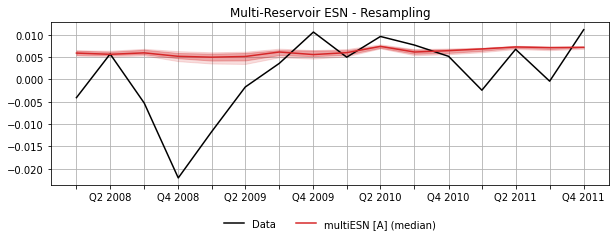

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A__forecasts_qts[1,:], esnMulti_A__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A__forecasts_qts[0,:], esnMulti_A__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnMulti_B__fits_qts, 
    esnMulti_B__forecasts_qts,
    esnMulti_B__fits_se_qts,
    esnMulti_B__forecasts_se_qts,
    _, _,
    esnMulti_B__Gamma0_eigs,
    esnMulti_B__lambdas,
    pars_esnMulti_B
) = MultiESN__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [13:49<00:00,  8.29s/it]


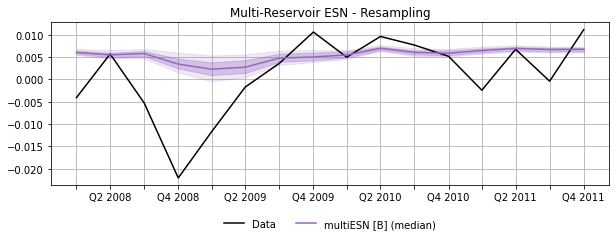

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B__forecasts_qts[1,:], esnMulti_B__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B__forecasts_qts[0,:], esnMulti_B__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: MultiESN_ew__resampleFitForecast()
def MultiESN_ew__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        if doCV:  Lambdas = []

        forecast_ew = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ])
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
                d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.iloc[[0],]
                d_data_test_j = d_data_test.iloc[[0],]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            if doCV:
                Lambda_j = esnMulti__current.ridge_lambda_cv(
                    Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
                Lambda_j = [Lambda_j[0], Lambda_j[0]]
                Lambdas.append(Lambda_j)
            else:
                Lambda_j = Lambda

            esnMulti_fit = esnMulti__current.fit(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnMulti_for = esnMulti__current.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
                fit=esnMulti_fit
            )

            forecast_ew[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_ew)

        #if doCV:
        #    plt.figure(figsize=(8,2))
        #    for l in range(len(Lambda_j)):
        #        plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        #    plt.ylabel("$\log_{10}(\lambda_t)$")
        #    plt.grid()
        #    plt.show()

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {}

    return (forecasts_qts, forecasts_np, pars)

In [ ]:
(esnMulti_A_ew__forecasts_qts, 
    _,
    pars_esnMulti_A
) = MultiESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    #Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:41:14<00:00, 60.75s/it]


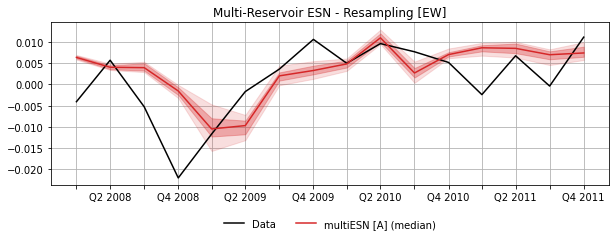

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A_ew__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_ew__forecasts_qts[1,:], esnMulti_A_ew__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_ew__forecasts_qts[0,:], esnMulti_A_ew__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnMulti_B_ew__forecasts_qts, 
    _,
    pars_esnMulti_B
) = MultiESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    #Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:41:39<00:00, 61.00s/it]


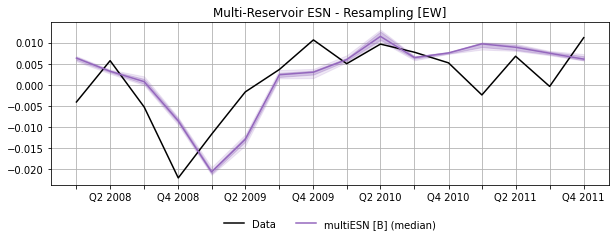

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B_ew__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_ew__forecasts_qts[1,:], esnMulti_B_ew__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_ew__forecasts_qts[0,:], esnMulti_B_ew__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: MultiESN_rw__resampleFitForecast()
def MultiESN_rw__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        forecast_rw = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ]).iloc[j:,]
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
                d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
                d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.iloc[[0],]
                d_data_test_j = d_data_test.iloc[[0],]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            if doCV:
                Lambda_j = esnMulti__current.ridge_lambda_cv(
                    Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
                Lambda_j = [Lambda_j[0], Lambda_j[0]]
            else:
                Lambda_j = Lambda

            esnMulti_fit = esnMulti__current.fit(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnMulti_for = esnMulti__current.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
                fit=esnMulti_fit
            )

            forecast_rw[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_rw)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {}

    return (forecasts_qts, forecasts_np, pars)

In [ ]:
(esnMulti_A_rw__forecasts_qts, 
    _,
    pars_esnMulti_A
) = MultiESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    #Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:32:10<00:00, 55.30s/it]


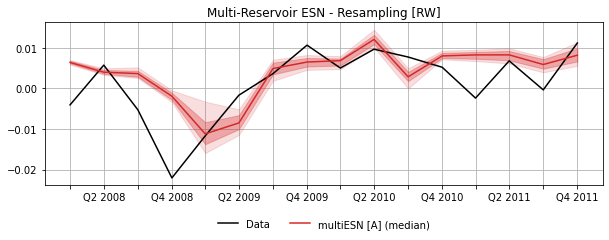

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A_rw__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_rw__forecasts_qts[1,:], esnMulti_A_rw__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_rw__forecasts_qts[0,:], esnMulti_A_rw__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
(esnMulti_B_rw__forecasts_qts, 
    _,
    pars_esnMulti_B
) = MultiESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    #Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:33:25<00:00, 56.06s/it]


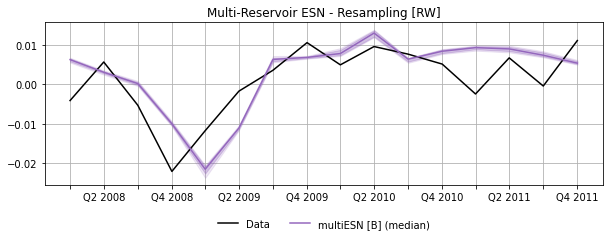

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B_rw__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_rw__forecasts_qts[1,:], esnMulti_B_rw__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_rw__forecasts_qts[0,:], esnMulti_B_rw__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

#### MIDAS

In [ ]:
from scipy.stats import qmc
from sklearn.manifold import TSNE
from matplotlib import colors

In [ ]:
# DEF: MIDAS__resampleLossFeatures()
def MIDAS__resampleLossFeatures(log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    # Build MIDAS design matrices
    MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )

    sobol_theta0_rs = []
    fits_theta_rs = []
    fits_lossval_rs = []
    fits_lossgradnorm_rs = []
    for _ in tqdm(range(restart)):        
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        fits_theta_i = []
        fits_lossval_i = []
        fits_lossgradnorm_i = []
        L = len(sobol_theta0)
        for n in range(L):
            MIDAS_fixParsForecast = MIDAS_model.fixedparamsForecast(
                data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
                fit_length=len(dataset2007['GDP_data_train']),
                steps=1,
                normalize=False,
                grad=True, 
                method='L-BFGS-B',
                theta0 = sobol_theta0[n],
            )

            MIDAS_thetaOpt = MIDAS_fixParsForecast['parsfit_for'][0]['theta_opt']

            if np.all(~np.isnan(MIDAS_thetaOpt)):
                MIDAS_lossValue = MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                MIDAS_lossGradNorm = np.linalg.norm(
                    MIDAS_model.fitAlmon_RSS_grad(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                )

                fits_theta_i.append(MIDAS_thetaOpt)
                fits_lossval_i.append(MIDAS_lossValue)
                fits_lossgradnorm_i.append(MIDAS_lossGradNorm)

        if restart < 2:
            sobol_theta0_rs = sobol_theta0
            fits_theta_rs = fits_theta_i
            fits_lossval_rs = fits_lossval_i
            fits_lossgradnorm_rs = fits_lossgradnorm_i
        else:
            idx_min = np.argmin(np.array(fits_lossval_i))

            sobol_theta0_rs.append(sobol_theta0[idx_min])
            fits_theta_rs.append(fits_theta_i[idx_min])
            fits_lossval_rs.append(fits_lossval_i[idx_min])
            fits_lossgradnorm_rs.append(fits_lossgradnorm_i[idx_min])


    return (fits_theta_rs, fits_lossval_rs, fits_lossgradnorm_rs, sobol_theta0_rs)

In [ ]:
(MIDAS__fits_theta_opt, 
    MIDAS__fits_lossval_opt,
    MIDAS__fits_lossgradnorm_opt,
    MIDAS__sobol_theta0,
) = MIDAS__resampleLossFeatures(log_sobol=6, restart=100)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
  1%|          | 1/100 [00:08<14:45,  8.94s/it]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\U

In [ ]:
# TSNE
fits_theta_embedded = TSNE(
    n_components=2, 
    learning_rate='auto', 
    init='pca'
).fit_transform(np.vstack((
    np.array(MIDAS__sobol_theta0),
    np.array(MIDAS__fits_theta_opt)
)))


c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


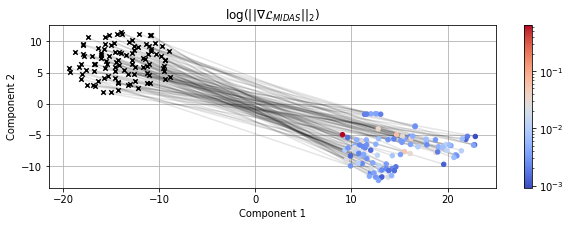

In [ ]:
# Plot
fig = plt.figure(figsize=(10, 3))
#ax = fig.add_subplot(projection='3d')
#ax.scatter(
#    fits_theta_embedded[:,0], 
#    fits_theta_embedded[:,1], 
#    fits_theta_embedded[:,2], 
#    c=(MIDAS__fits_lossgradnorm_opt),
#    cmap='jet', norm=colors.LogNorm()
#)
# Lines
for i in range(len(MIDAS__sobol_theta0)):
    plt.plot(
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],0],
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],1],
        c='black',
        alpha=0.1,
    )
# Sobol starting points
plt.scatter(
    fits_theta_embedded[:len(MIDAS__sobol_theta0),0], 
    fits_theta_embedded[:len(MIDAS__sobol_theta0),1], 
    marker='x',
    c='black',
    zorder=2.5,
    s=20
)
# Optimization results
plt.scatter(
    fits_theta_embedded[len(MIDAS__sobol_theta0):,0], 
    fits_theta_embedded[len(MIDAS__sobol_theta0):,1], 
    c=(MIDAS__fits_lossgradnorm_opt),
    cmap='coolwarm', norm=colors.LogNorm(),
    zorder=2.5,
    s=20,
)
plt.colorbar()
plt.title(r"$\log(||\nabla\mathcal{L}_{MIDAS}||_2)$")
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.grid()
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_thetas_gradnorm_2007.png'), 
                    dpi=200, bbox_inches="tight")
plt.show()

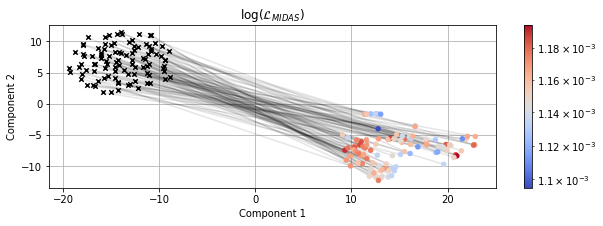

In [ ]:
# Plot
fig = plt.figure(figsize=(10, 3))
#ax = fig.add_subplot(projection='3d')
#ax.scatter(
#    fits_theta_embedded[:,0], 
#    fits_theta_embedded[:,1], 
#    fits_theta_embedded[:,2], 
#    c=(MIDAS__fits_lossgradnorm_opt),
#    cmap='jet', norm=colors.LogNorm()
#)
# Lines
for i in range(len(MIDAS__sobol_theta0)):
    plt.plot(
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],0],
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],1],
        c='black',
        alpha=0.1,
    )
# Sobol starting points
plt.scatter(
    fits_theta_embedded[:len(MIDAS__sobol_theta0),0], 
    fits_theta_embedded[:len(MIDAS__sobol_theta0),1], 
    marker='x',
    c='black',
    zorder=2.5,
    s=20
)
# Optimization results
plt.scatter(
    fits_theta_embedded[len(MIDAS__sobol_theta0):,0], 
    fits_theta_embedded[len(MIDAS__sobol_theta0):,1], 
    c=(MIDAS__fits_lossval_opt),
    cmap='coolwarm', norm=colors.LogNorm(),
    zorder=2.5,
    s=20,
)
plt.colorbar()
plt.title(r'$\log(\mathcal{L}_{MIDAS})$')
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.grid()
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_thetas_lossval_2007.png'), 
                    dpi=200, bbox_inches="tight")
plt.show()

In [ ]:
from plot_loss_surf import plot_loss_surf

MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )
def MIDAS_model__loss(z):
  return MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, z, i=0)

def MIDAS_model__grad(z):
  return MIDAS_model.fitAlmon_RSS_grad(MIDAS_RSSMats, z, i=0)

Evaluating loss...: 100%|██████████| 70/70 [00:07<00:00,  9.30it/s]


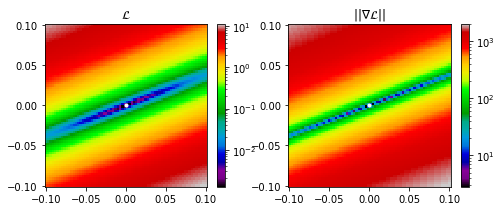

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.22it/s]


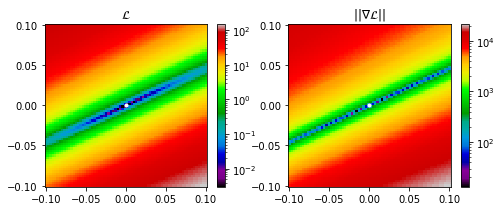

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.88it/s]


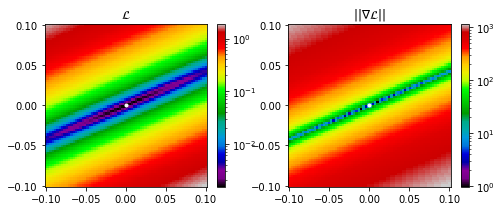

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 11.16it/s]


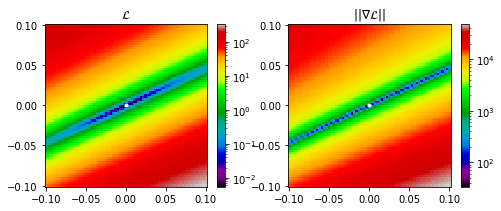

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.93it/s]


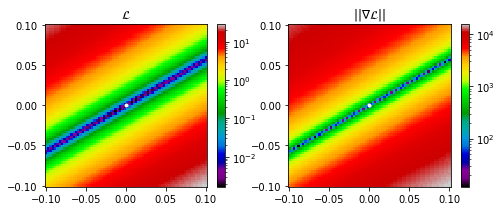

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.93it/s]


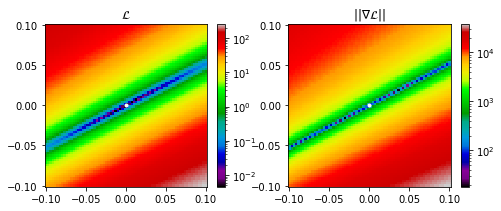

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.84it/s]


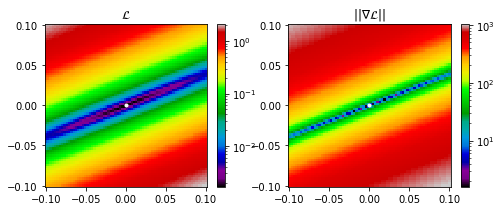

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 11.11it/s]


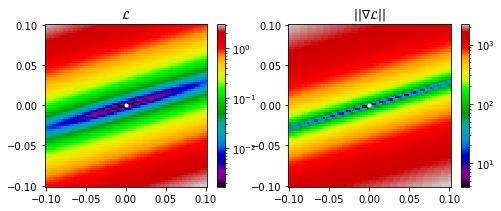

In [ ]:
for i in range(8):
    plot_loss_surf(
      loss_fn = MIDAS_model__loss, 
      grad_fn = MIDAS_model__grad,
      param = MIDAS__fits_theta_opt[i],
      M = 70,
      scale = 0.1,
      seed=20220618,
      figsize=(8,3)
    )

In [ ]:
# DEF: MIDAS__resampleFitForecast()
def MIDAS__resampleFitForecast(log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    # Build MIDAS design matrices
    MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )

    fits_lossval = []
    fits = []
    fits_res = []
    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        fits_lossval_i = []
        fits_i = []
        fits_res_i = []
        forecasts_i = []
        L = len(sobol_theta0)
        for n in range(L):
            MIDAS_fixParsForecast = MIDAS_model.fixedparamsForecast(
                data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
                fit_length=len(dataset2007['GDP_data_train']),
                steps=1,
                normalize=False,
                grad=True, 
                method='L-BFGS-B',
                theta0 = sobol_theta0[n],
            )

            MIDAS__for_fit_out = MIDAS_model.forecast_reshape(MIDAS_fixParsForecast)
            MIDAS_thetaOpt = MIDAS_fixParsForecast['parsfit_for'][0]['theta_opt']       

            if np.all(~np.isnan(MIDAS_fixParsForecast['parsfit_for'][0]['Yt_fit'])):
                MIDAS_lossValue = MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)

                fits_lossval_i.append(MIDAS_lossValue)
                fits_i.append(MIDAS_fixParsForecast['parsfit_for'][0]['Yt_fit'])
                fits_res_i.append(MIDAS_fixParsForecast['parsfit_for'][0]['Residuals'])
                forecasts_i.append(MIDAS__for_fit_out['Yt_forecast'])

        if restart < 2:
            fits_lossval = fits_lossval_i
            fits = fits_i
            fits_res = fits_res_i
            forecasts = forecasts_i
        else:
            idx_min = np.argmin(np.array(fits_lossval_i))

            fits_lossval.append(fits_lossval_i[idx_min])
            fits.append(fits_i[idx_min])
            fits_res.append(fits_res_i[idx_min])
            forecasts.append(forecasts_i[idx_min])

    B = len(fits)

    fits_np = np.full((B, len(fits[0])), np.nan)
    fits_se_np = np.full((B, len(fits[0])), np.nan)
    forecasts_np = np.full((B, len(forecasts[0])), np.nan)
    forecasts_se_np = np.full((B, len(forecasts[0])), np.nan)
    for b in range(B):
        fits_np[b,:] = np.squeeze(fits[b])
        fits_se_np[b,:] = np.squeeze(fits_res[b]**2)
        forecasts_np[b,:] = np.squeeze(forecasts[b])
        forecasts_se_np[b,:] = np.squeeze((forecasts[b] - dataset2007['GDP_data_test'].to_numpy())**2)

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np)

In [ ]:
(MIDAS__fits_qts, 
    MIDAS__forecasts_qts,
    MIDAS__fits_se_qts,
    MIDAS__forecasts_se_qts,
    MIDAS__fits, _,
) = MIDAS__resampleFitForecast(
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
  1%|          | 1/100 [00:07<12:25,  7.53s/it]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\U

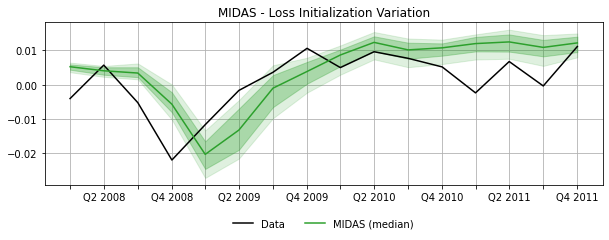

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS__forecasts_qts[2,0:16], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS__forecasts_qts[1,0:16], MIDAS__forecasts_qts[3,0:16],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS__forecasts_qts[0,0:16], MIDAS__forecasts_qts[4,0:16],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: MIDAS_ew__resampleFitForecast()
def MIDAS_ew__resampleFitForecast(midasModel, data, log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        forecast_ew = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ])
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
                d_data_test_j = d_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
                d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            # MIDAS data format
            GDP_data_midas_j = np.vstack((
                GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
            ))
            md_data_midas_j = (
                tuple(
                    np.vstack((
                        m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                    )) for s in m_data_train.columns
                ) +
                (np.vstack((
                    d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
                )), )
            )

            # Build MIDAS design matrices
            MIDAS_RSSMats = midasModel.fitAlmon_getRSS_mats(
                Y=GDP_data_midas_j, 
                X=md_data_midas_j, 
                fit_length=len(GDP_data_train_j),
                steps=1,
            )

            fits_lossval_j = []
            forecasts_j = []
            for n in range(len(sobol_theta0)):
                MIDAS_fit = midasModel.fixedparamsForecast(
                    data=(GDP_data_midas_j, md_data_midas_j),
                    fit_length=len(GDP_data_train_j),
                    steps=1,
                    normalize=False,
                    grad=True, 
                    method='L-BFGS-B',
                    theta0 = sobol_theta0[n],
                )

                #MIDAS__for_fit_out = midasModel.forecast_reshape(MIDAS_fit)
                MIDAS_thetaOpt = MIDAS_fit['parsfit_for'][0]['theta_opt']       

                if np.all(~np.isnan(MIDAS_fit['parsfit_for'][0]['Yt_fit'])):
                    MIDAS_lossValue = midasModel.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                    fits_lossval_j.append(MIDAS_lossValue)
                    forecasts_j.append(np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j)

            # Best fit
            idx_min = np.argmin(np.array(fits_lossval_j))
            forecast_ew[j] = forecasts_j[idx_min]

        forecasts.append(forecast_ew)

    forecasts_np = np.full((restart, len(forecasts[0])), np.nan)
    for n in range(restart):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (forecasts_qts, forecasts_np)

In [ ]:
(MIDAS_ew__forecasts_qts,
    _,
) = MIDAS_ew__resampleFitForecast(
    MIDAS_model, 
    data=dataset2007_short,
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Comput

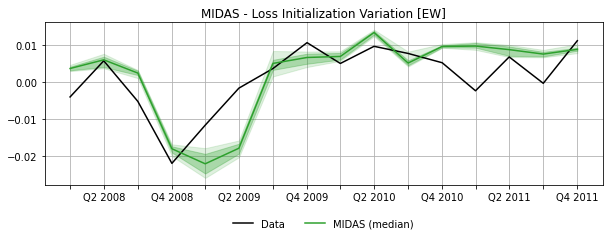

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS_ew__forecasts_qts[2,:], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_ew__forecasts_qts[1,:], MIDAS_ew__forecasts_qts[3,:],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_ew__forecasts_qts[0,:], MIDAS_ew__forecasts_qts[4,:],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [ ]:
# DEF: MIDAS_rw__resampleFitForecast()
def MIDAS_rw__resampleFitForecast(midasModel, data, log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        forecast_rw = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ]).iloc[j:,]
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
                d_data_test_j = d_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
                d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            # MIDAS data format
            GDP_data_midas_j = np.vstack((
                GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
            ))
            md_data_midas_j = (
                tuple(
                    np.vstack((
                        m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                    )) for s in m_data_train.columns
                ) +
                (np.vstack((
                    d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
                )), )
            )

            # Build MIDAS design matrices
            MIDAS_RSSMats = midasModel.fitAlmon_getRSS_mats(
                Y=GDP_data_midas_j, 
                X=md_data_midas_j, 
                fit_length=len(GDP_data_train_j),
                steps=1,
            )

            fits_lossval_j = []
            forecasts_j = []
            for n in range(len(sobol_theta0)):
                MIDAS_fit = midasModel.fixedparamsForecast(
                    data=(GDP_data_midas_j, md_data_midas_j),
                    fit_length=len(GDP_data_train_j),
                    steps=1,
                    normalize=False,
                    grad=True, 
                    method='L-BFGS-B',
                    theta0 = sobol_theta0[n],
                )

                #MIDAS__for_fit_out = midasModel.forecast_reshape(MIDAS_fit)
                MIDAS_thetaOpt = MIDAS_fit['parsfit_for'][0]['theta_opt']       

                if np.all(~np.isnan(MIDAS_fit['parsfit_for'][0]['Yt_fit'])):
                    MIDAS_lossValue = midasModel.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                    fits_lossval_j.append(MIDAS_lossValue)
                    forecasts_j.append(np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j)

            # Best fit
            idx_min = np.argmin(np.array(fits_lossval_j))
            forecast_rw[j] = forecasts_j[idx_min]

        forecasts.append(forecast_rw)

    forecasts_np = np.full((restart, len(forecasts[0])), np.nan)
    for n in range(restart):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (forecasts_qts, forecasts_np)

In [ ]:
(MIDAS_rw__forecasts_qts,
    _,
) = MIDAS_rw__resampleFitForecast(
    MIDAS_model, 
    data=dataset2007_short,
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Comput

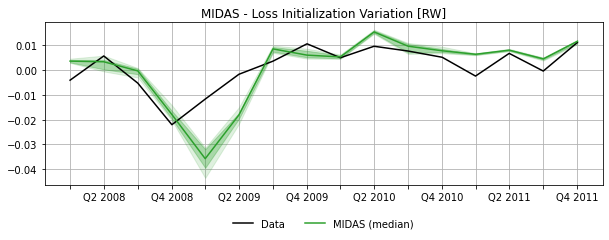

In [ ]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS_rw__forecasts_qts[2,:], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_rw__forecasts_qts[1,:], MIDAS_rw__forecasts_qts[3,:],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_rw__forecasts_qts[0,:], MIDAS_rw__forecasts_qts[4,:],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()